In [2]:
pip install plotnine

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 3.0 MB/s eta 0:00:00a 0:00:010m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.4/114.4 kB 2.9 MB/s eta 0:00:00:00:01
Note: you may need to restart the kernel to use updated packages.


In [38]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
from sklearn.datasets import make_blobs
from plotnine import *   
# StandardScaler is a function to normalize the data 
# You may also check MinMaxScaler and MaxAbsScaler 
#from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import AgglomerativeClustering

from sklearn.cluster import DBSCAN

from sklearn.preprocessing import StandardScaler

from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.datasets import load_iris
from sklearn.metrics import silhouette_score

%matplotlib inline

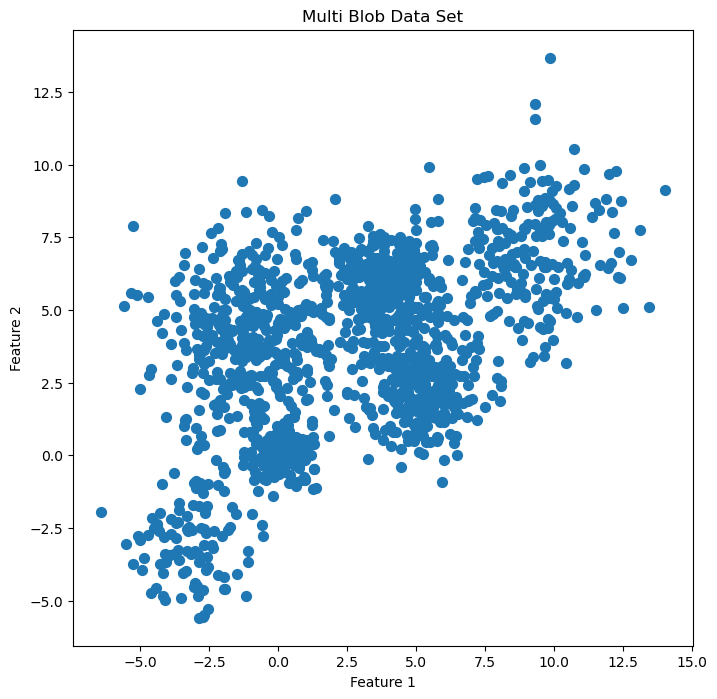

In [46]:
# Function to display clusters
def display_cluster(data):
    plt.scatter(data[:, 0], data[:, 1], s=50)
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.title('Multi Blob Data Set')
    plt.show()

# Generating Multi Blob Data Set
n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)


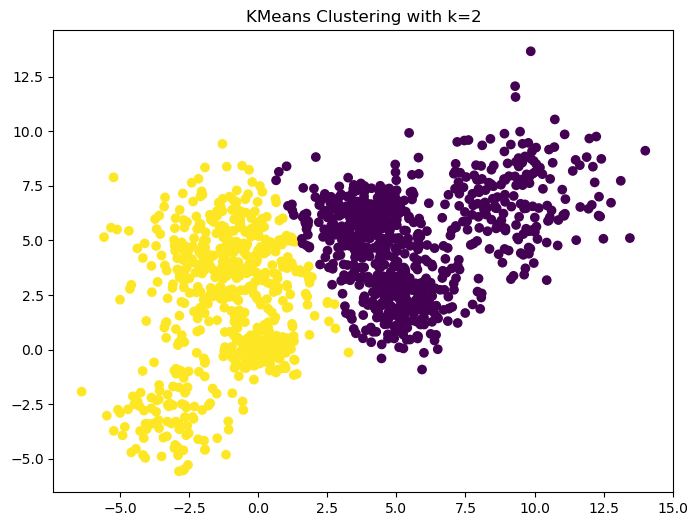

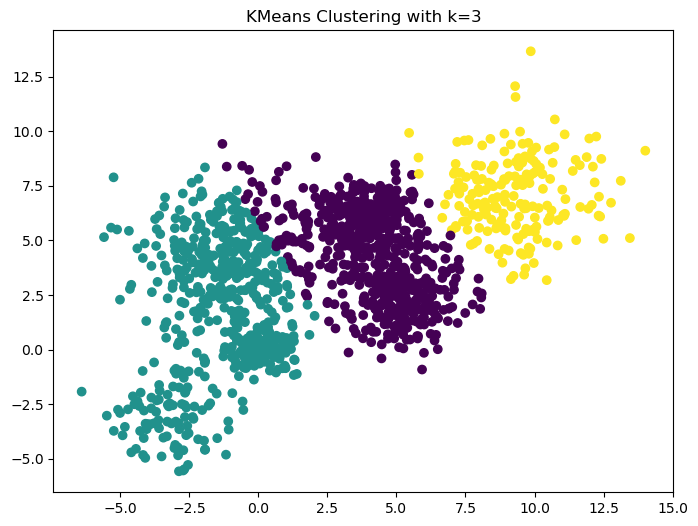

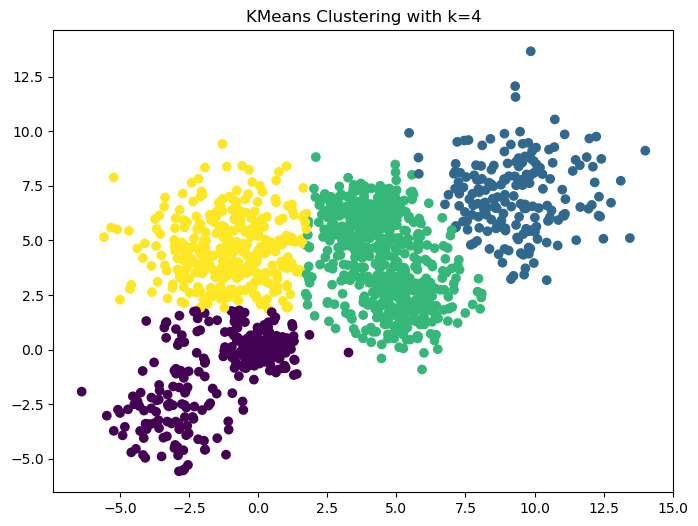

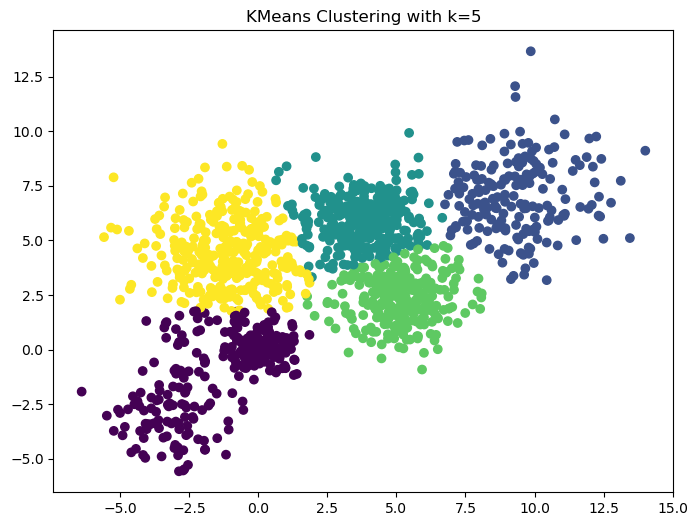

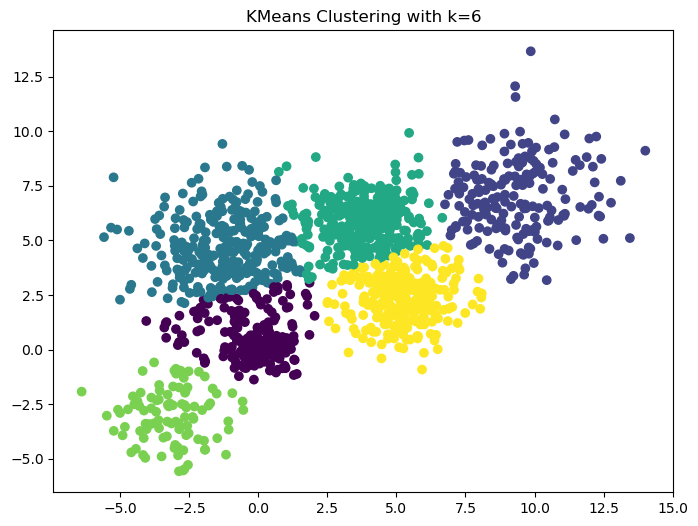

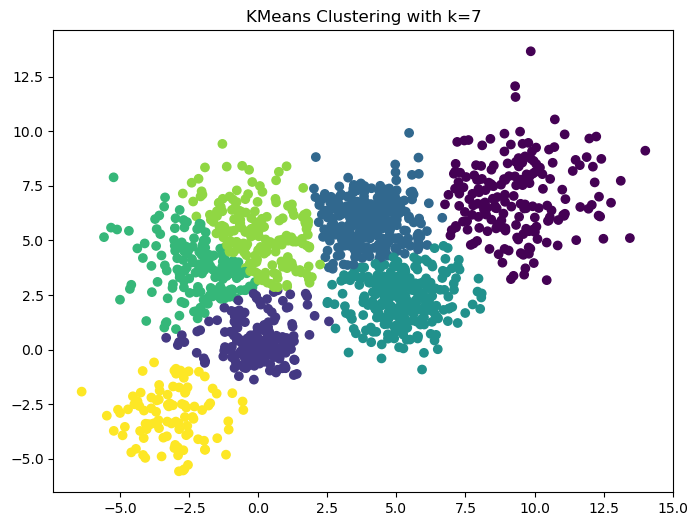

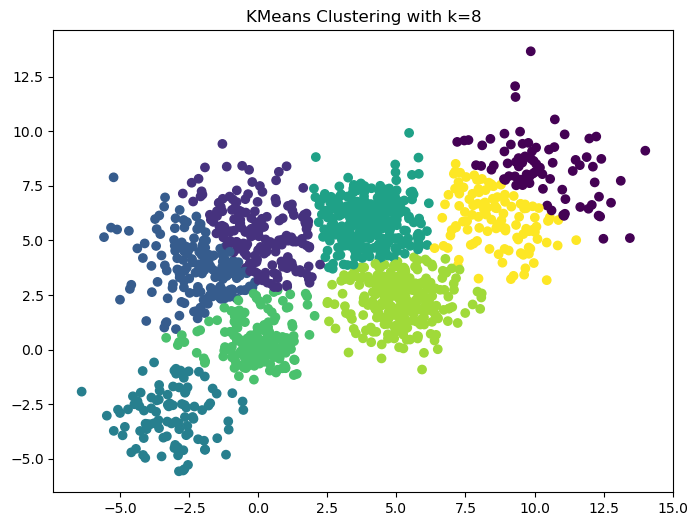

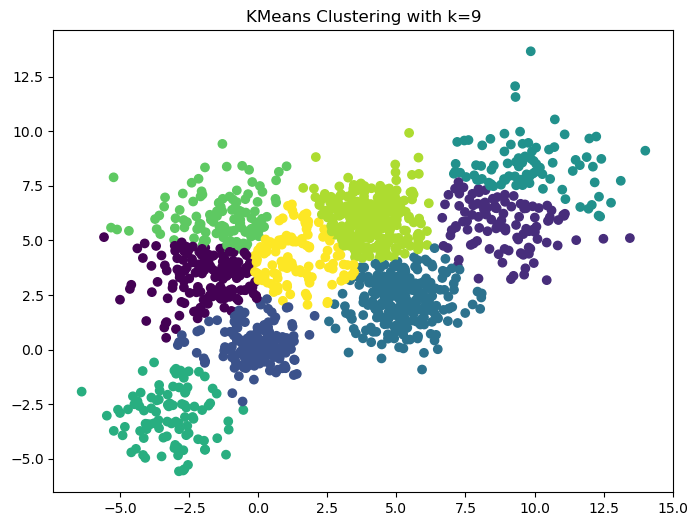

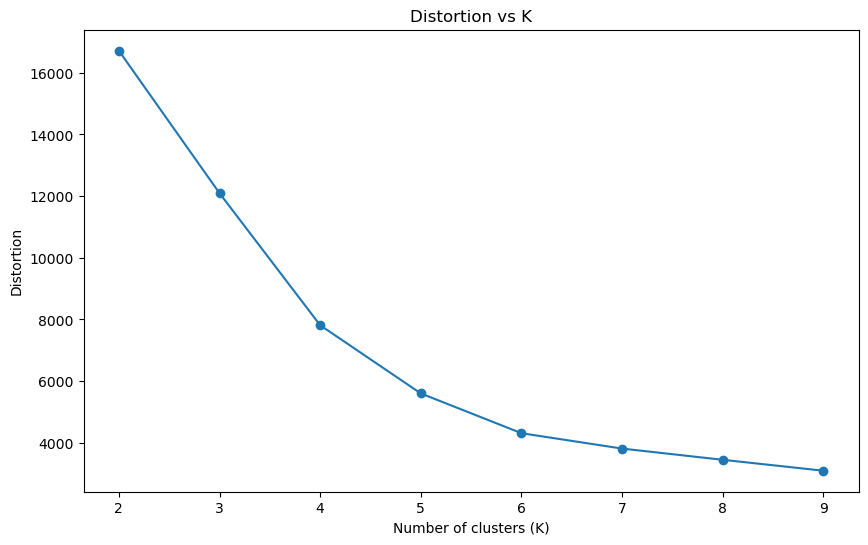

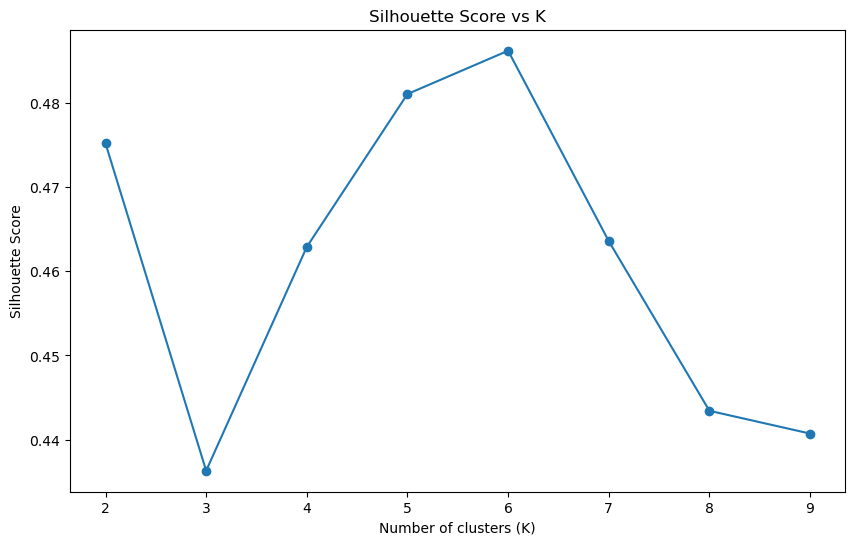

Best K for KMeans: 6, Silhouette Score: 0.48614459735646176


In [47]:

# KMeans clustering
def kmeans_clustering(data, k_values):
    distortions = []
    silhouette_scores = []
    for k in k_values:
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        distortions.append(kmeans.inertia_)  # inertia_ gives the sum of squared distances of samples to their closest cluster center
        silhouette_scores.append(silhouette_score(data, kmeans.labels_))
        # Visualize clustering result
        plt.figure(figsize=(8, 6))
        plt.scatter(data[:, 0], data[:, 1], c=kmeans.labels_, cmap='viridis')
        plt.title(f'KMeans Clustering with k={k}')
        plt.show()

    # Plot distortion function vs K
    plt.figure(figsize=(10, 6))
    plt.plot(k_values, distortions, marker='o')
    plt.xlabel('Number of clusters (K)')
    plt.ylabel('Distortion')
    plt.title('Distortion vs K')
    plt.show()

    # Plot silhouette score vs K
    plt.figure(figsize=(10, 6))
    plt.plot(k_values, silhouette_scores, marker='o')
    plt.xlabel('Number of clusters (K)')
    plt.ylabel('Silhouette Score')
    plt.title('Silhouette Score vs K')
    plt.show()

    best_k = k_values[np.argmax(silhouette_scores)]
    best_silhouette_score = np.max(silhouette_scores)
    return best_k, best_silhouette_score

k_values = range(2, 10)
best_k, best_silhouette_score = kmeans_clustering(Multi_blob_Data, k_values)
print(f'Best K for KMeans: {best_k}, Silhouette Score: {best_silhouette_score}')



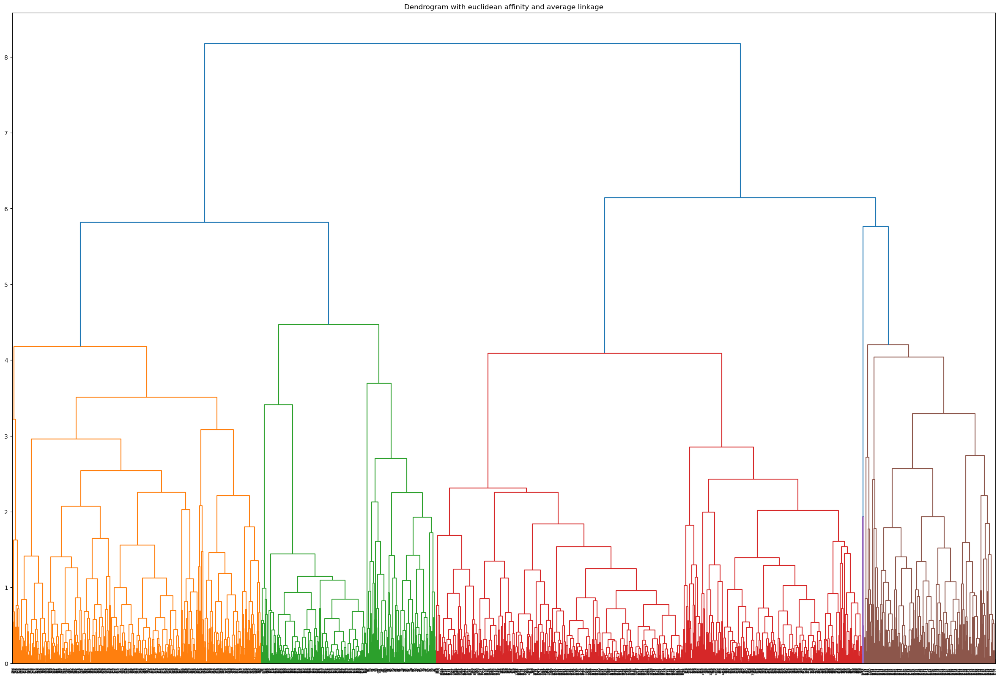

Silhouette Score with euclidean affinity and average linkage: 0.4716908069861964


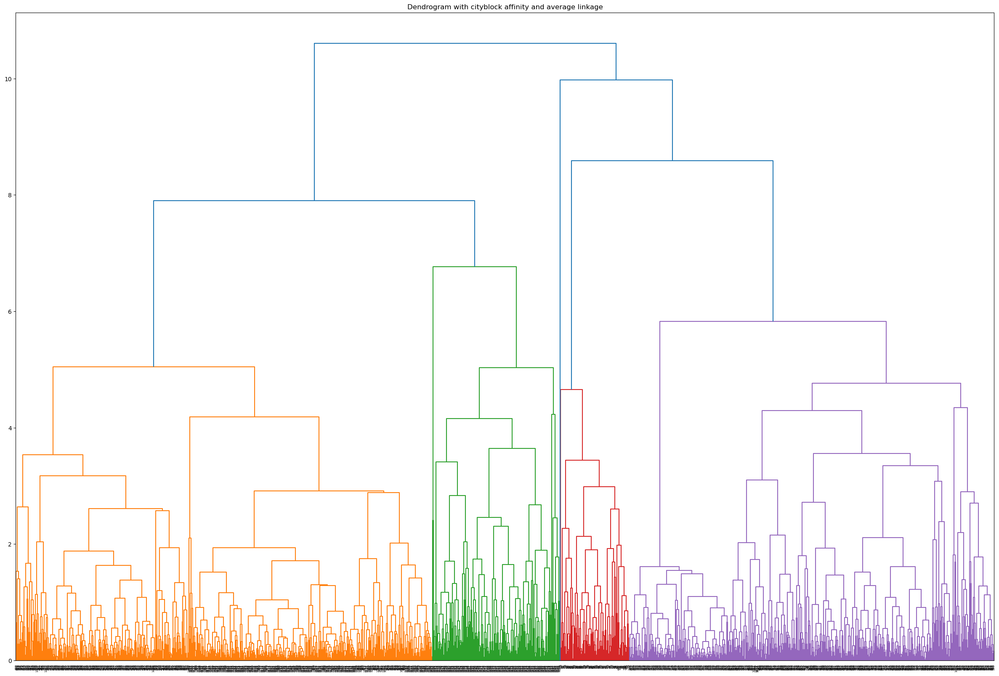

Silhouette Score with cityblock affinity and average linkage: 0.46762361386512785


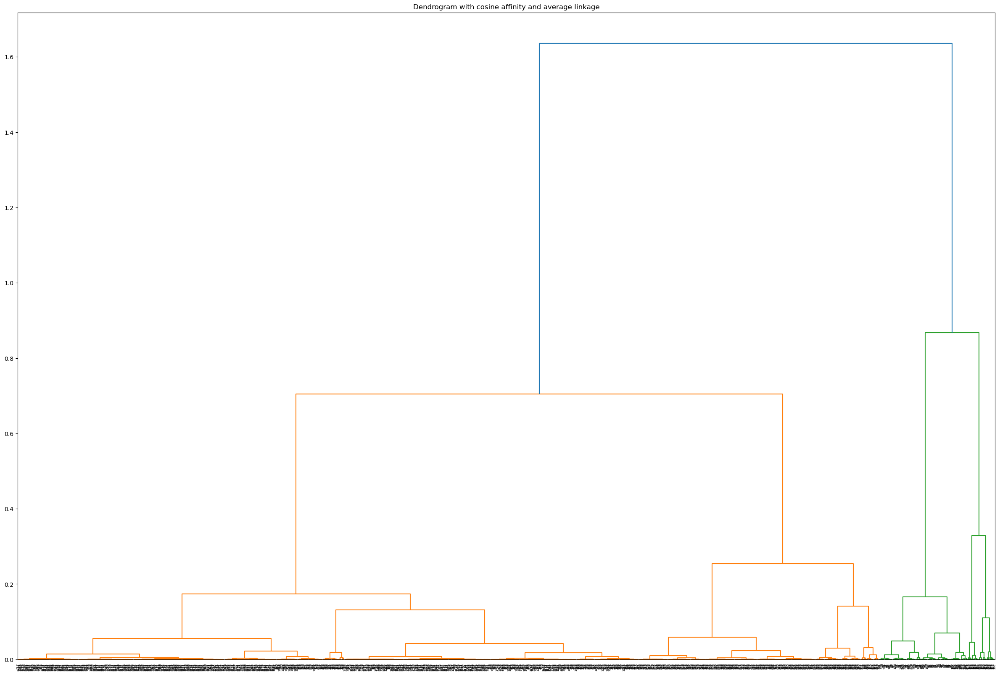

Silhouette Score with cosine affinity and average linkage: 0.35251834131557364


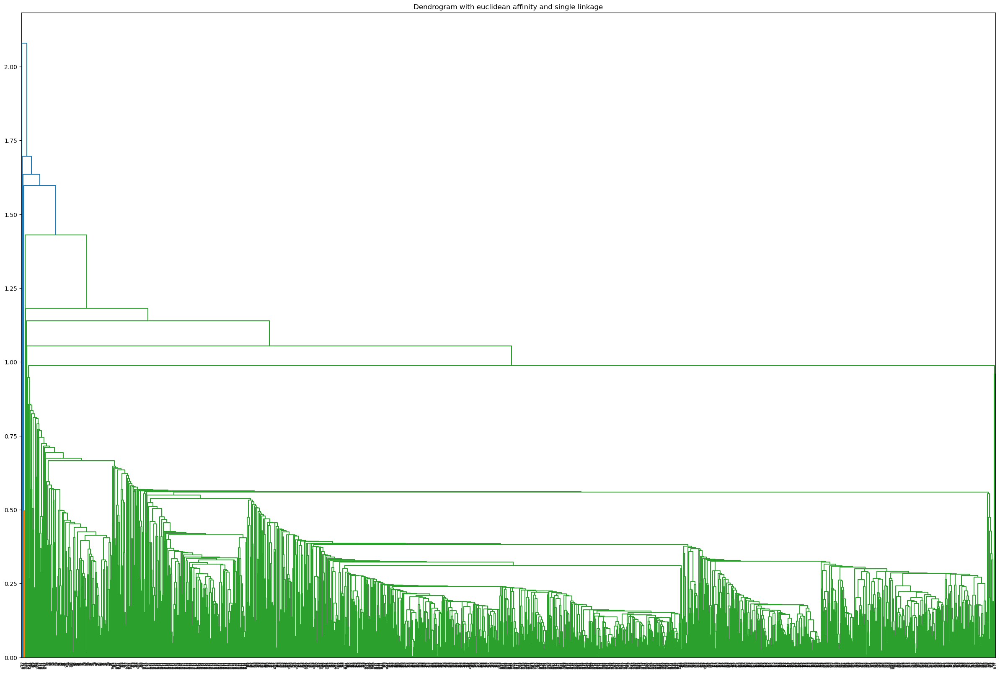

Silhouette Score with euclidean affinity and single linkage: 0.3218066204847175


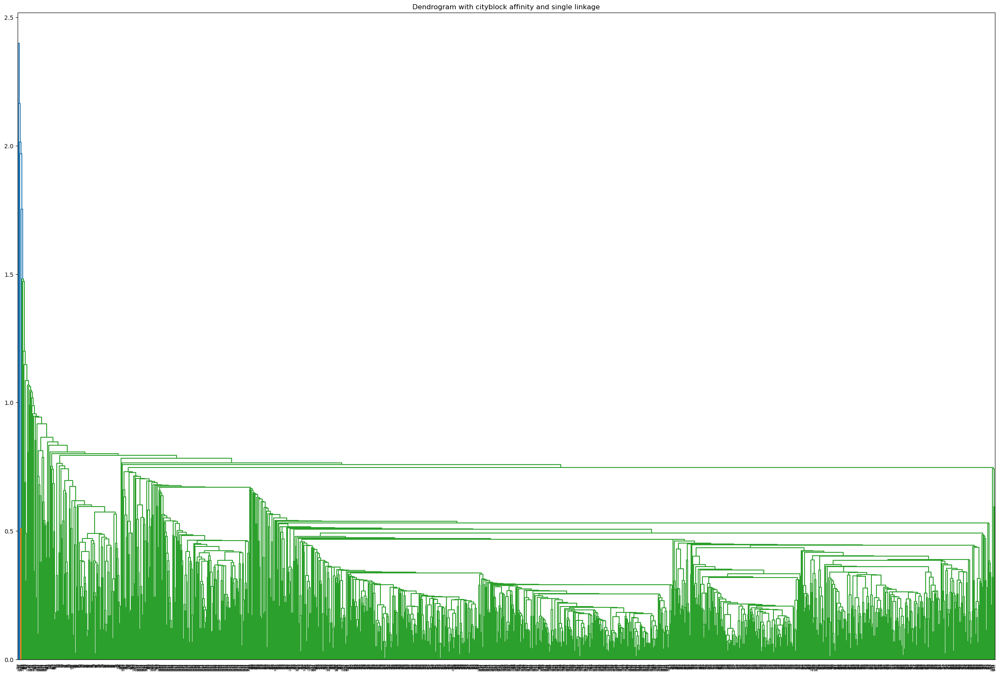

Silhouette Score with cityblock affinity and single linkage: 0.3218066204847175


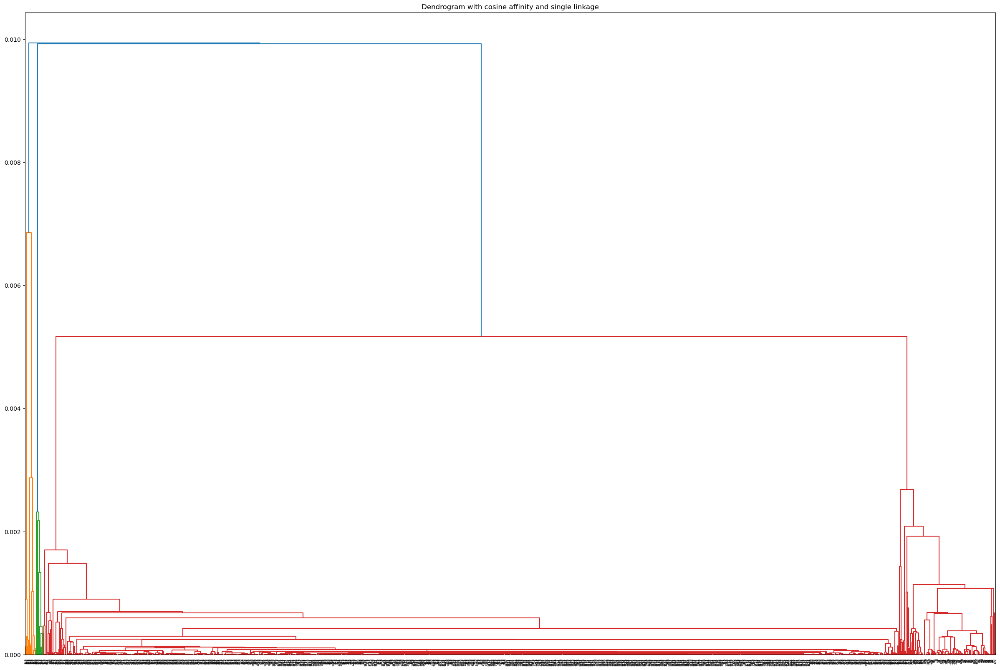

Silhouette Score with cosine affinity and single linkage: -0.016763591291336317
Best Parameters: {'affinity': 'euclidean', 'linkage': 'average'}
Best Silhouette Score: 0.4716908069861964


In [52]:
# Hierarchical Clustering
def perform_hierarchical_clustering(data):
    # Try different parameters
    parameters = [
        {'affinity': 'euclidean', 'linkage': 'average'},
        {'affinity': 'manhattan', 'linkage': 'average'},  # Change to 'cityblock' instead of 'manhattan'
        {'affinity': 'cosine', 'linkage': 'average'},
        {'affinity': 'euclidean', 'linkage': 'single'},
        {'affinity': 'manhattan', 'linkage': 'single'},   # Change to 'cityblock' instead of 'manhattan'
        {'affinity': 'cosine', 'linkage': 'single'}
    ]
    best_silhouette_score = -1
    best_params = None

    for param in parameters:
        model = AgglomerativeClustering(affinity=param['affinity'], linkage=param['linkage'])
        labels = model.fit_predict(data)
        silhouette_score_value = silhouette_score(data, labels)
        if silhouette_score_value > best_silhouette_score:
            best_silhouette_score = silhouette_score_value
            best_params = param

        # Compute linkage matrix
        if param['affinity'] == 'manhattan':
            param['affinity'] = 'cityblock'  # 'cityblock' is equivalent to Manhattan distance
        Z = linkage(data, method=param['linkage'], metric=param['affinity'])

        # Plot dendrogram
        plt.figure(figsize=(30, 20))
        dendrogram(Z)
        plt.title(f"Dendrogram with {param['affinity']} affinity and {param['linkage']} linkage")
        plt.show()

        print(f"Silhouette Score with {param['affinity']} affinity and {param['linkage']} linkage: {silhouette_score_value}")

    return best_params, best_silhouette_score


best_params, best_silhouette_score = perform_hierarchical_clustering(Multi_blob_Data)

print("Best Parameters:", best_params)
print("Best Silhouette Score:", best_silhouette_score)


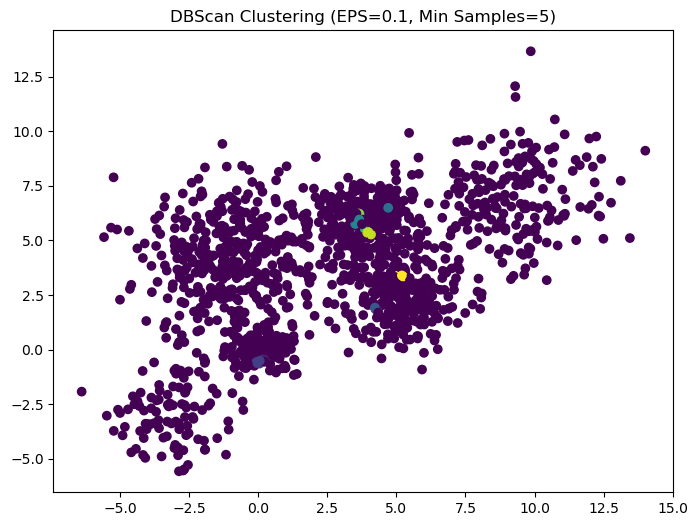

EPS: 0.1, Min Samples: 5, Silhouette Score: -0.5423348432605972


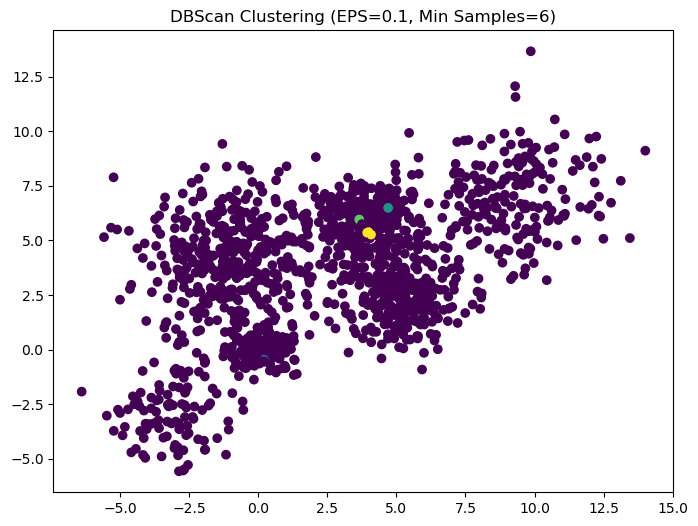

EPS: 0.1, Min Samples: 6, Silhouette Score: -0.5008065260955386


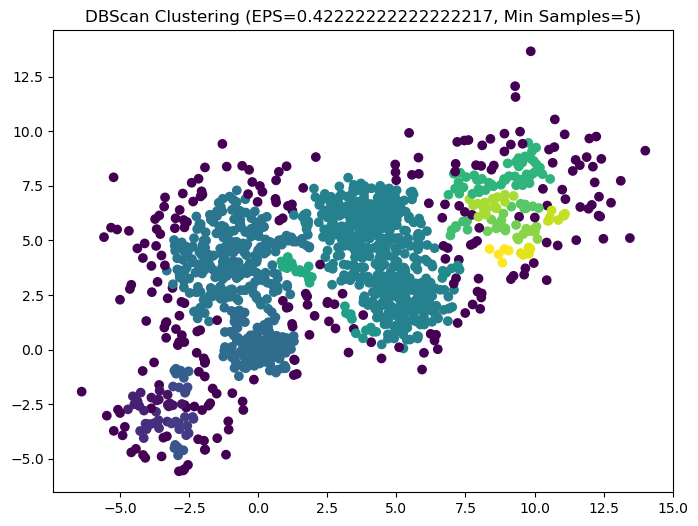

EPS: 0.42222222222222217, Min Samples: 5, Silhouette Score: -0.020838863395358127


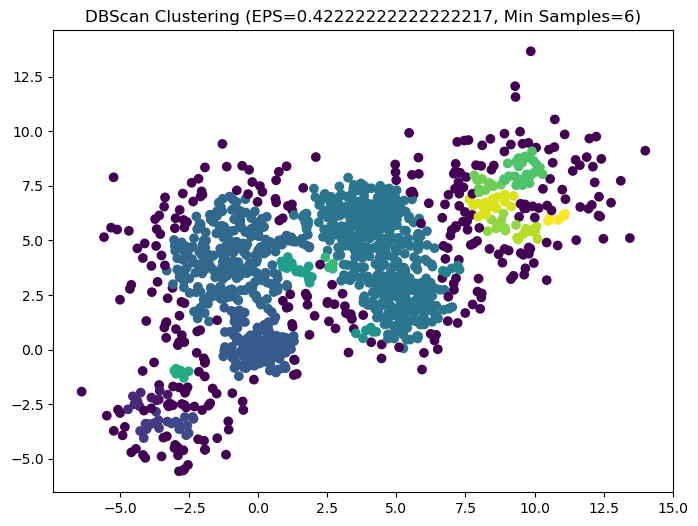

EPS: 0.42222222222222217, Min Samples: 6, Silhouette Score: -0.08429634339372068


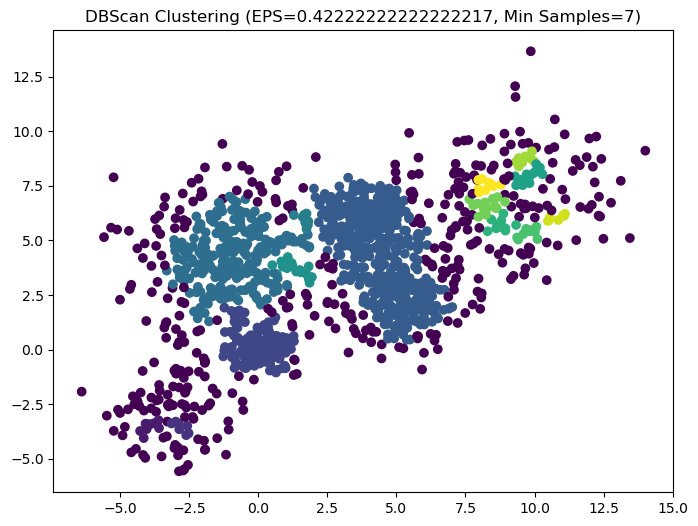

EPS: 0.42222222222222217, Min Samples: 7, Silhouette Score: -0.02097567698395347


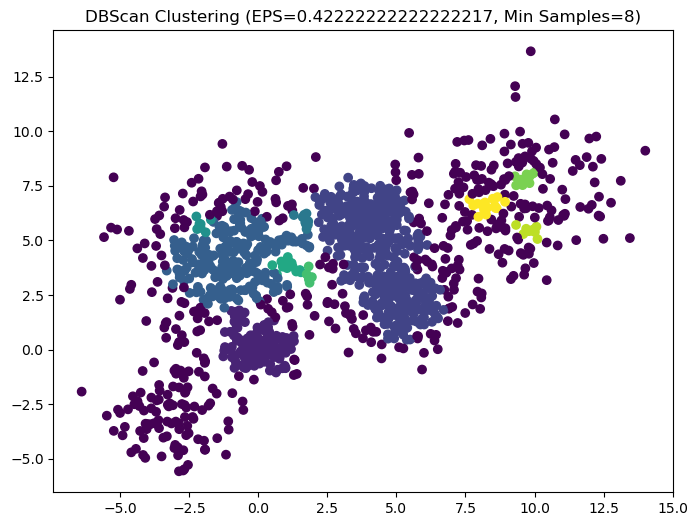

EPS: 0.42222222222222217, Min Samples: 8, Silhouette Score: -0.1201900087150528


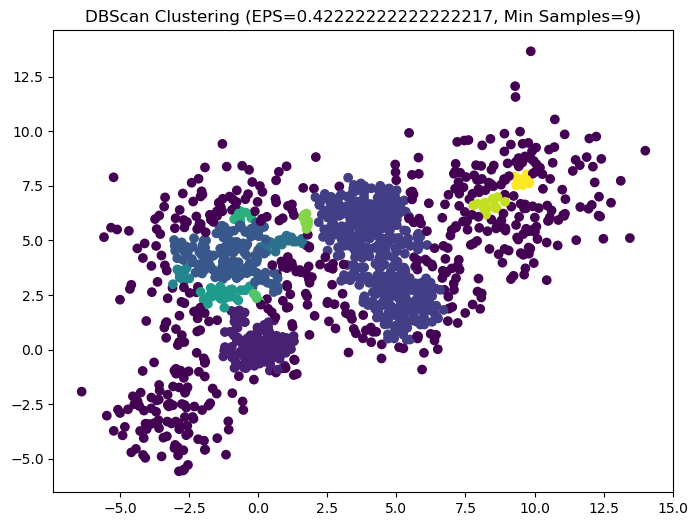

EPS: 0.42222222222222217, Min Samples: 9, Silhouette Score: -0.13010802908448418


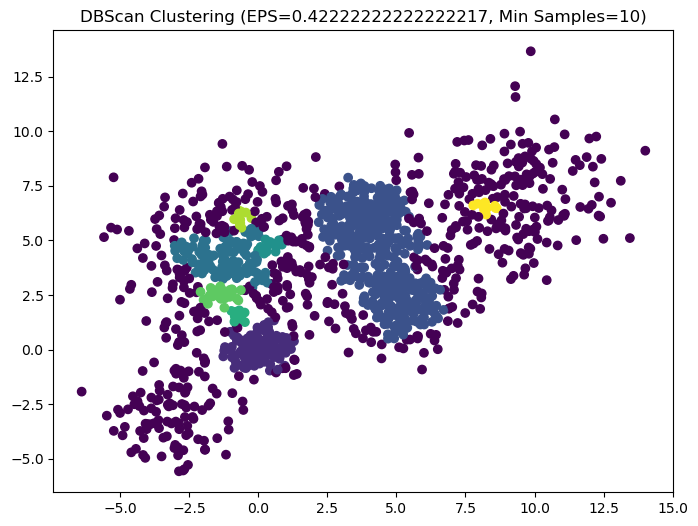

EPS: 0.42222222222222217, Min Samples: 10, Silhouette Score: -0.08607367682934244


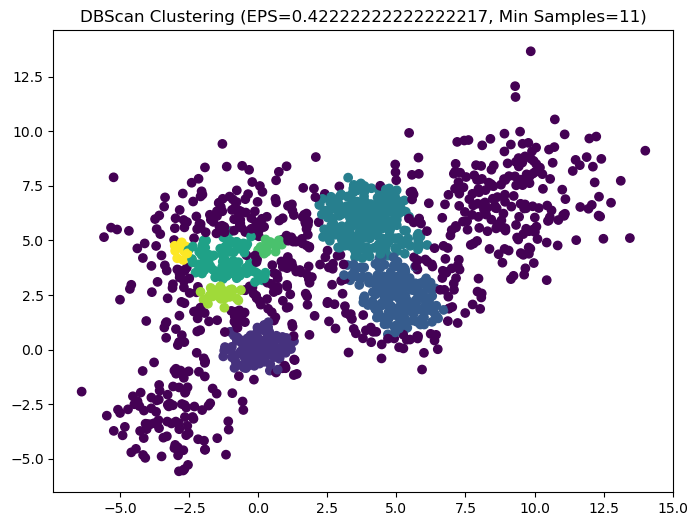

EPS: 0.42222222222222217, Min Samples: 11, Silhouette Score: 0.016409920260084337


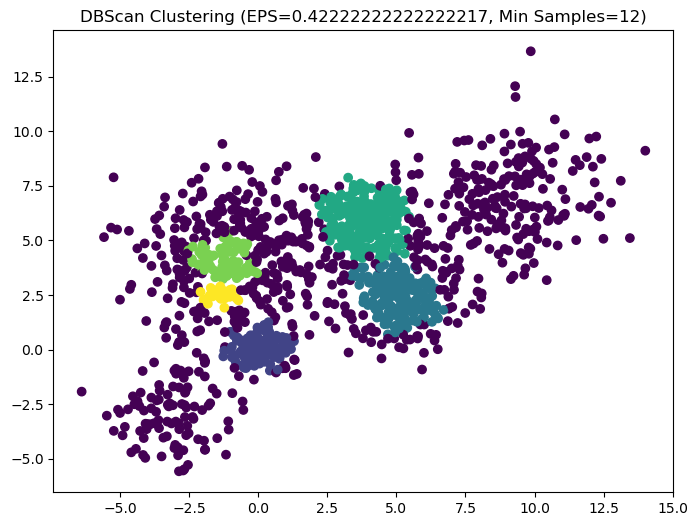

EPS: 0.42222222222222217, Min Samples: 12, Silhouette Score: 0.021481230712294616


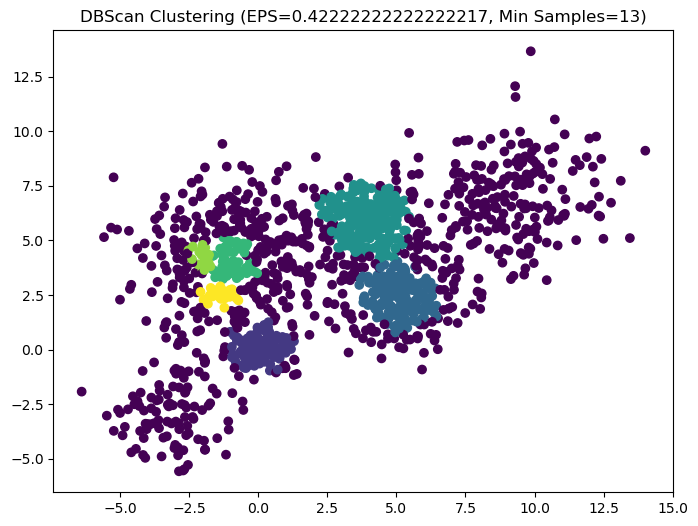

EPS: 0.42222222222222217, Min Samples: 13, Silhouette Score: -0.005702338168001859


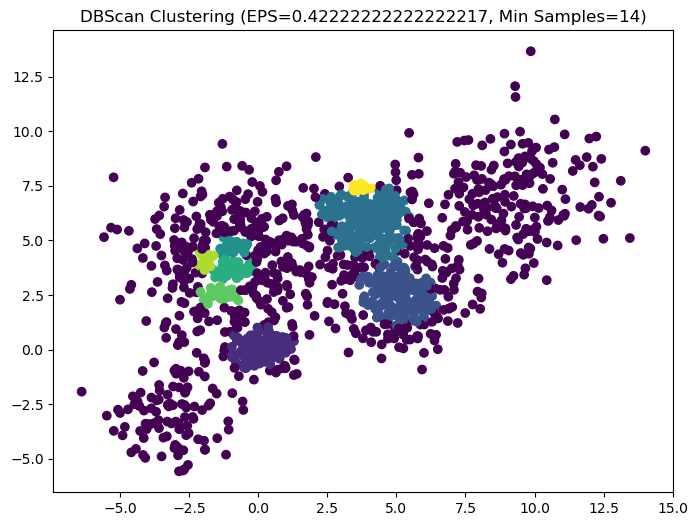

EPS: 0.42222222222222217, Min Samples: 14, Silhouette Score: -0.11615270444012149


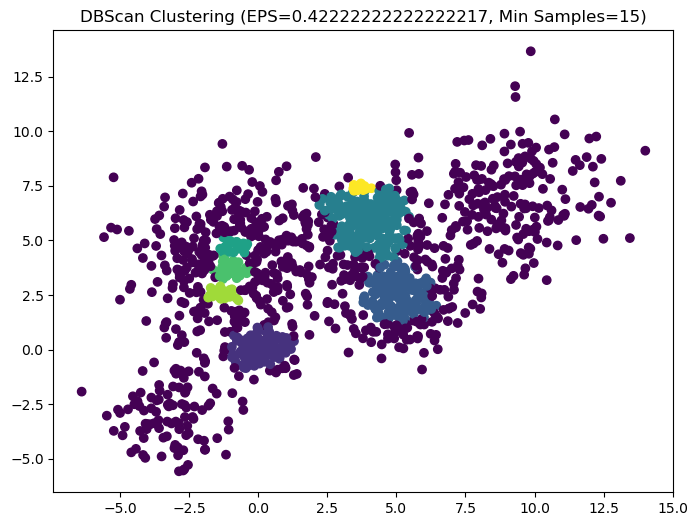

EPS: 0.42222222222222217, Min Samples: 15, Silhouette Score: -0.13986484295135443


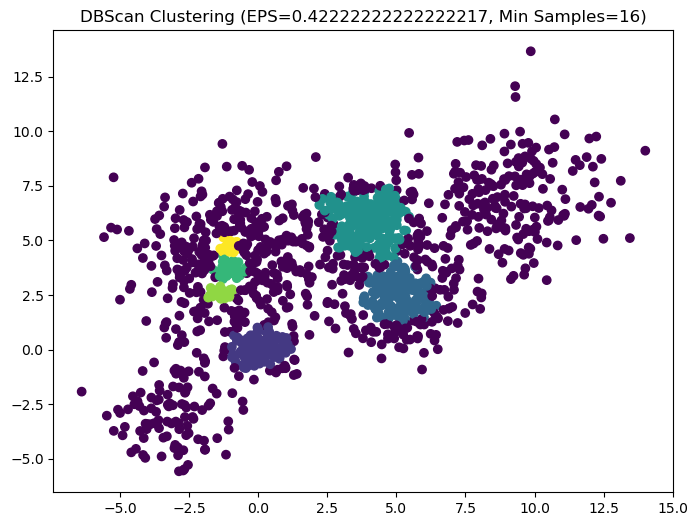

EPS: 0.42222222222222217, Min Samples: 16, Silhouette Score: -0.08018122846767413


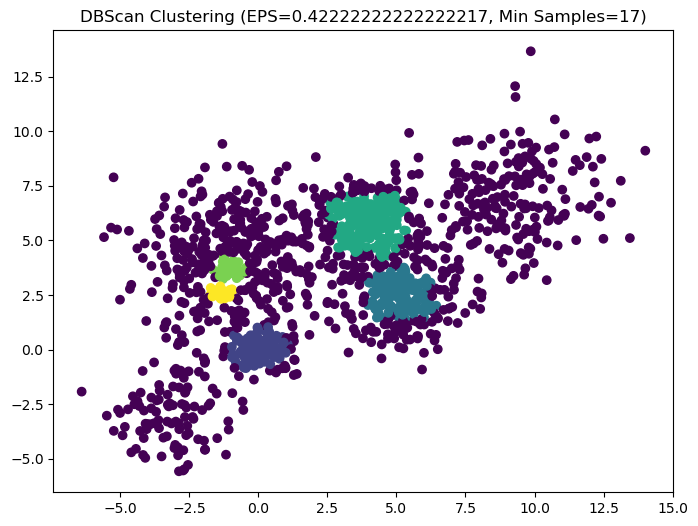

EPS: 0.42222222222222217, Min Samples: 17, Silhouette Score: -0.10451265260392892


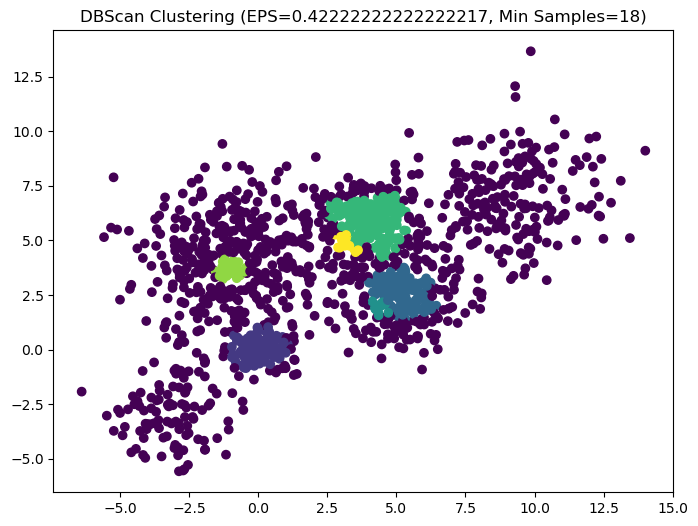

EPS: 0.42222222222222217, Min Samples: 18, Silhouette Score: -0.23940661343480596


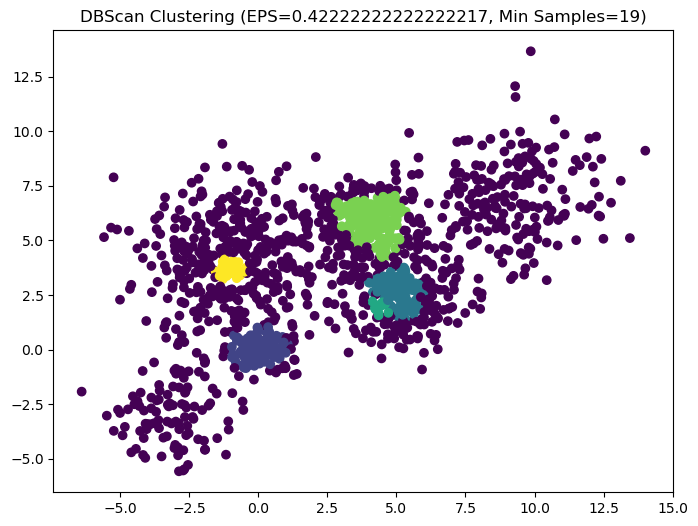

EPS: 0.42222222222222217, Min Samples: 19, Silhouette Score: -0.19991885388449504


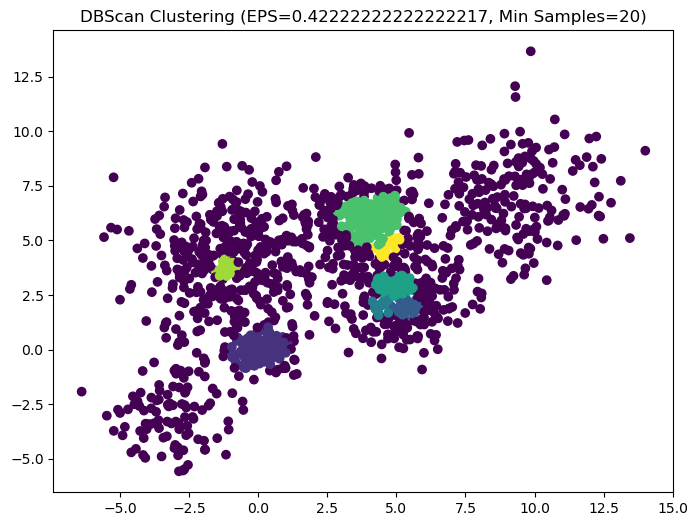

EPS: 0.42222222222222217, Min Samples: 20, Silhouette Score: -0.2789350527837981


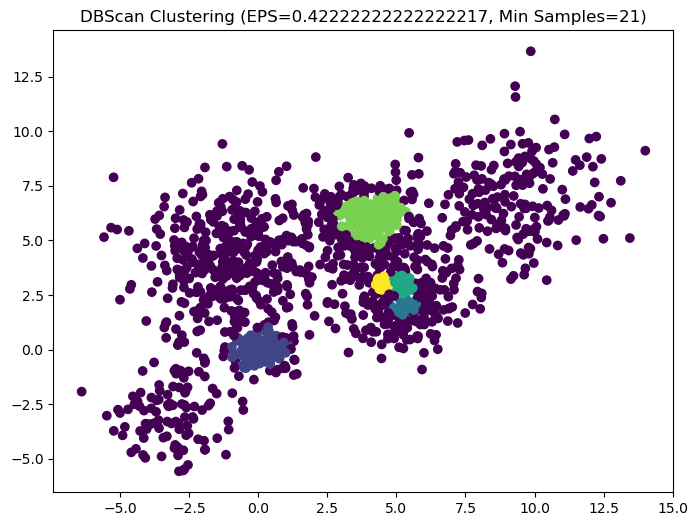

EPS: 0.42222222222222217, Min Samples: 21, Silhouette Score: -0.18998490064794718


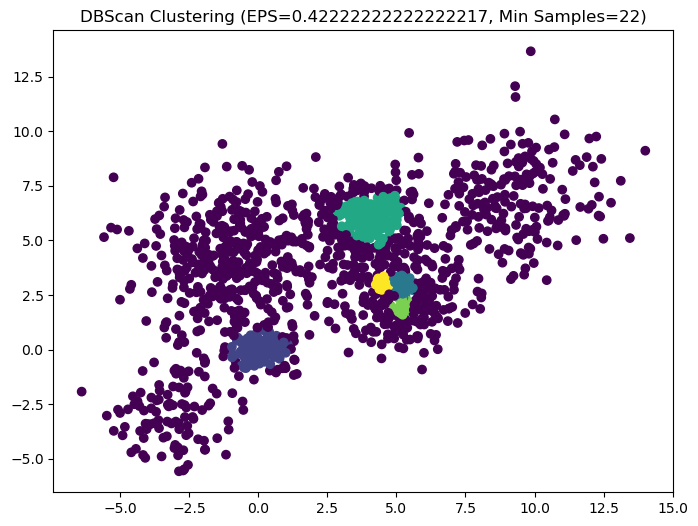

EPS: 0.42222222222222217, Min Samples: 22, Silhouette Score: -0.19658824179307724


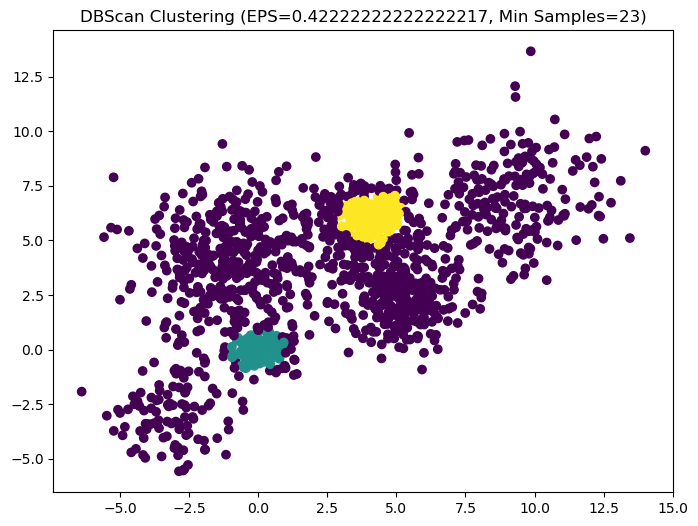

EPS: 0.42222222222222217, Min Samples: 23, Silhouette Score: -0.14205923225716077


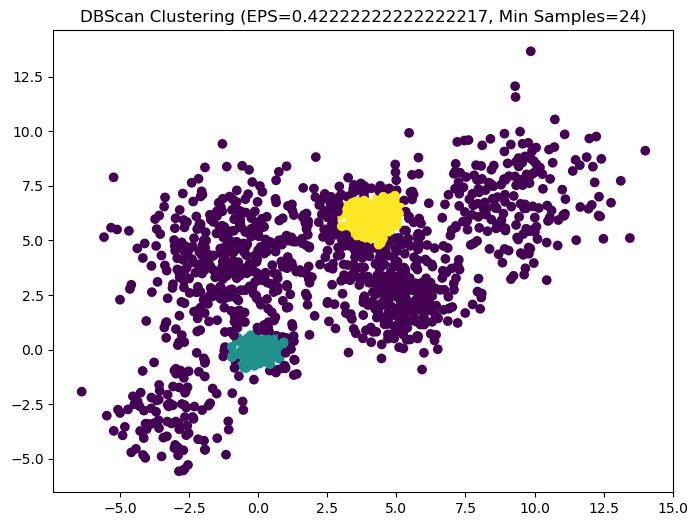

EPS: 0.42222222222222217, Min Samples: 24, Silhouette Score: -0.14582325960083817


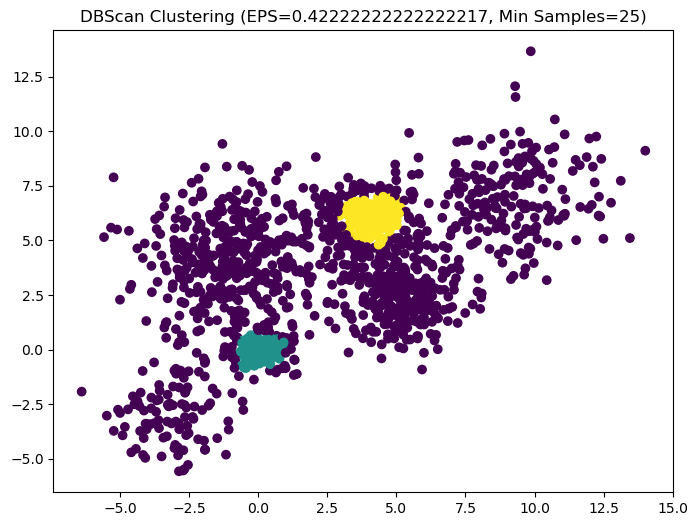

EPS: 0.42222222222222217, Min Samples: 25, Silhouette Score: -0.1566223080427179


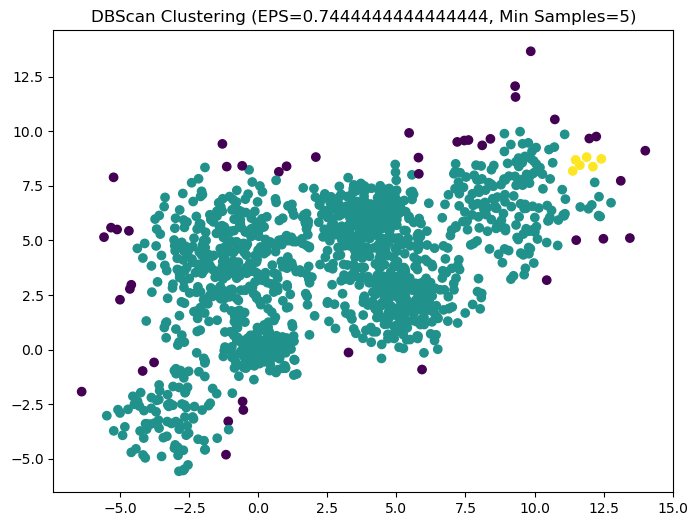

EPS: 0.7444444444444444, Min Samples: 5, Silhouette Score: 0.23847199008209857


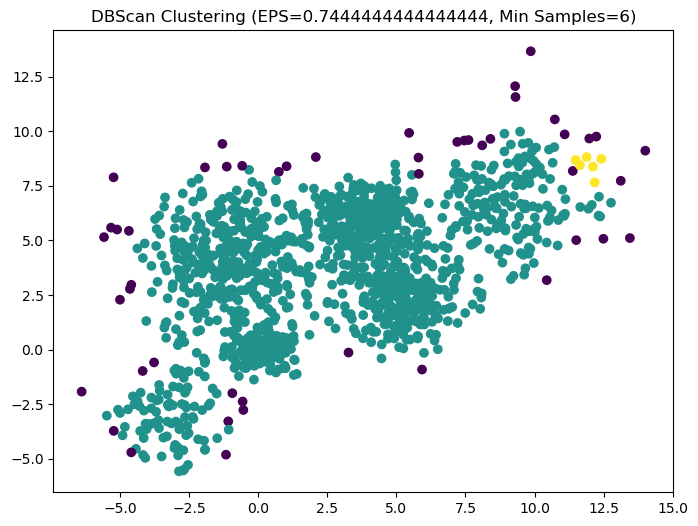

EPS: 0.7444444444444444, Min Samples: 6, Silhouette Score: 0.24423141601276604


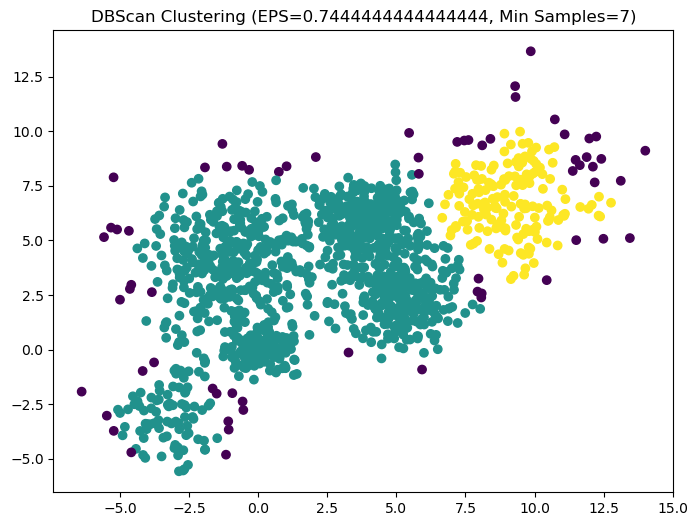

EPS: 0.7444444444444444, Min Samples: 7, Silhouette Score: 0.3008233857649601


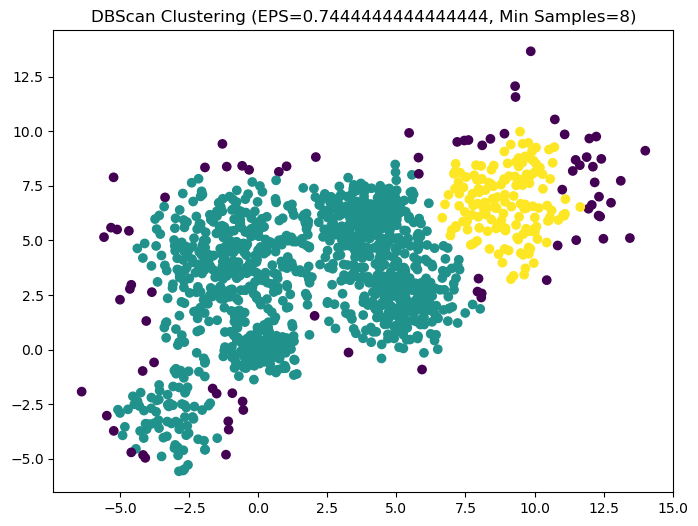

EPS: 0.7444444444444444, Min Samples: 8, Silhouette Score: 0.2900923822871023


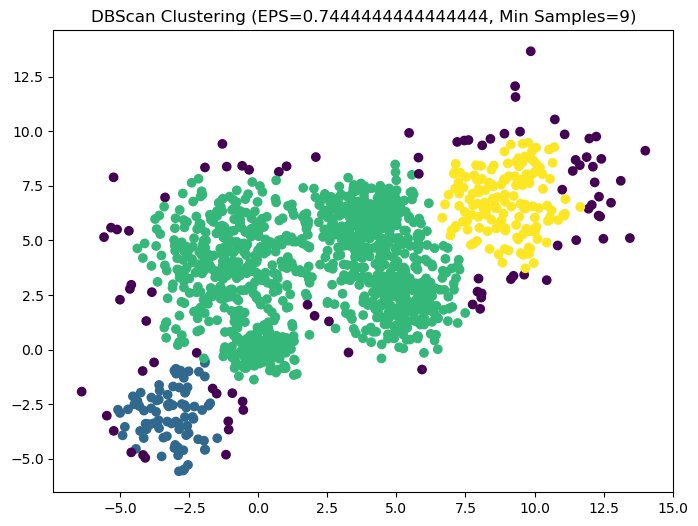

EPS: 0.7444444444444444, Min Samples: 9, Silhouette Score: 0.2417471024685272


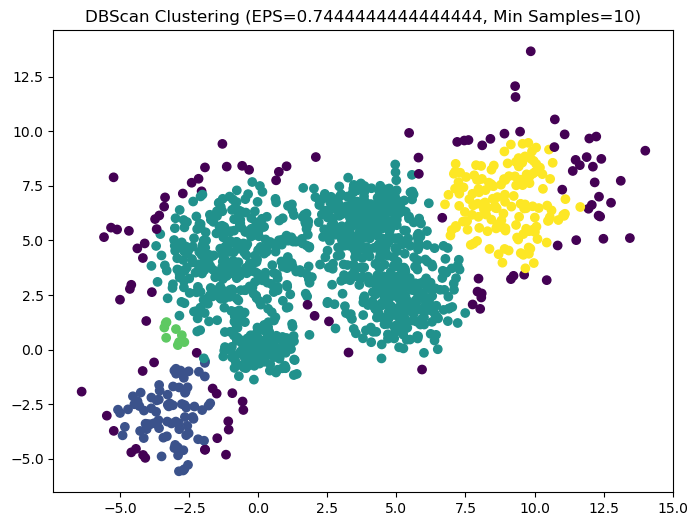

EPS: 0.7444444444444444, Min Samples: 10, Silhouette Score: 0.09095785149575897


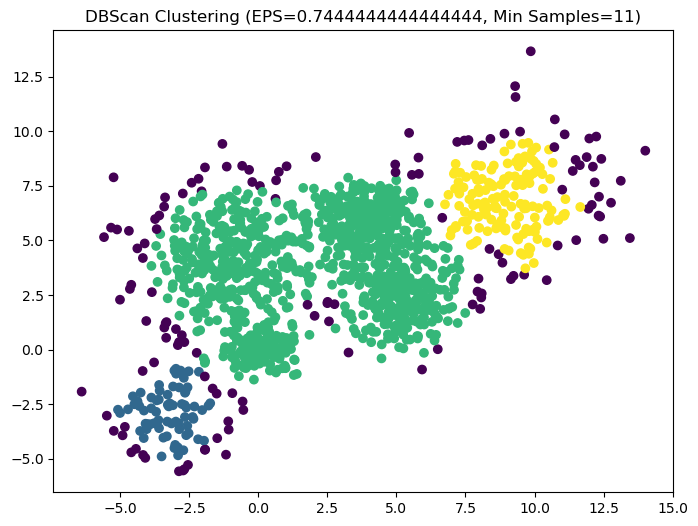

EPS: 0.7444444444444444, Min Samples: 11, Silhouette Score: 0.2143941942622653


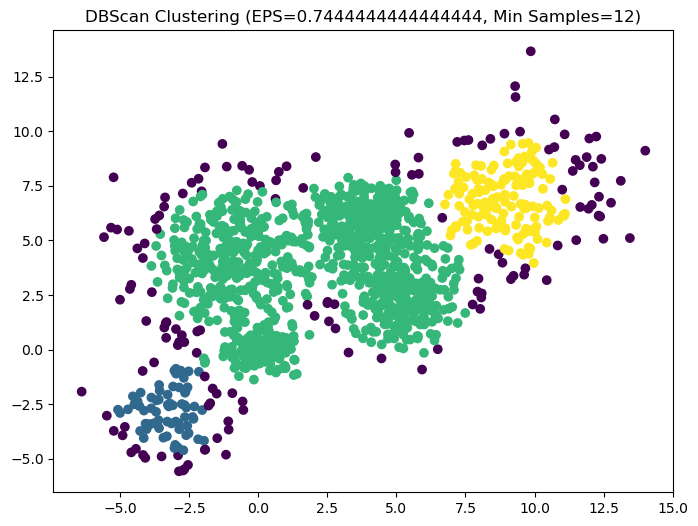

EPS: 0.7444444444444444, Min Samples: 12, Silhouette Score: 0.2037318152227401


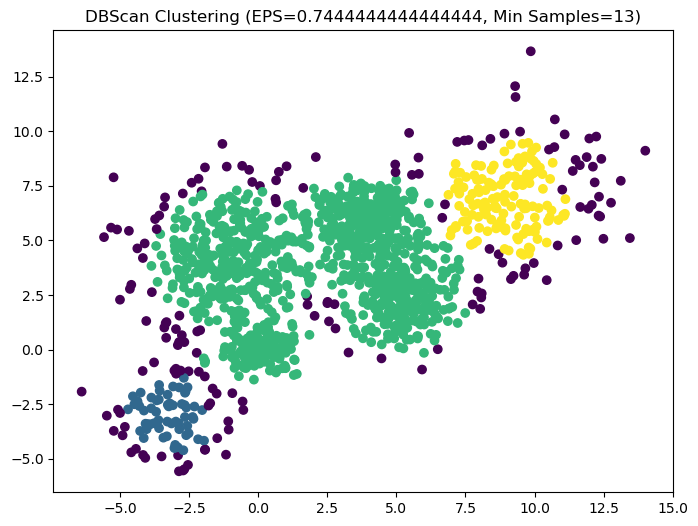

EPS: 0.7444444444444444, Min Samples: 13, Silhouette Score: 0.1978988341763587


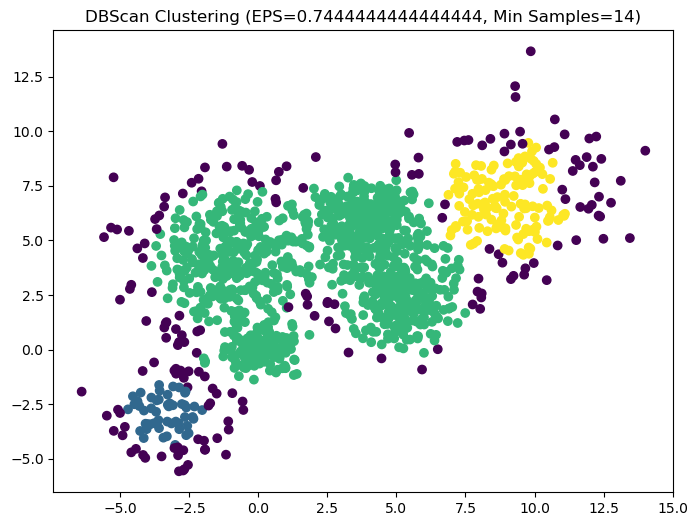

EPS: 0.7444444444444444, Min Samples: 14, Silhouette Score: 0.18204826032472776


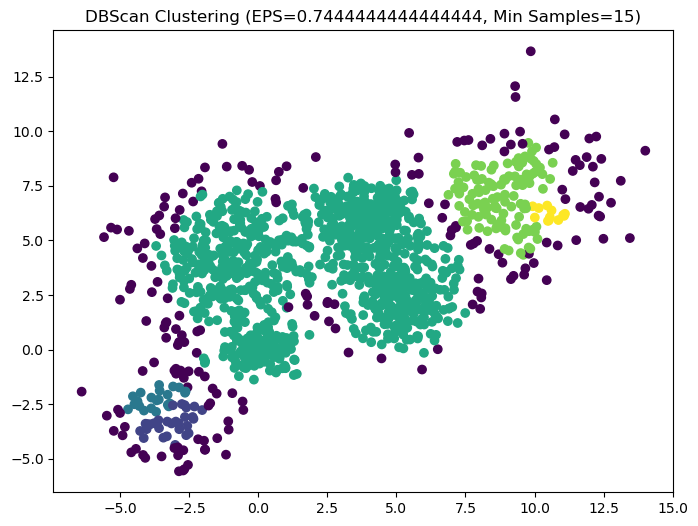

EPS: 0.7444444444444444, Min Samples: 15, Silhouette Score: 0.0894783476925647


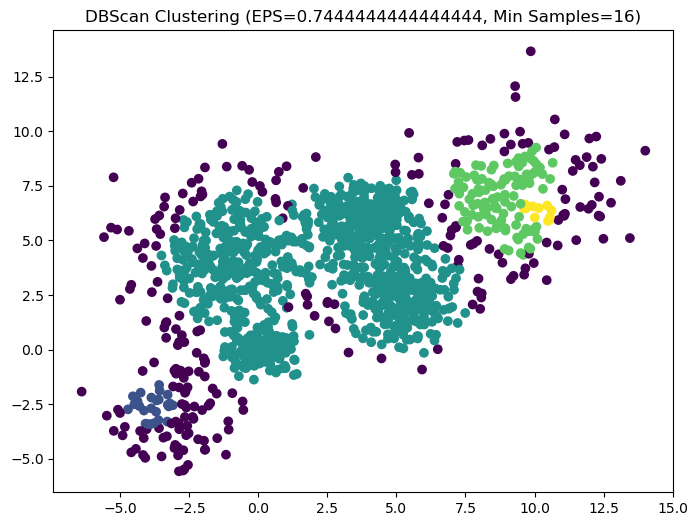

EPS: 0.7444444444444444, Min Samples: 16, Silhouette Score: 0.0773255710978283


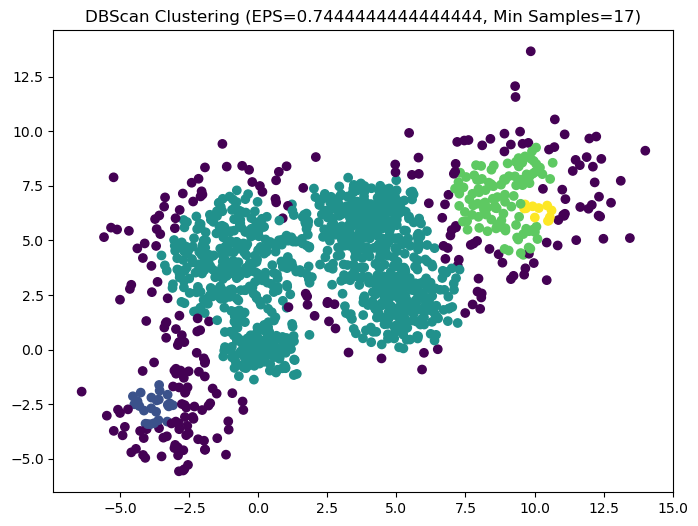

EPS: 0.7444444444444444, Min Samples: 17, Silhouette Score: 0.07332436528546403


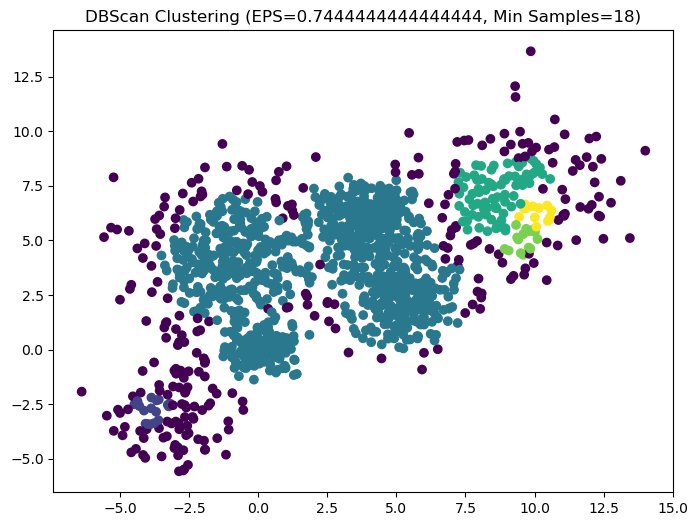

EPS: 0.7444444444444444, Min Samples: 18, Silhouette Score: 0.04521057358406084


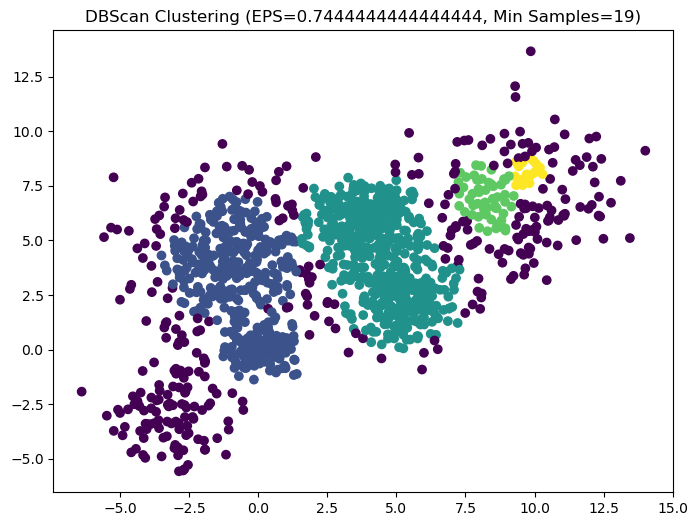

EPS: 0.7444444444444444, Min Samples: 19, Silhouette Score: 0.21476964753977074


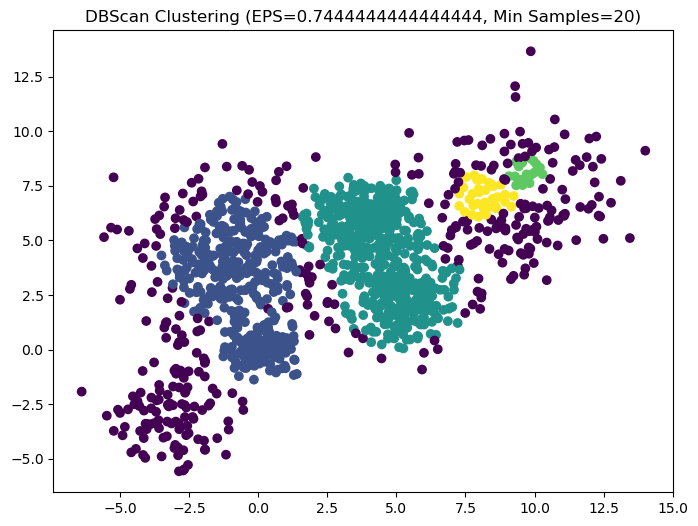

EPS: 0.7444444444444444, Min Samples: 20, Silhouette Score: 0.1979002749150213


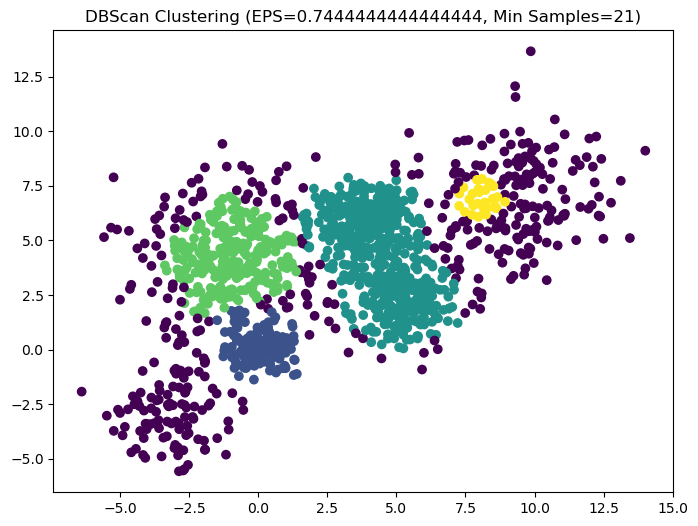

EPS: 0.7444444444444444, Min Samples: 21, Silhouette Score: 0.16148017684569207


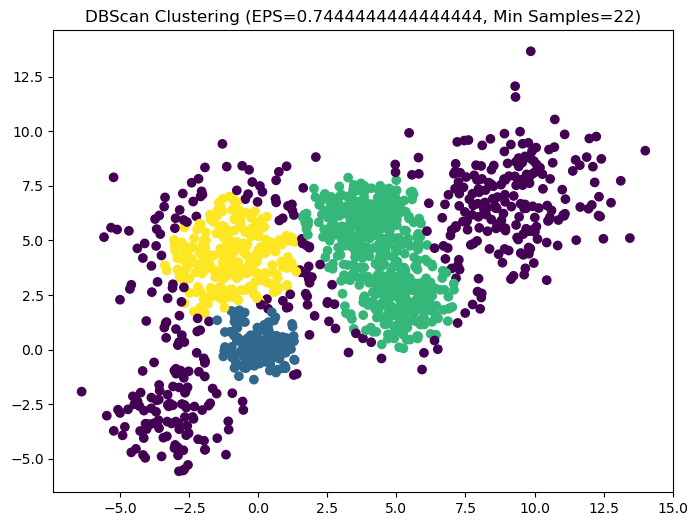

EPS: 0.7444444444444444, Min Samples: 22, Silhouette Score: 0.22982284457730642


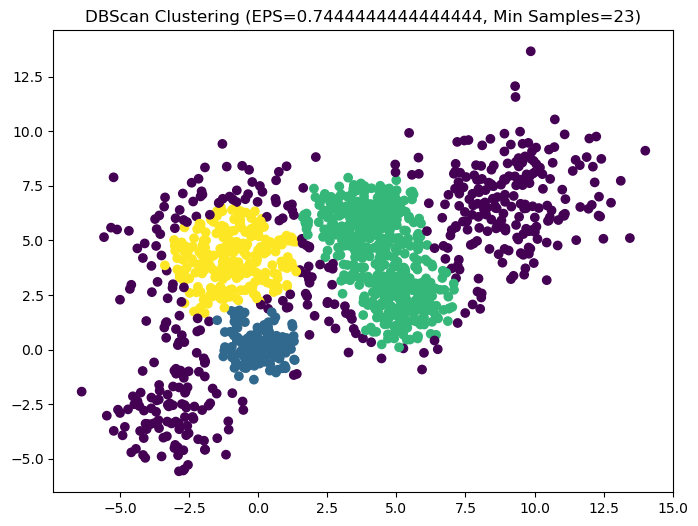

EPS: 0.7444444444444444, Min Samples: 23, Silhouette Score: 0.21972577884247094


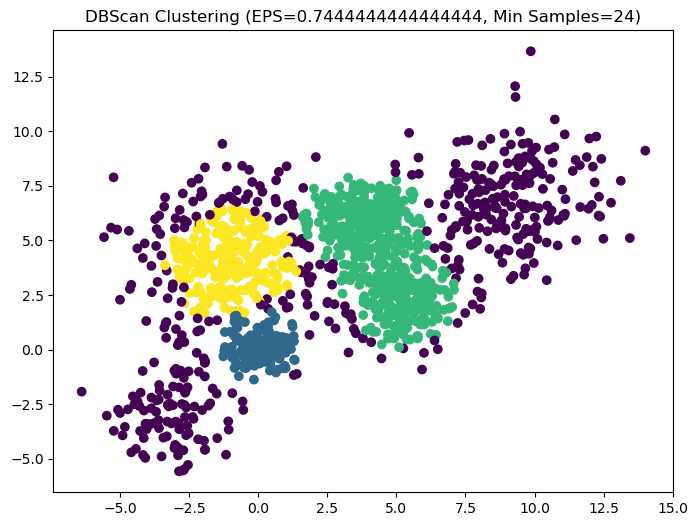

EPS: 0.7444444444444444, Min Samples: 24, Silhouette Score: 0.21496115921092493


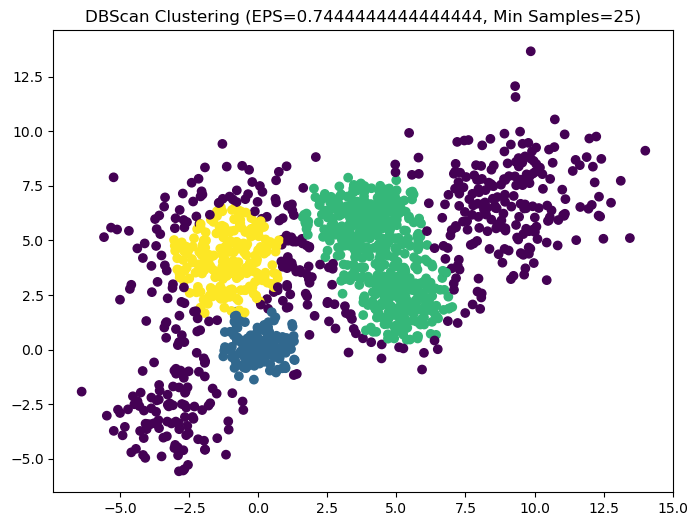

EPS: 0.7444444444444444, Min Samples: 25, Silhouette Score: 0.20438354923486016


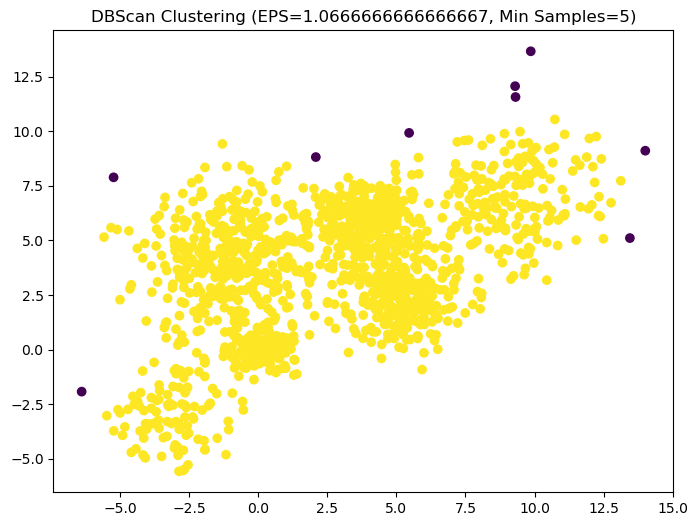

EPS: 1.0666666666666667, Min Samples: 5, Silhouette Score: 0.39959879394893216


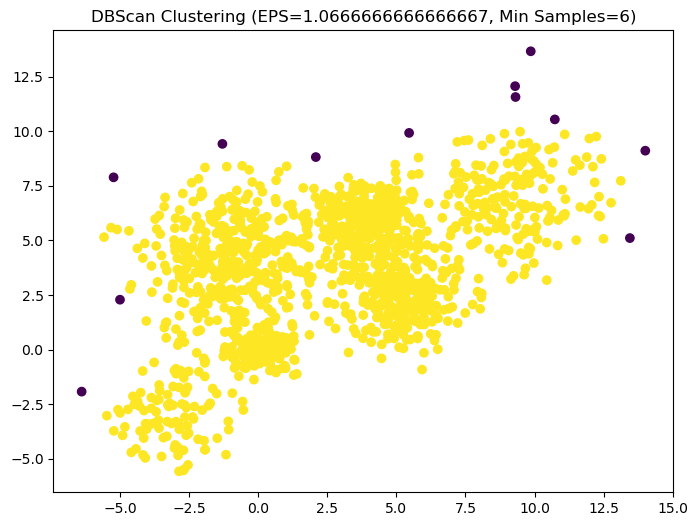

EPS: 1.0666666666666667, Min Samples: 6, Silhouette Score: 0.3887346557021435


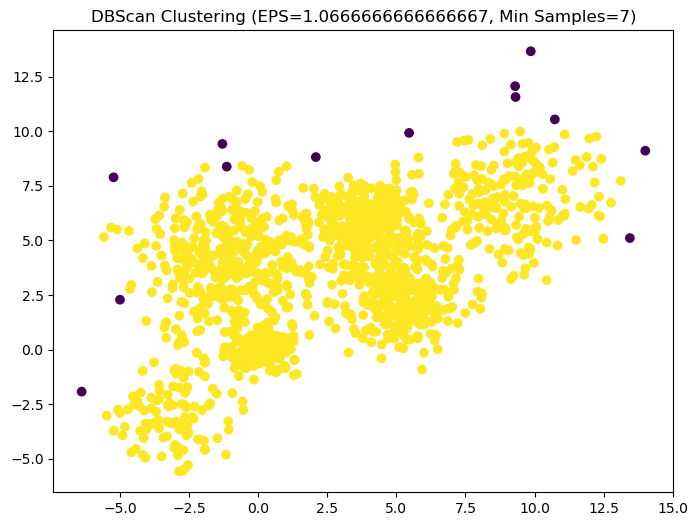

EPS: 1.0666666666666667, Min Samples: 7, Silhouette Score: 0.37719338859352086


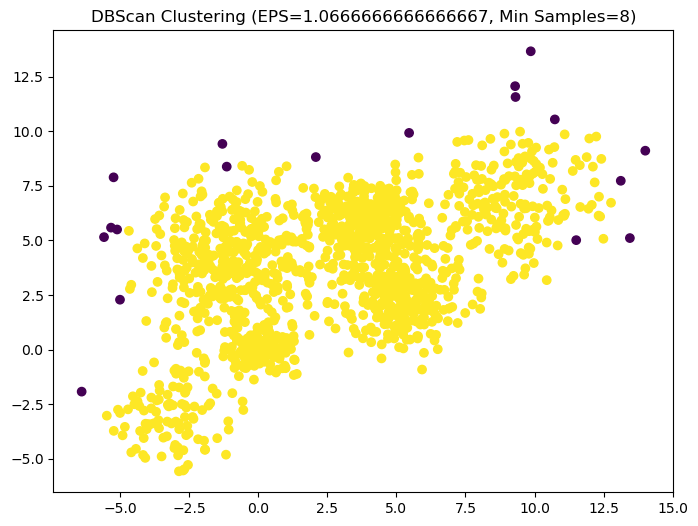

EPS: 1.0666666666666667, Min Samples: 8, Silhouette Score: 0.3765258134362482


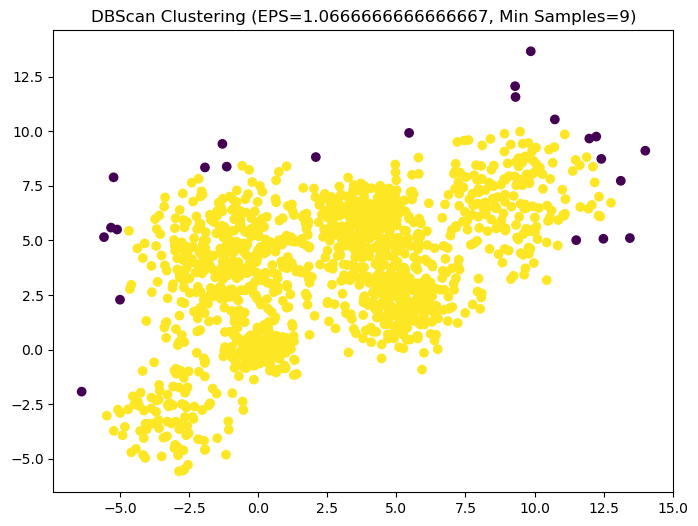

EPS: 1.0666666666666667, Min Samples: 9, Silhouette Score: 0.3821999484187025


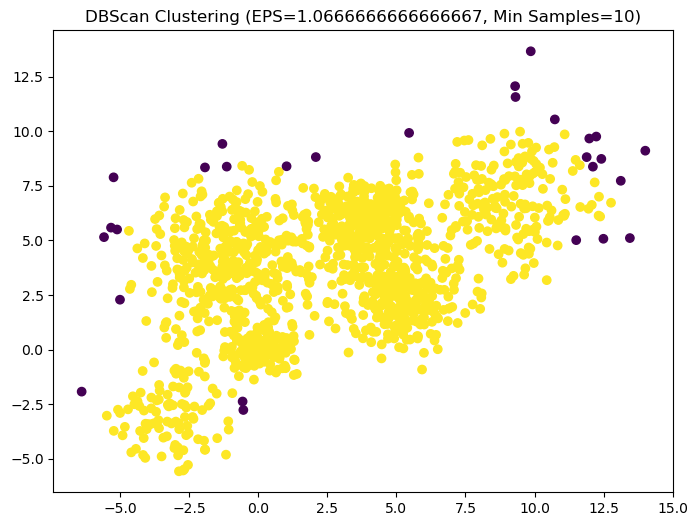

EPS: 1.0666666666666667, Min Samples: 10, Silhouette Score: 0.3723548388821037


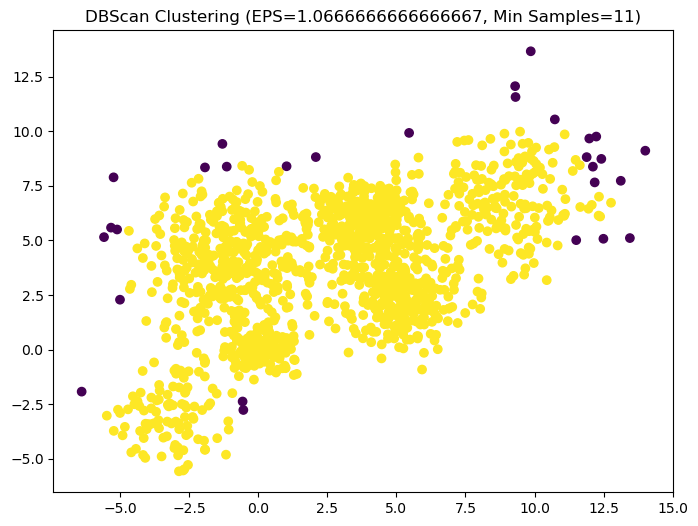

EPS: 1.0666666666666667, Min Samples: 11, Silhouette Score: 0.37355810669270945


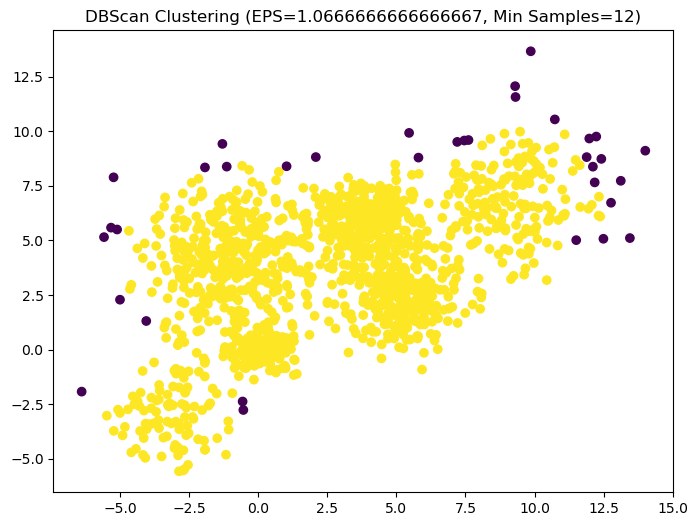

EPS: 1.0666666666666667, Min Samples: 12, Silhouette Score: 0.3573471326998424


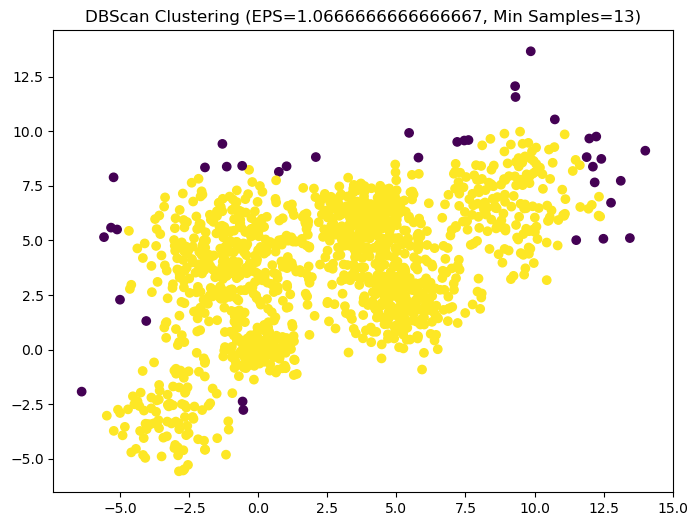

EPS: 1.0666666666666667, Min Samples: 13, Silhouette Score: 0.3479997897746252


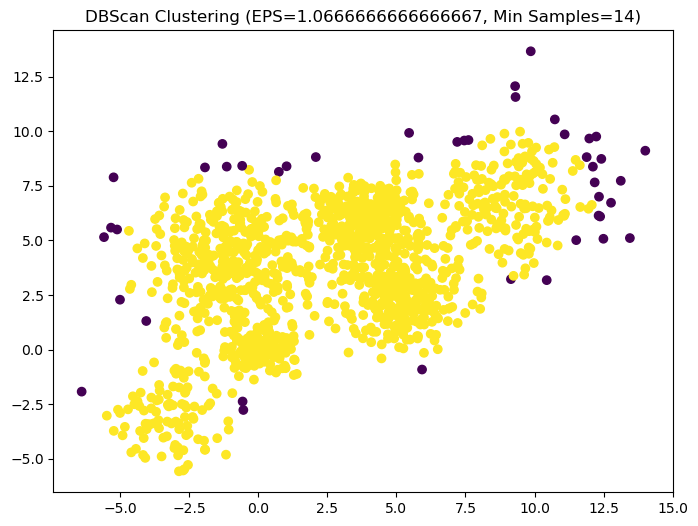

EPS: 1.0666666666666667, Min Samples: 14, Silhouette Score: 0.34543352510225656


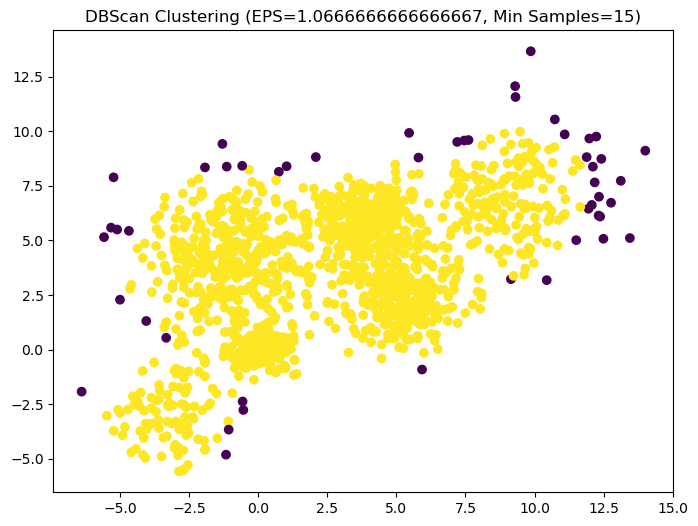

EPS: 1.0666666666666667, Min Samples: 15, Silhouette Score: 0.348320080224711


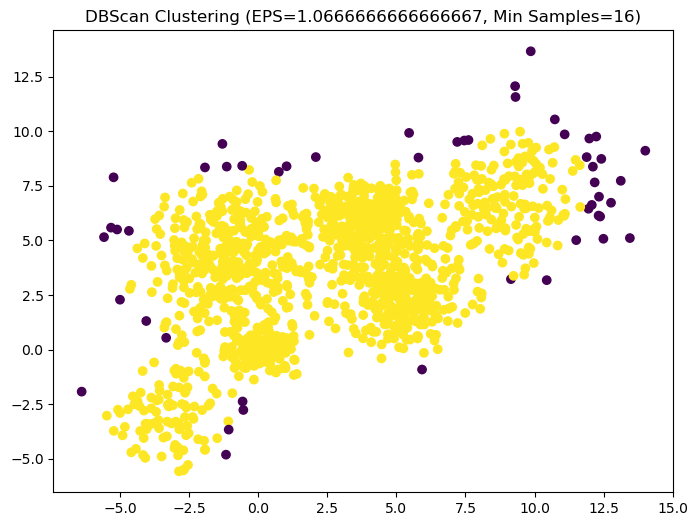

EPS: 1.0666666666666667, Min Samples: 16, Silhouette Score: 0.348320080224711


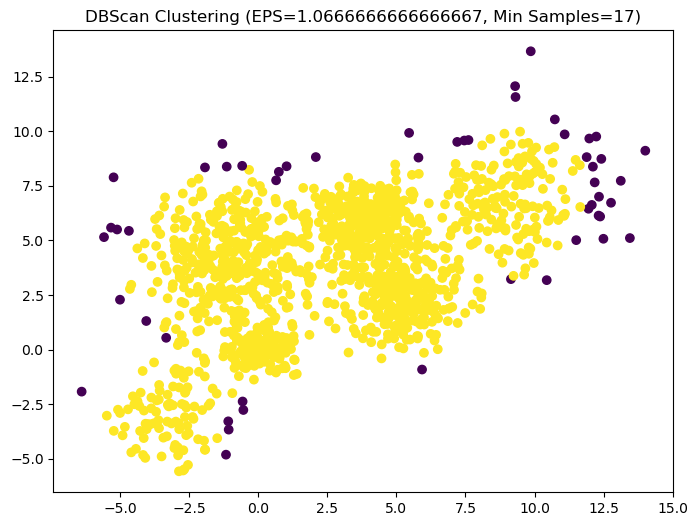

EPS: 1.0666666666666667, Min Samples: 17, Silhouette Score: 0.34417841987430337


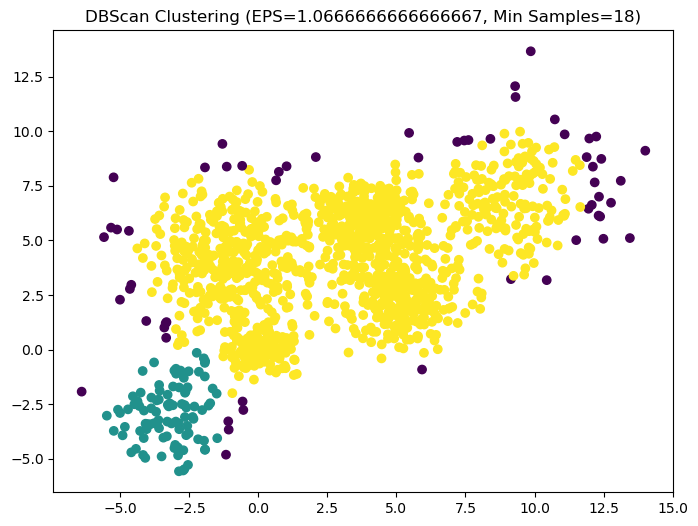

EPS: 1.0666666666666667, Min Samples: 18, Silhouette Score: 0.28489430275841054


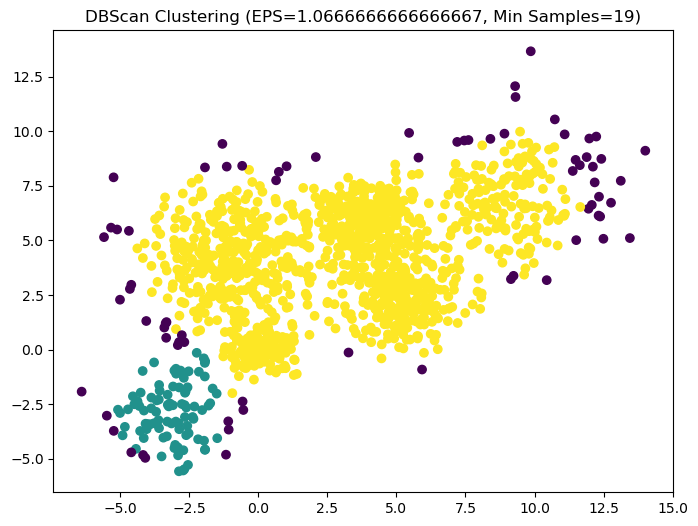

EPS: 1.0666666666666667, Min Samples: 19, Silhouette Score: 0.28854277949205964


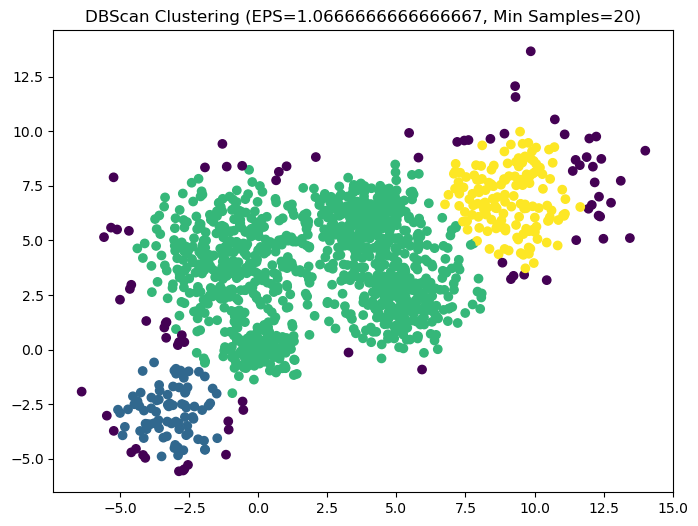

EPS: 1.0666666666666667, Min Samples: 20, Silhouette Score: 0.2408341237625327


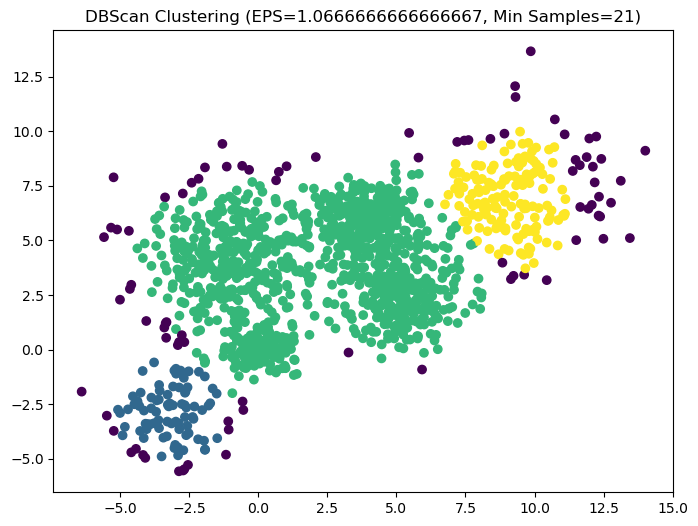

EPS: 1.0666666666666667, Min Samples: 21, Silhouette Score: 0.23761039686211877


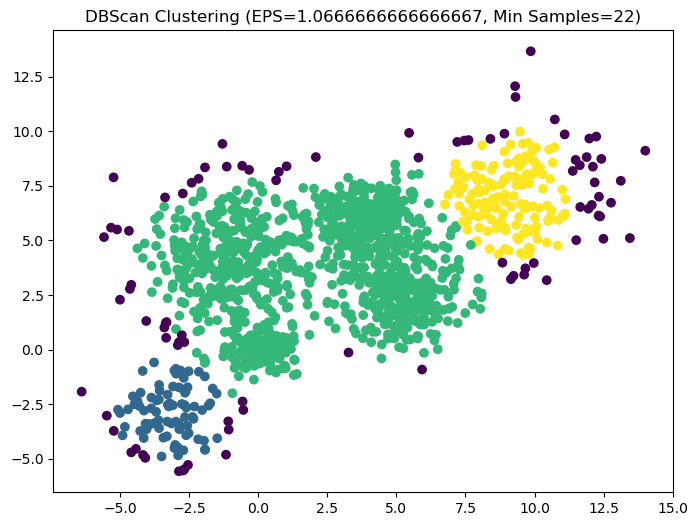

EPS: 1.0666666666666667, Min Samples: 22, Silhouette Score: 0.23634205168498018


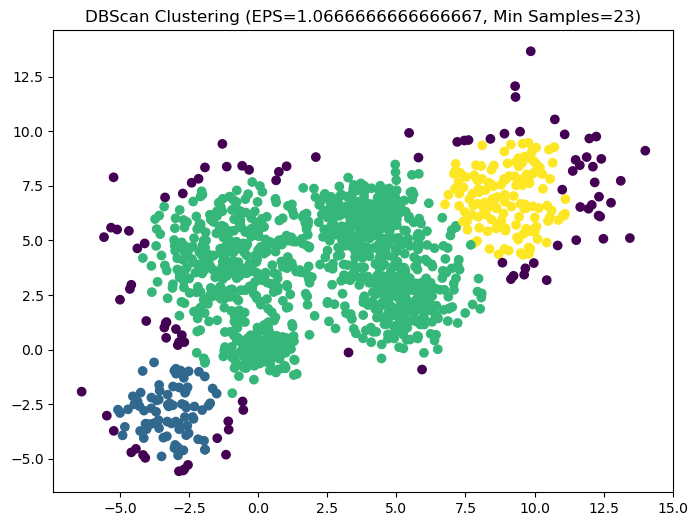

EPS: 1.0666666666666667, Min Samples: 23, Silhouette Score: 0.23060204908330897


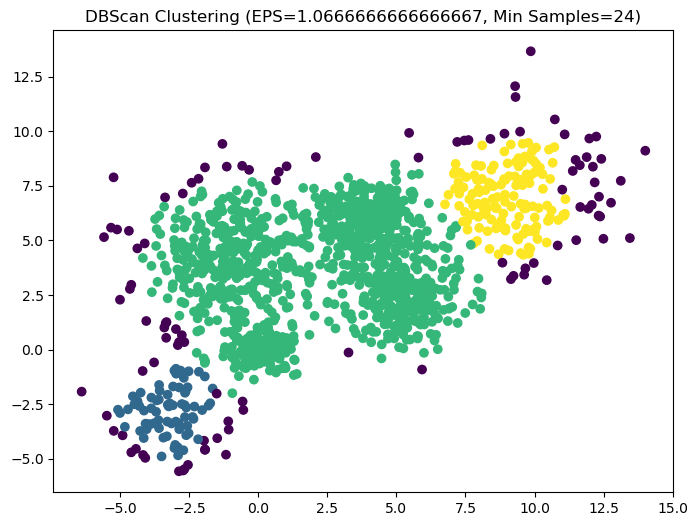

EPS: 1.0666666666666667, Min Samples: 24, Silhouette Score: 0.22285422176188768


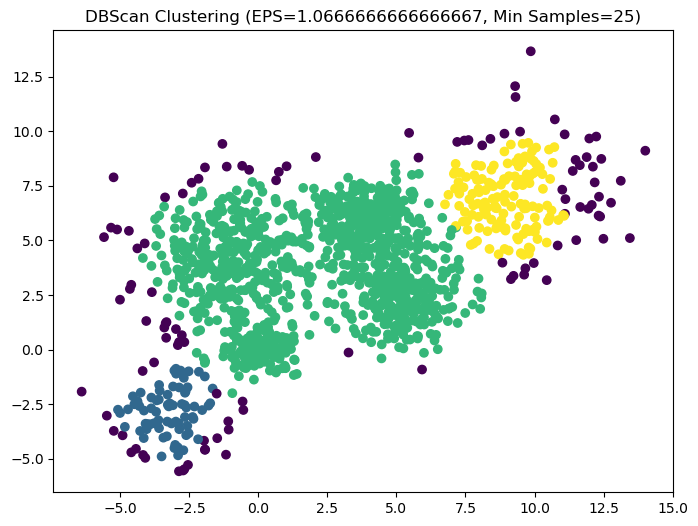

EPS: 1.0666666666666667, Min Samples: 25, Silhouette Score: 0.2186871225368653


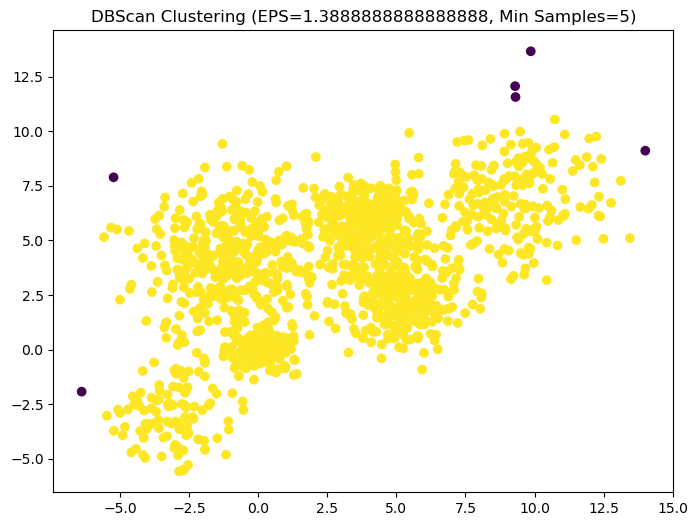

EPS: 1.3888888888888888, Min Samples: 5, Silhouette Score: 0.4531919763890837


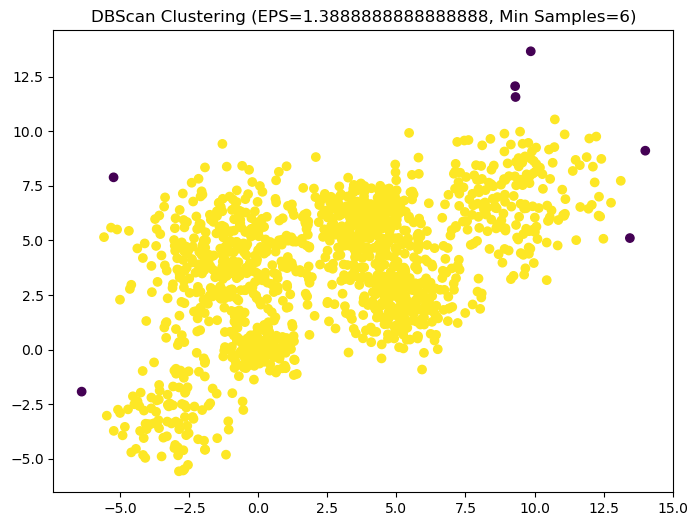

EPS: 1.3888888888888888, Min Samples: 6, Silhouette Score: 0.4485337225414618


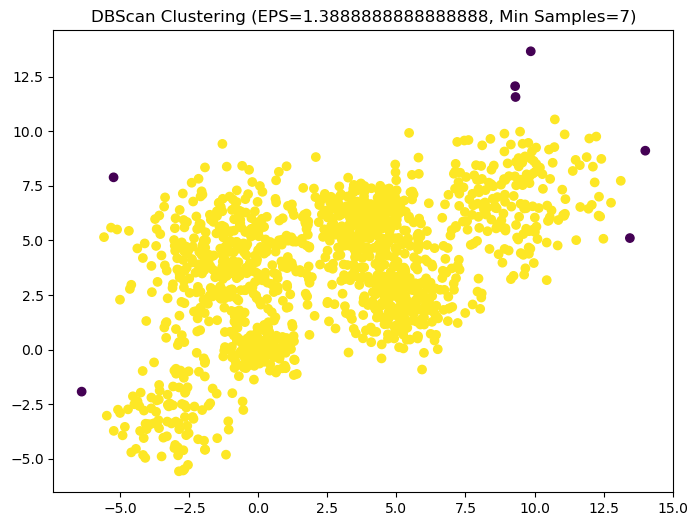

EPS: 1.3888888888888888, Min Samples: 7, Silhouette Score: 0.4485337225414618


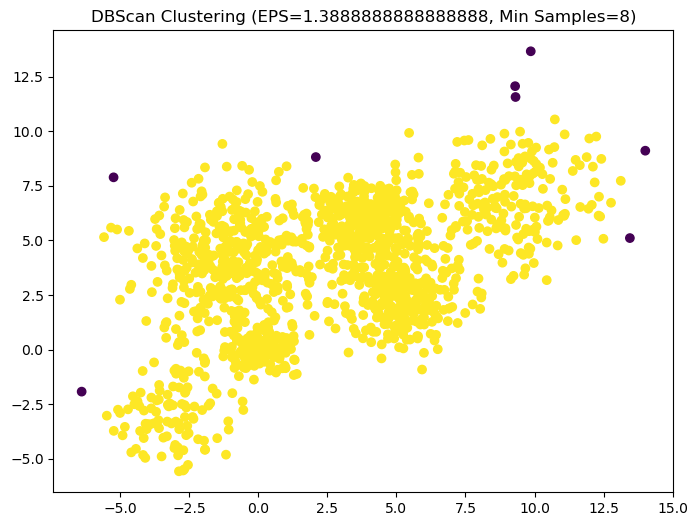

EPS: 1.3888888888888888, Min Samples: 8, Silhouette Score: 0.4200116539818508


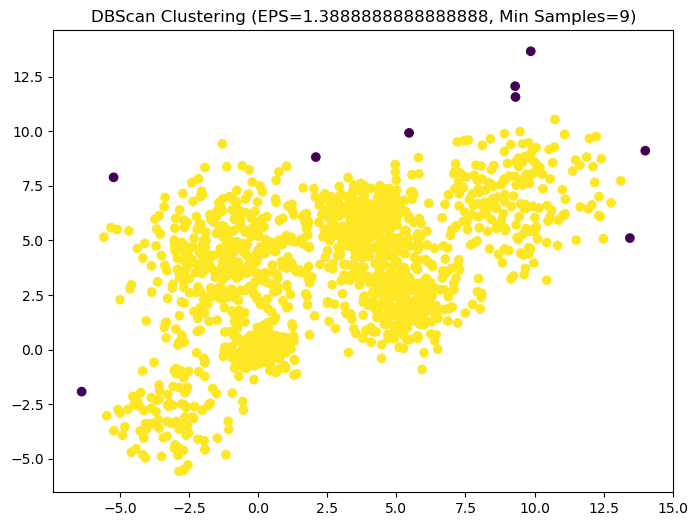

EPS: 1.3888888888888888, Min Samples: 9, Silhouette Score: 0.39959879394893216


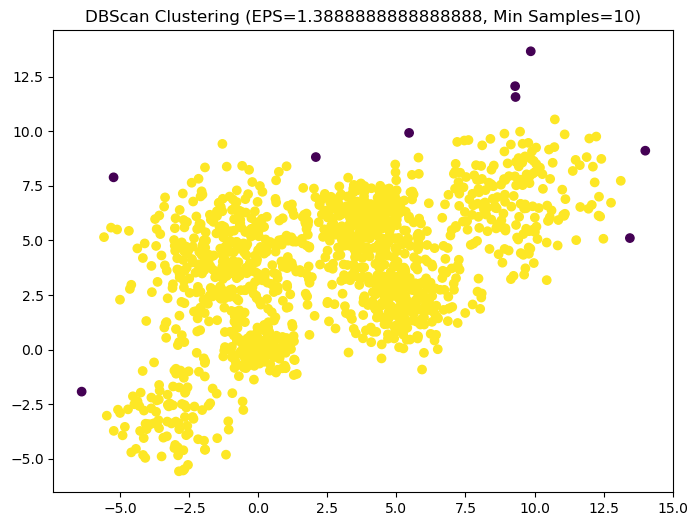

EPS: 1.3888888888888888, Min Samples: 10, Silhouette Score: 0.39959879394893216


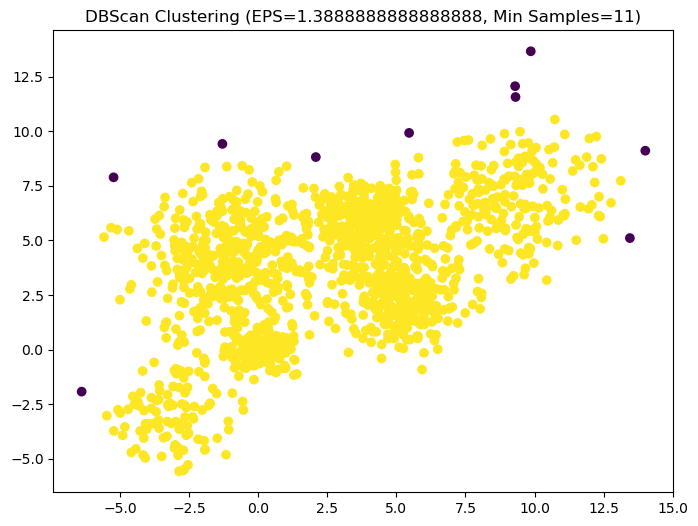

EPS: 1.3888888888888888, Min Samples: 11, Silhouette Score: 0.3895643889549862


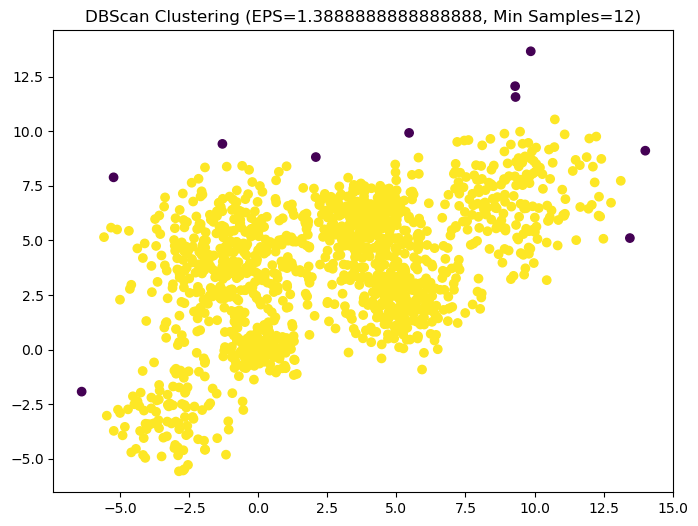

EPS: 1.3888888888888888, Min Samples: 12, Silhouette Score: 0.3895643889549862


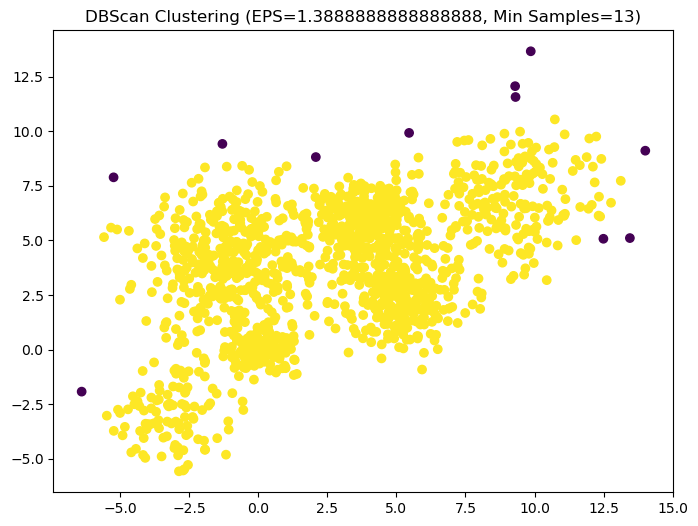

EPS: 1.3888888888888888, Min Samples: 13, Silhouette Score: 0.3880513251024352


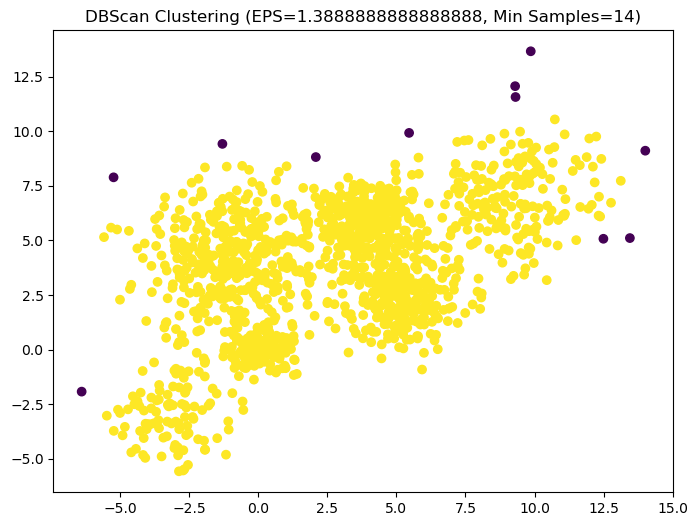

EPS: 1.3888888888888888, Min Samples: 14, Silhouette Score: 0.3880513251024352


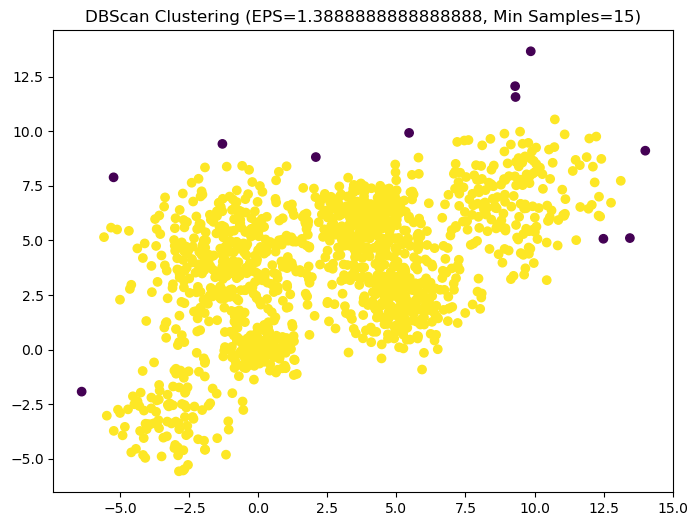

EPS: 1.3888888888888888, Min Samples: 15, Silhouette Score: 0.3880513251024352


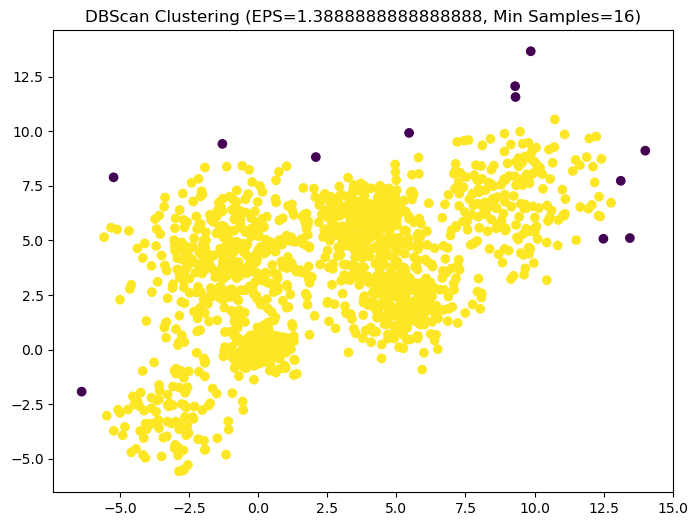

EPS: 1.3888888888888888, Min Samples: 16, Silhouette Score: 0.3915873993639224


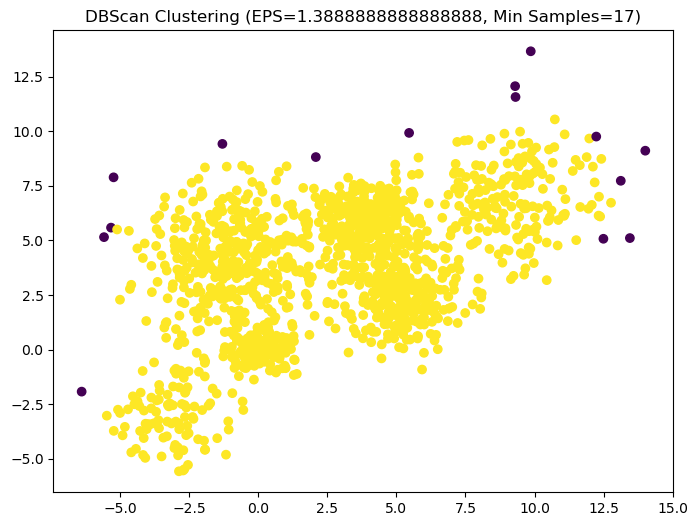

EPS: 1.3888888888888888, Min Samples: 17, Silhouette Score: 0.3955271024719828


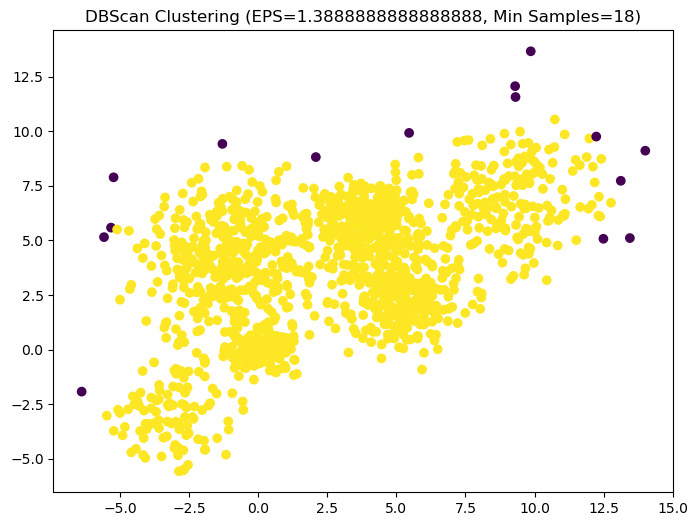

EPS: 1.3888888888888888, Min Samples: 18, Silhouette Score: 0.3955271024719828


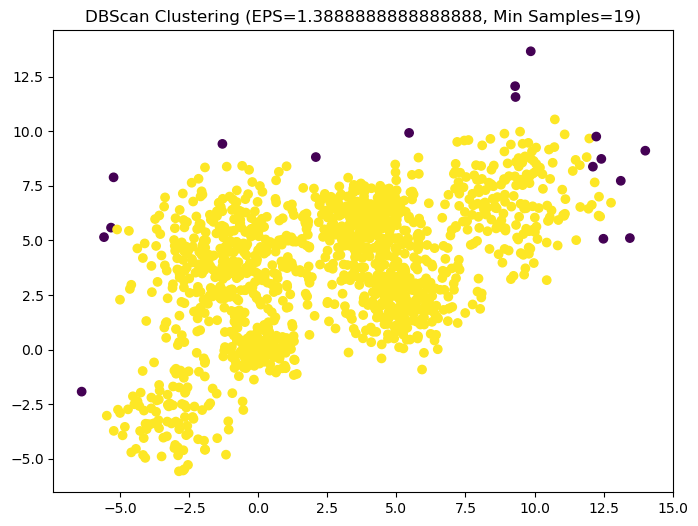

EPS: 1.3888888888888888, Min Samples: 19, Silhouette Score: 0.3974315915569298


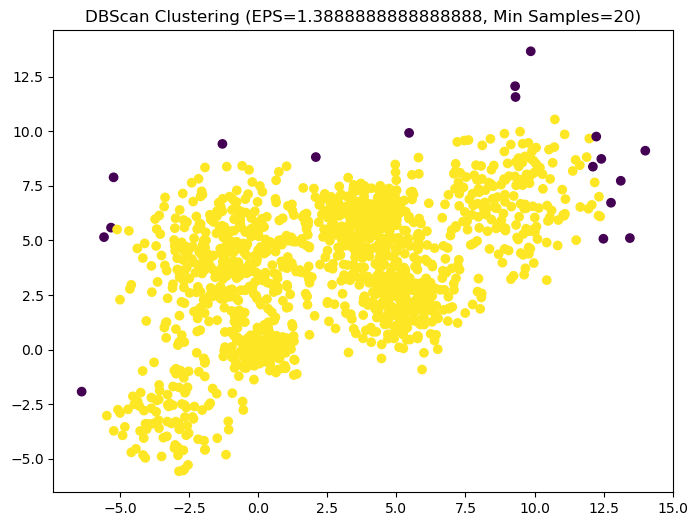

EPS: 1.3888888888888888, Min Samples: 20, Silhouette Score: 0.3977560063022621


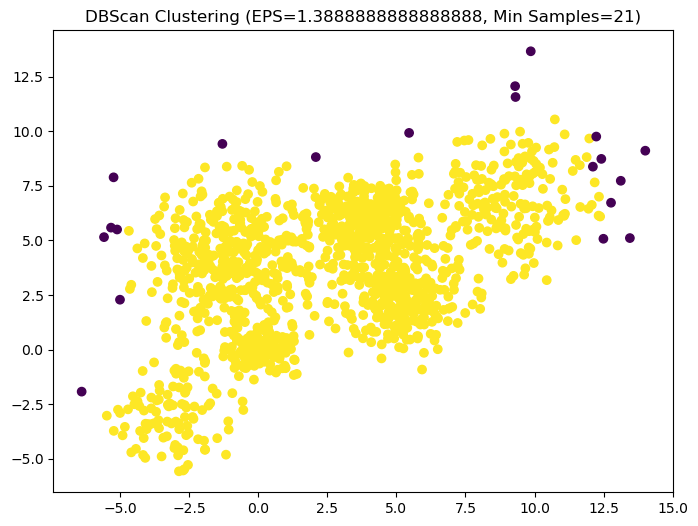

EPS: 1.3888888888888888, Min Samples: 21, Silhouette Score: 0.39536606180247086


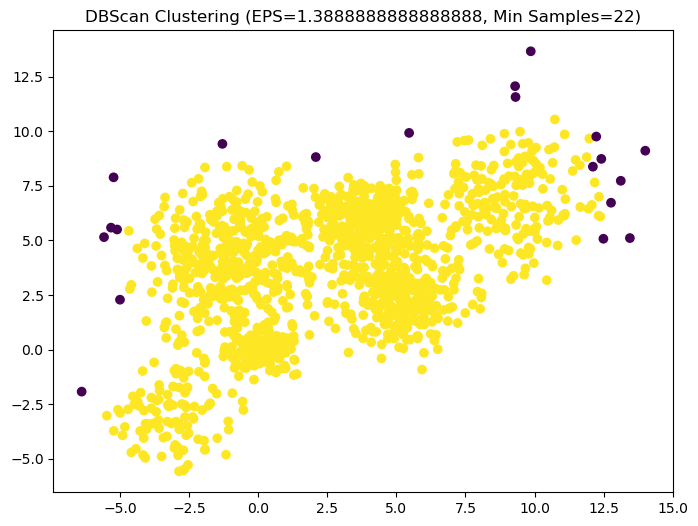

EPS: 1.3888888888888888, Min Samples: 22, Silhouette Score: 0.39536606180247086


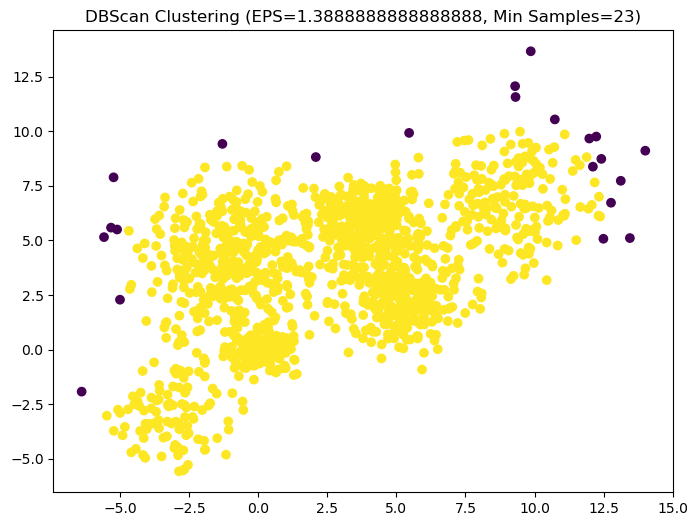

EPS: 1.3888888888888888, Min Samples: 23, Silhouette Score: 0.398121430952777


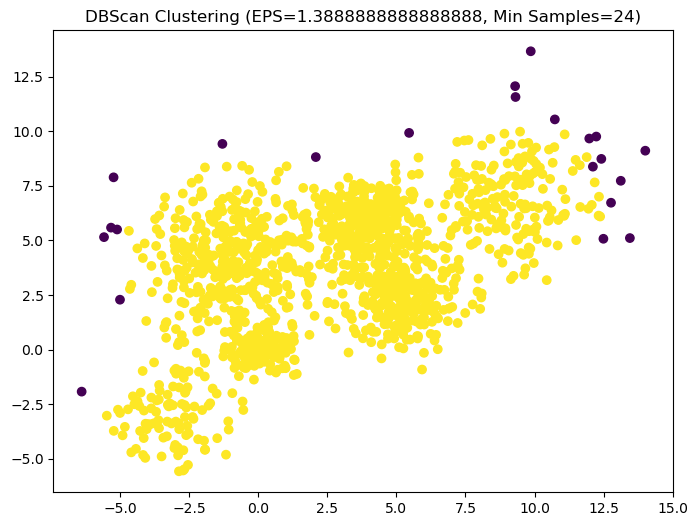

EPS: 1.3888888888888888, Min Samples: 24, Silhouette Score: 0.398121430952777


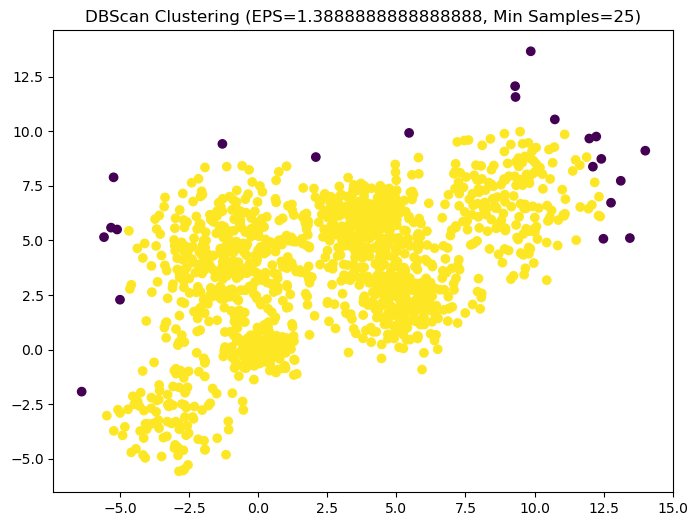

EPS: 1.3888888888888888, Min Samples: 25, Silhouette Score: 0.398121430952777


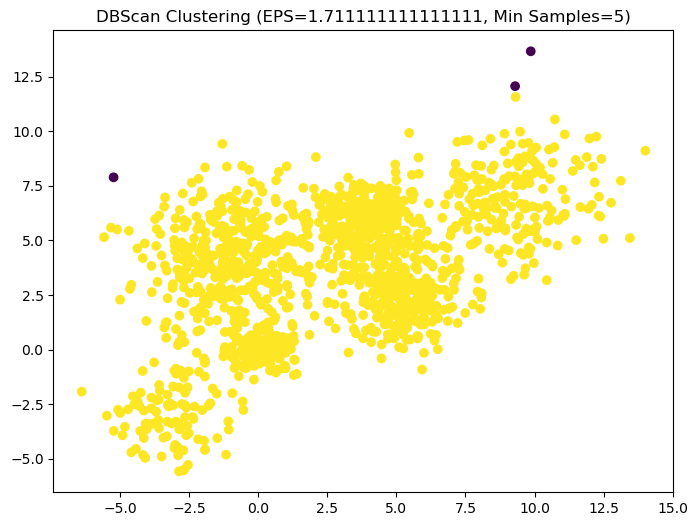

EPS: 1.711111111111111, Min Samples: 5, Silhouette Score: 0.43762353642223145


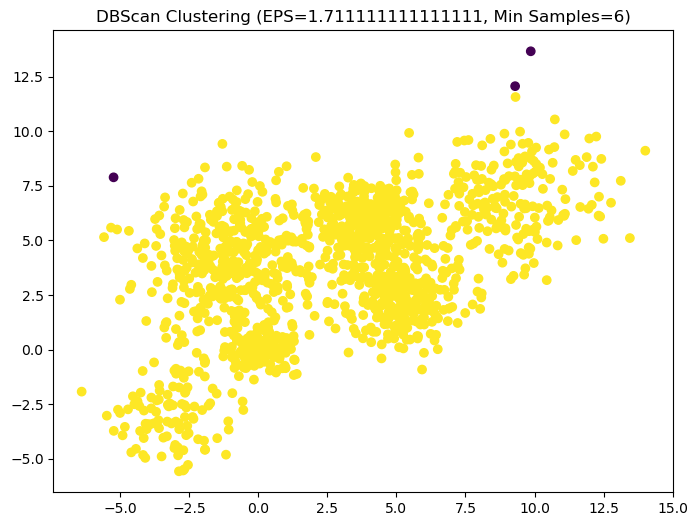

EPS: 1.711111111111111, Min Samples: 6, Silhouette Score: 0.43762353642223145


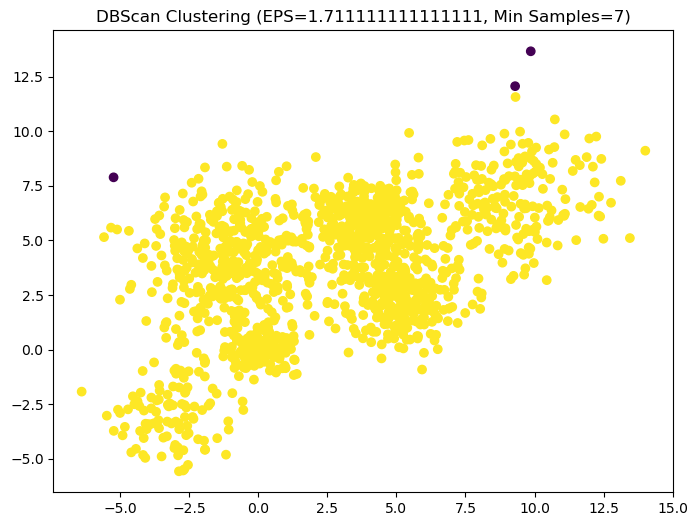

EPS: 1.711111111111111, Min Samples: 7, Silhouette Score: 0.43762353642223145


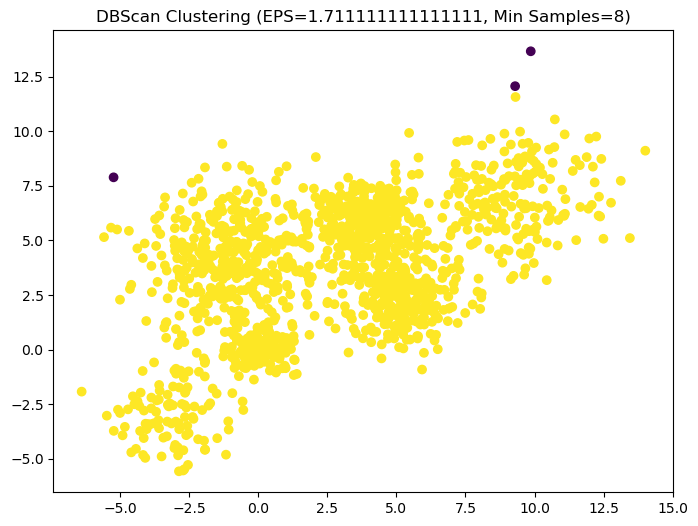

EPS: 1.711111111111111, Min Samples: 8, Silhouette Score: 0.43762353642223145


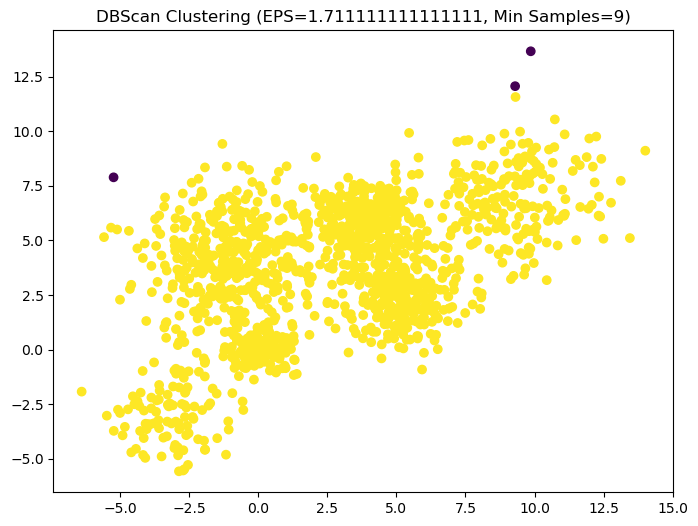

EPS: 1.711111111111111, Min Samples: 9, Silhouette Score: 0.43762353642223145


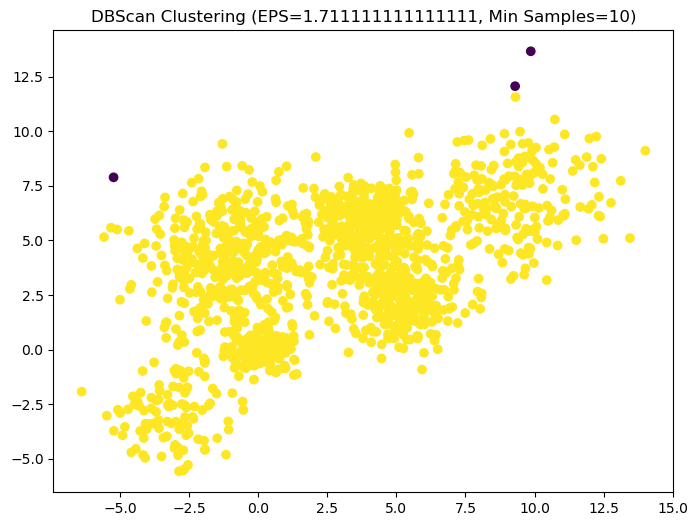

EPS: 1.711111111111111, Min Samples: 10, Silhouette Score: 0.43762353642223145


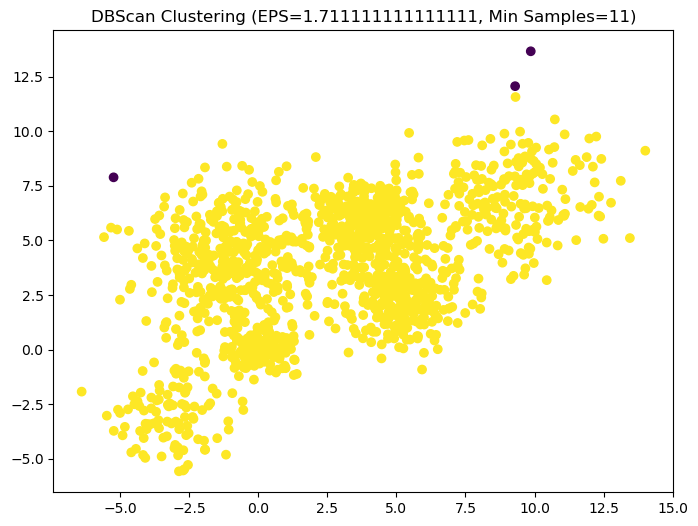

EPS: 1.711111111111111, Min Samples: 11, Silhouette Score: 0.43762353642223145


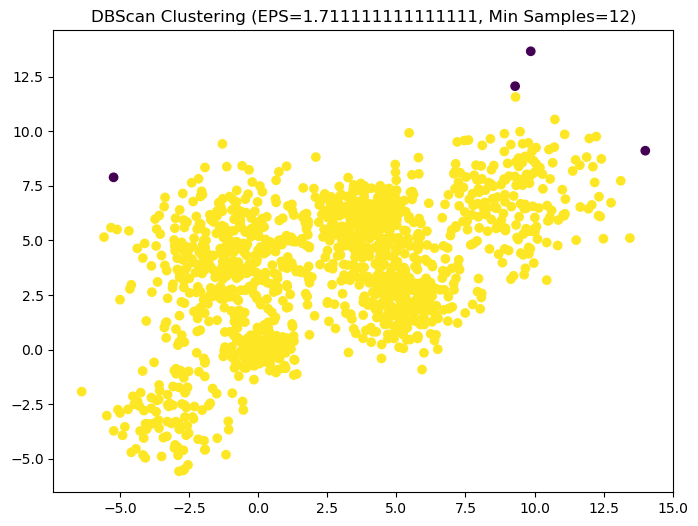

EPS: 1.711111111111111, Min Samples: 12, Silhouette Score: 0.44948549198650606


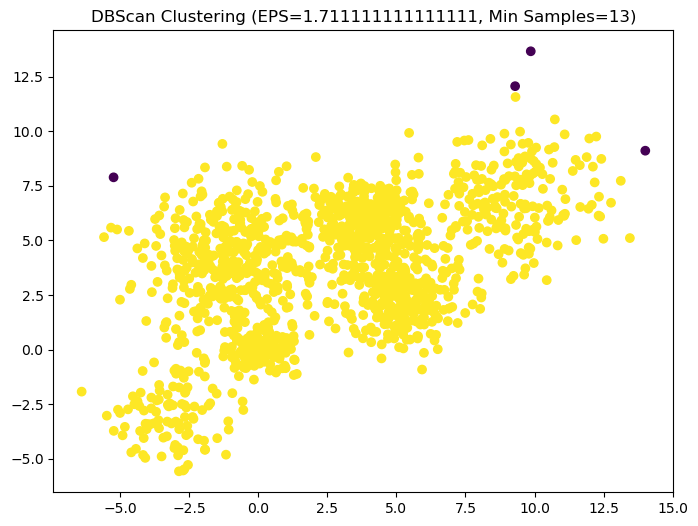

EPS: 1.711111111111111, Min Samples: 13, Silhouette Score: 0.44948549198650606


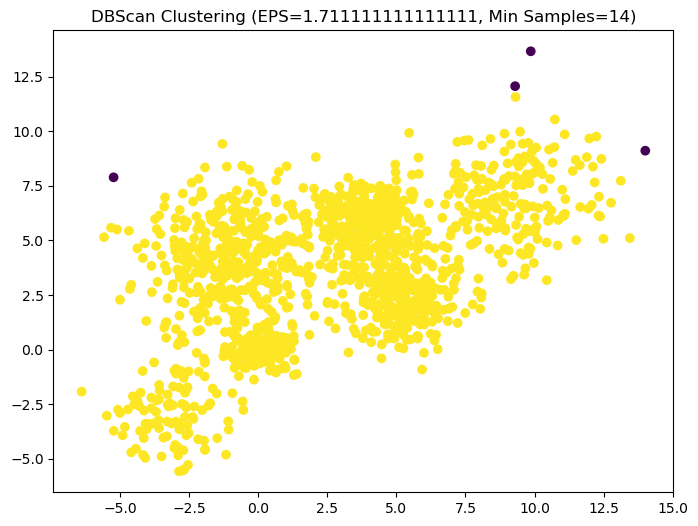

EPS: 1.711111111111111, Min Samples: 14, Silhouette Score: 0.44948549198650606


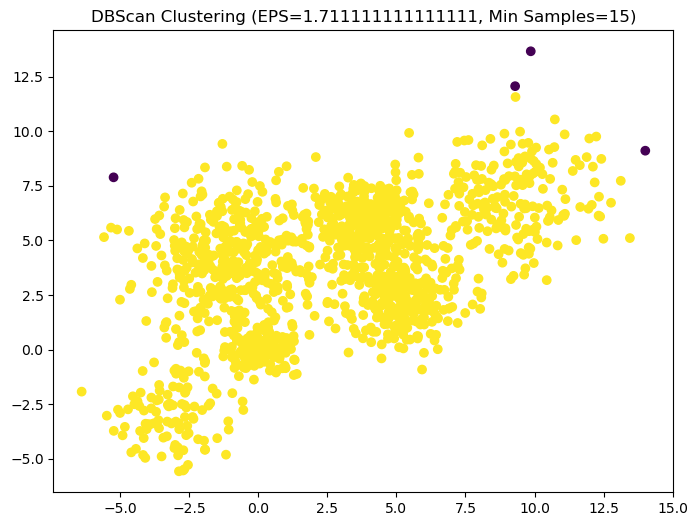

EPS: 1.711111111111111, Min Samples: 15, Silhouette Score: 0.44948549198650606


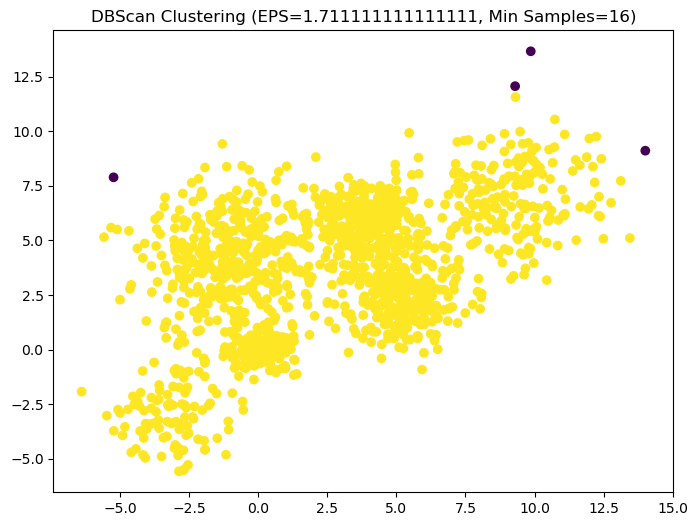

EPS: 1.711111111111111, Min Samples: 16, Silhouette Score: 0.44948549198650606


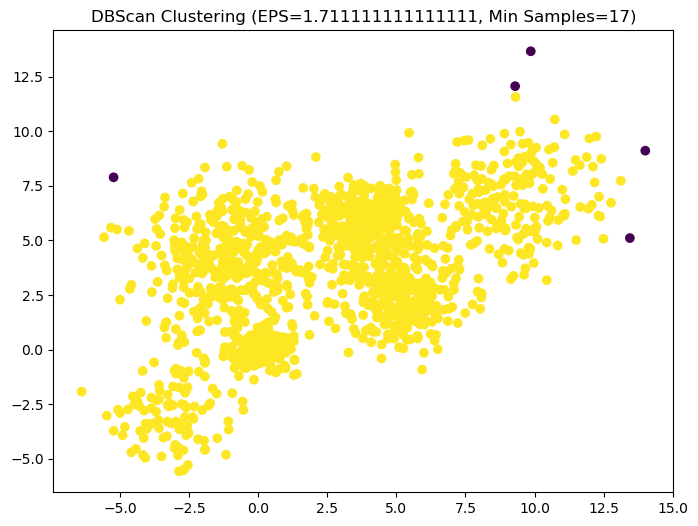

EPS: 1.711111111111111, Min Samples: 17, Silhouette Score: 0.44178265685805723


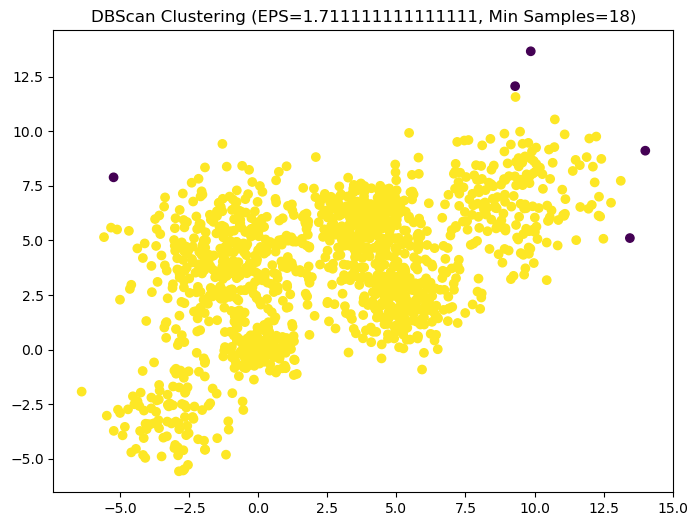

EPS: 1.711111111111111, Min Samples: 18, Silhouette Score: 0.44178265685805723


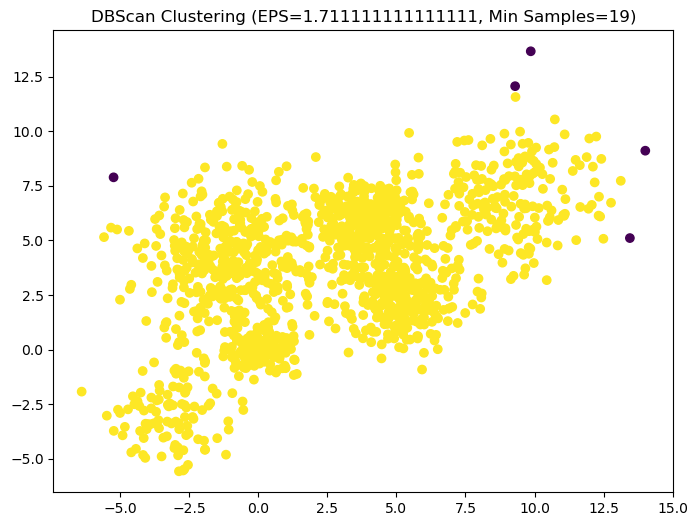

EPS: 1.711111111111111, Min Samples: 19, Silhouette Score: 0.44178265685805723


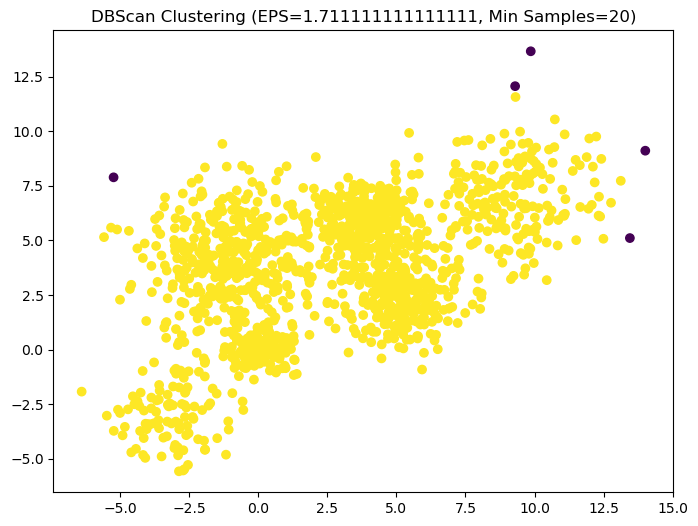

EPS: 1.711111111111111, Min Samples: 20, Silhouette Score: 0.44178265685805723


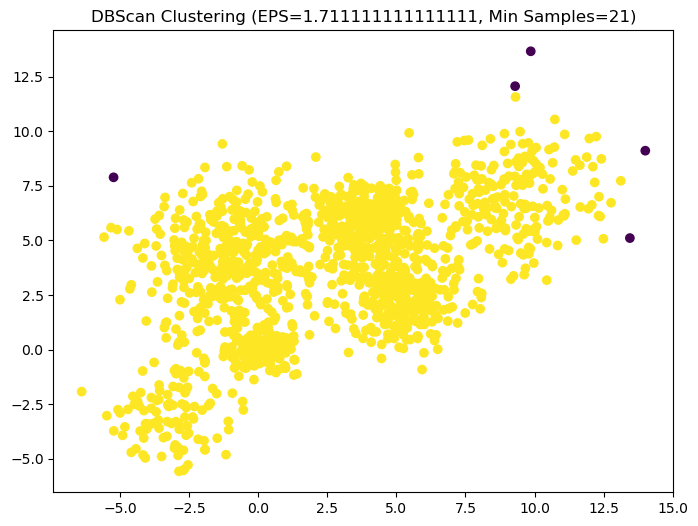

EPS: 1.711111111111111, Min Samples: 21, Silhouette Score: 0.44178265685805723


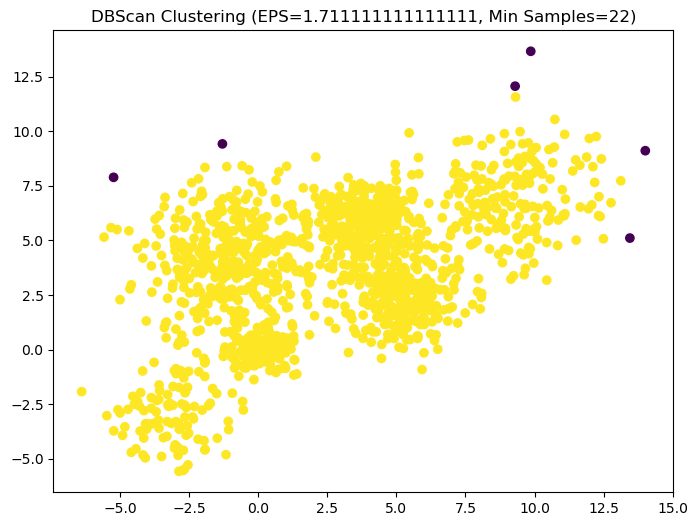

EPS: 1.711111111111111, Min Samples: 22, Silhouette Score: 0.42312679919184554


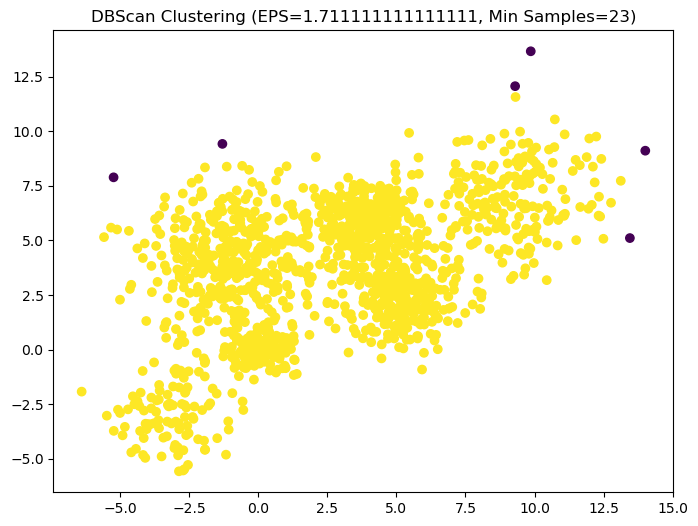

EPS: 1.711111111111111, Min Samples: 23, Silhouette Score: 0.42312679919184554


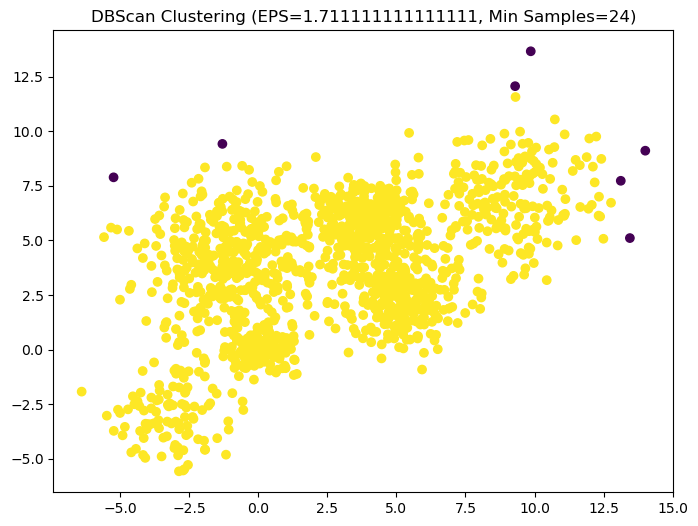

EPS: 1.711111111111111, Min Samples: 24, Silhouette Score: 0.42236641055848967


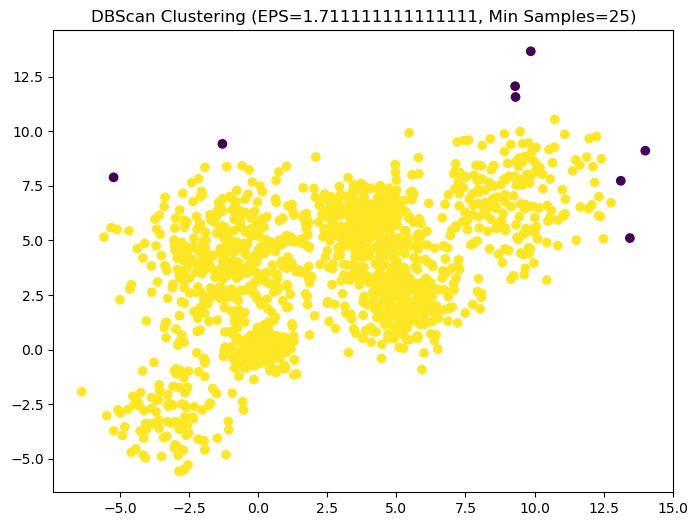

EPS: 1.711111111111111, Min Samples: 25, Silhouette Score: 0.4174440063866295


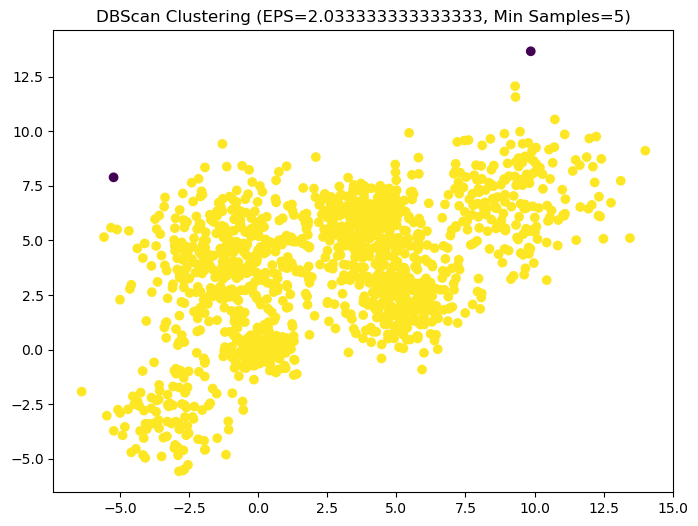

EPS: 2.033333333333333, Min Samples: 5, Silhouette Score: 0.4479741534934026


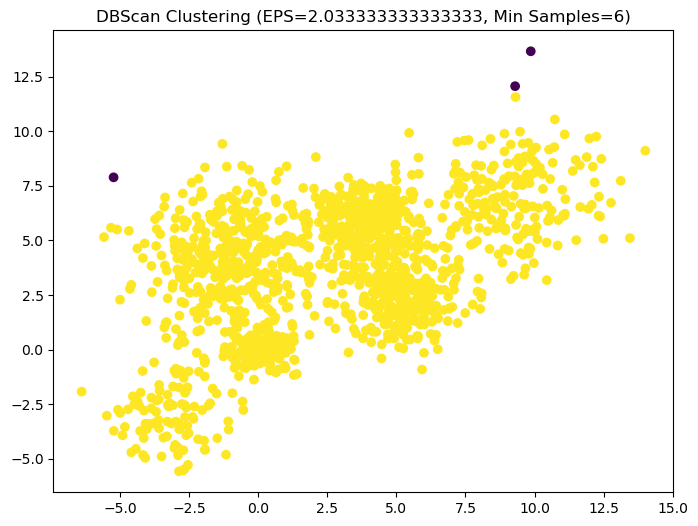

EPS: 2.033333333333333, Min Samples: 6, Silhouette Score: 0.43762353642223145


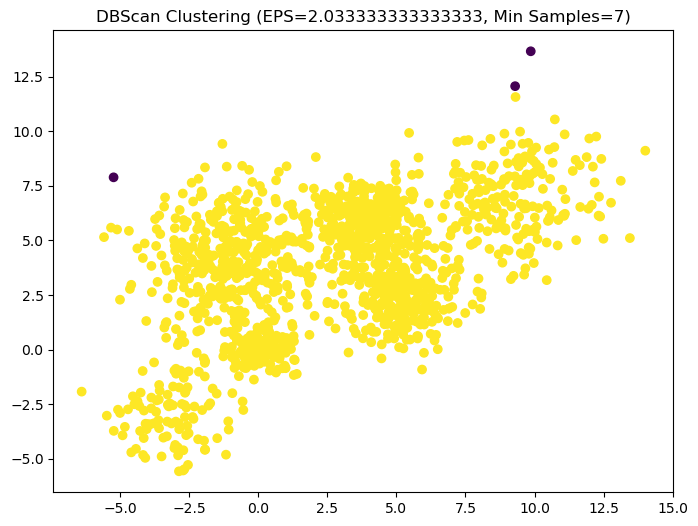

EPS: 2.033333333333333, Min Samples: 7, Silhouette Score: 0.43762353642223145


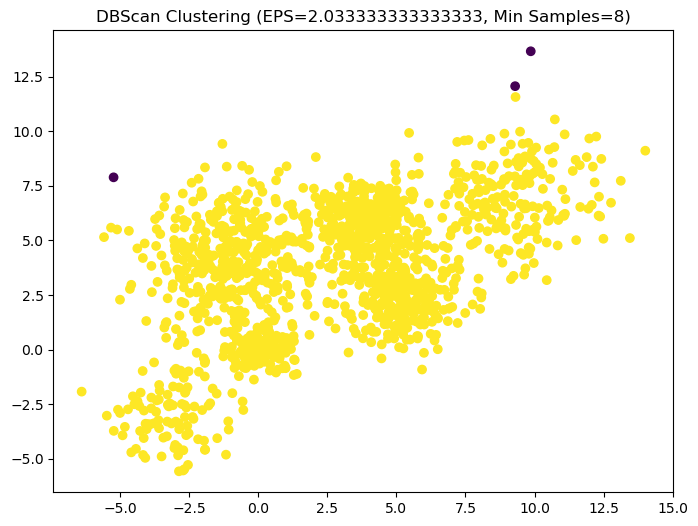

EPS: 2.033333333333333, Min Samples: 8, Silhouette Score: 0.43762353642223145


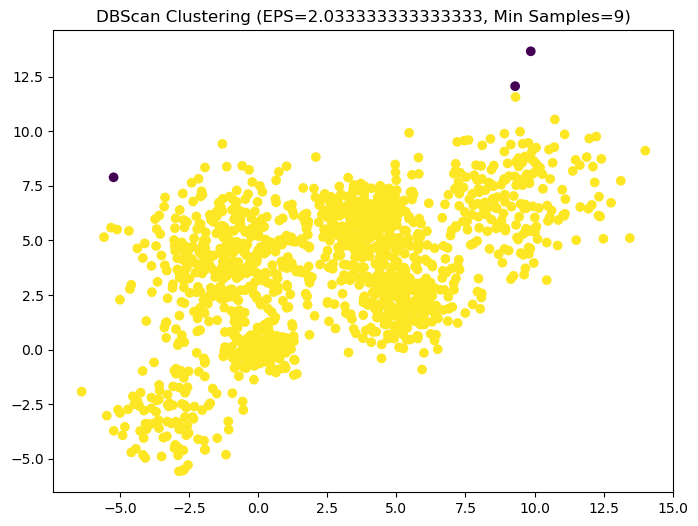

EPS: 2.033333333333333, Min Samples: 9, Silhouette Score: 0.43762353642223145


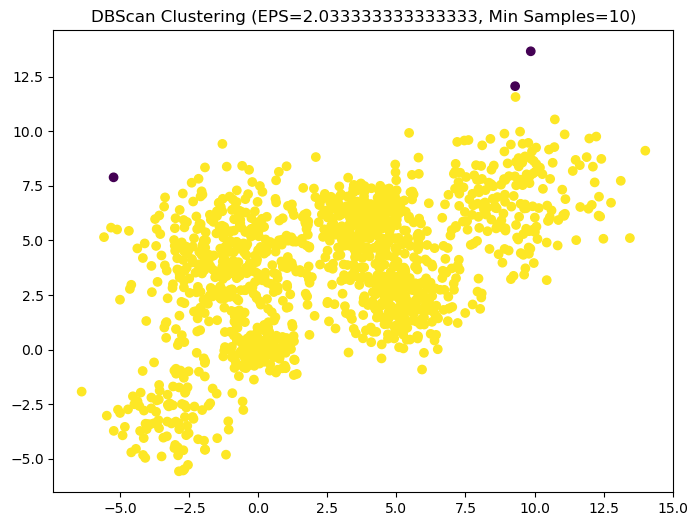

EPS: 2.033333333333333, Min Samples: 10, Silhouette Score: 0.43762353642223145


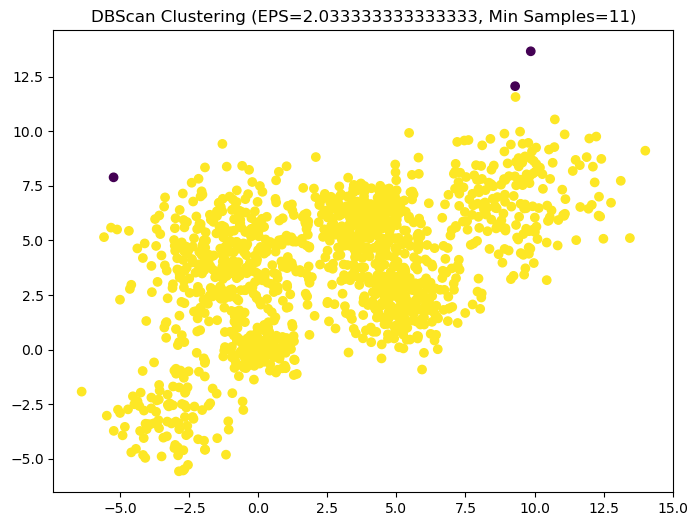

EPS: 2.033333333333333, Min Samples: 11, Silhouette Score: 0.43762353642223145


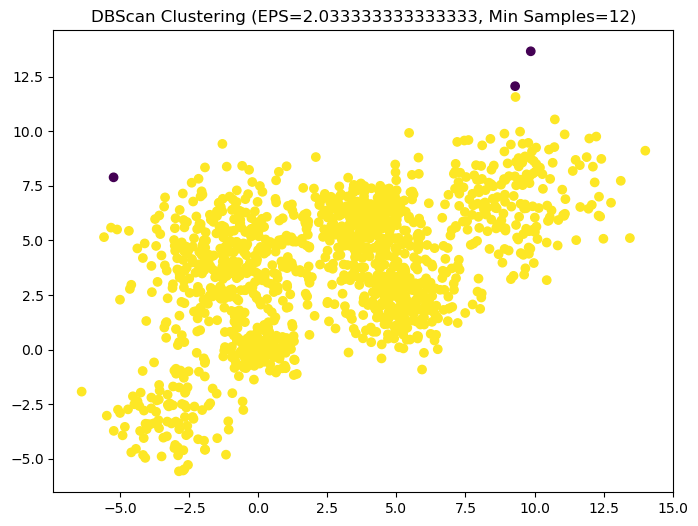

EPS: 2.033333333333333, Min Samples: 12, Silhouette Score: 0.43762353642223145


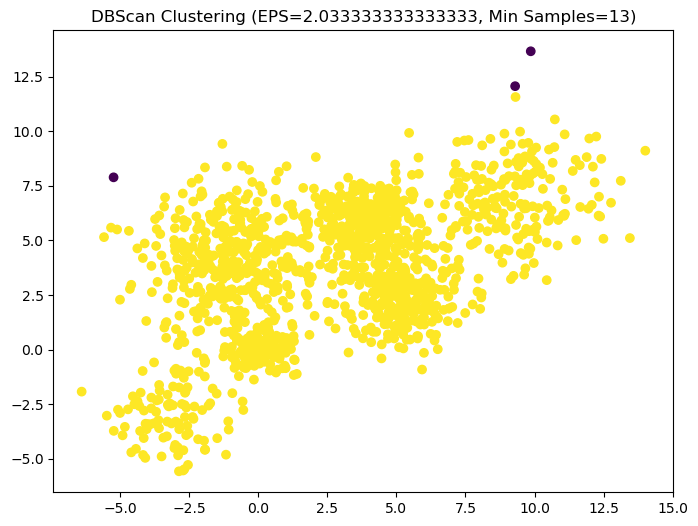

EPS: 2.033333333333333, Min Samples: 13, Silhouette Score: 0.43762353642223145


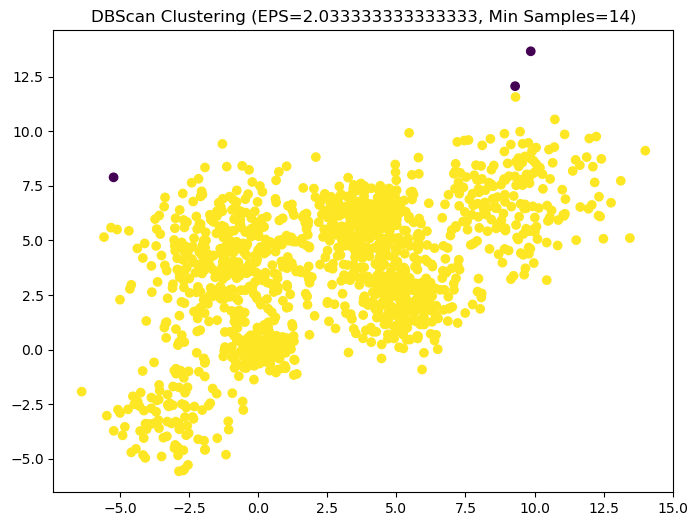

EPS: 2.033333333333333, Min Samples: 14, Silhouette Score: 0.43762353642223145


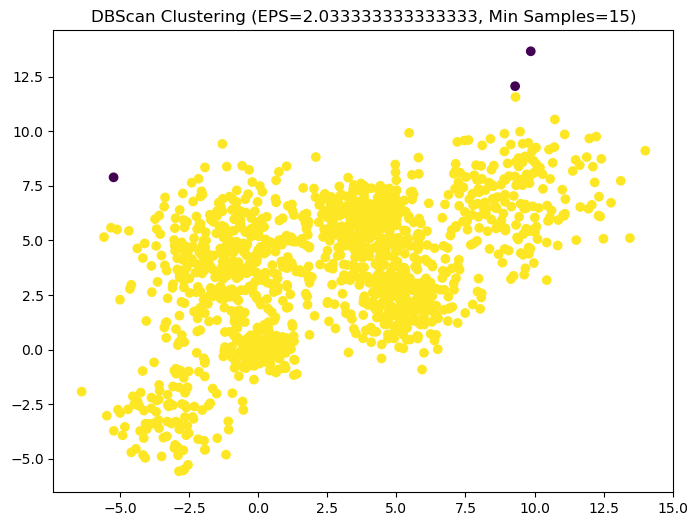

EPS: 2.033333333333333, Min Samples: 15, Silhouette Score: 0.43762353642223145


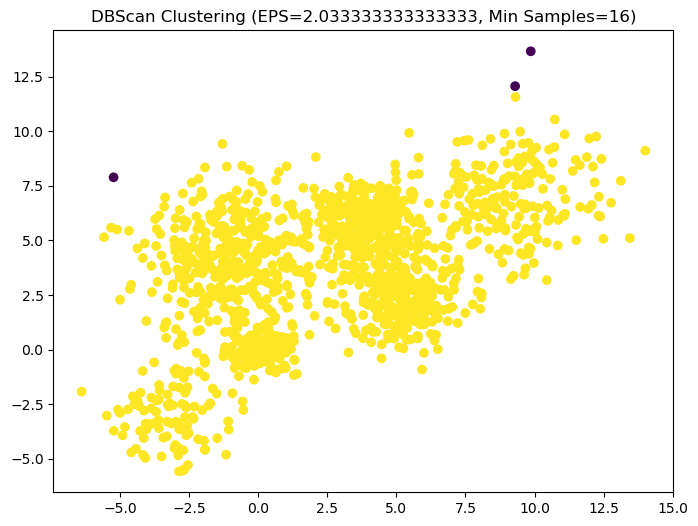

EPS: 2.033333333333333, Min Samples: 16, Silhouette Score: 0.43762353642223145


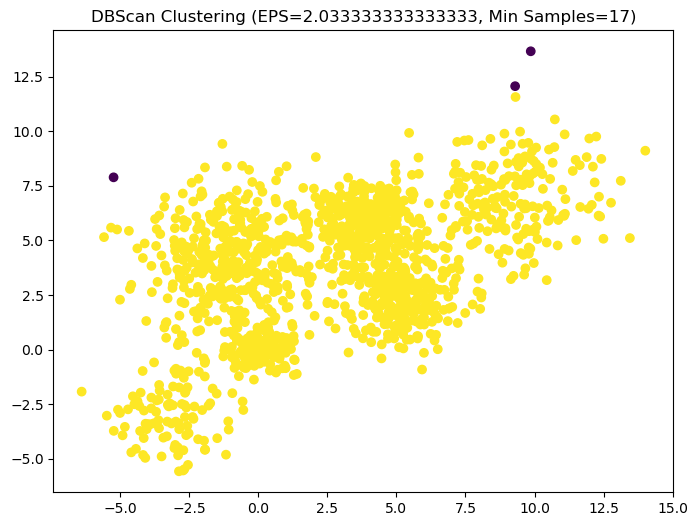

EPS: 2.033333333333333, Min Samples: 17, Silhouette Score: 0.43762353642223145


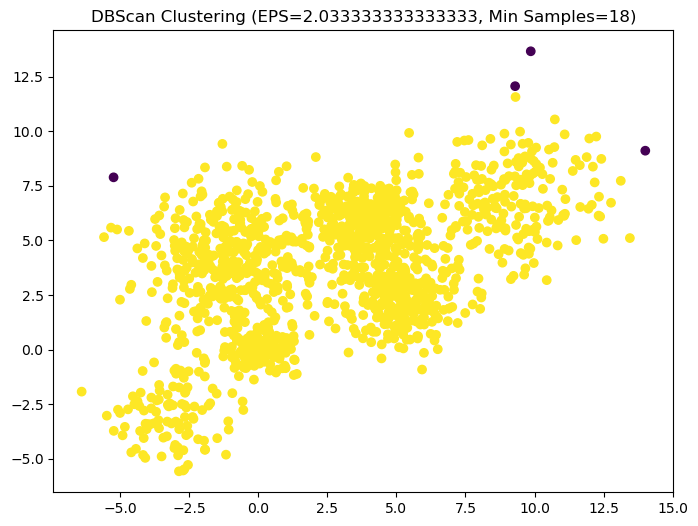

EPS: 2.033333333333333, Min Samples: 18, Silhouette Score: 0.44948549198650606


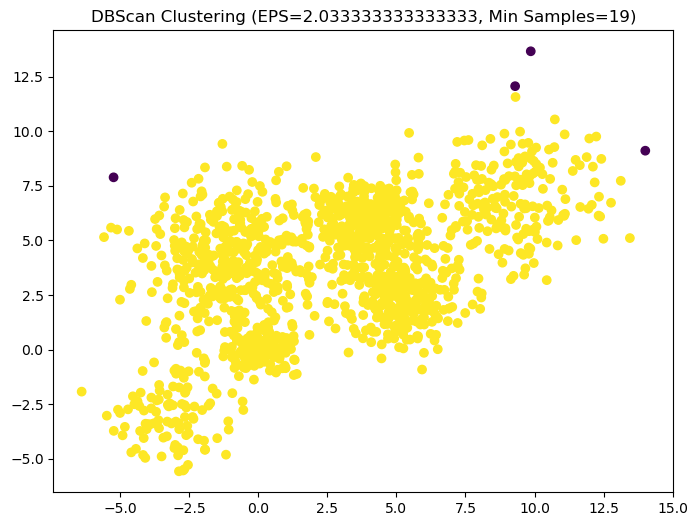

EPS: 2.033333333333333, Min Samples: 19, Silhouette Score: 0.44948549198650606


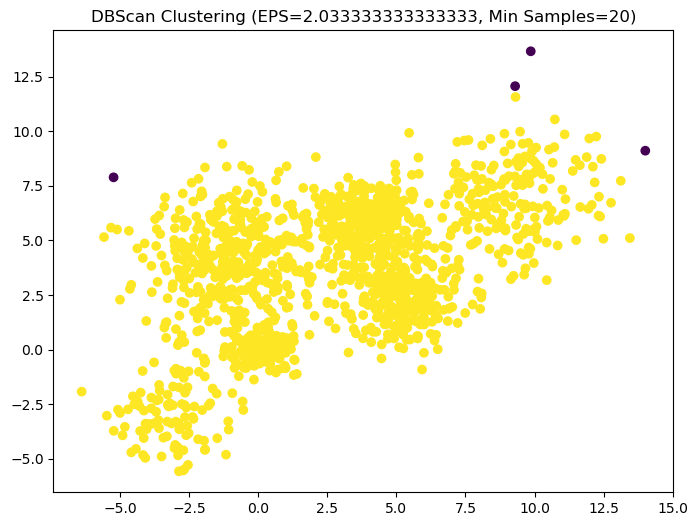

EPS: 2.033333333333333, Min Samples: 20, Silhouette Score: 0.44948549198650606


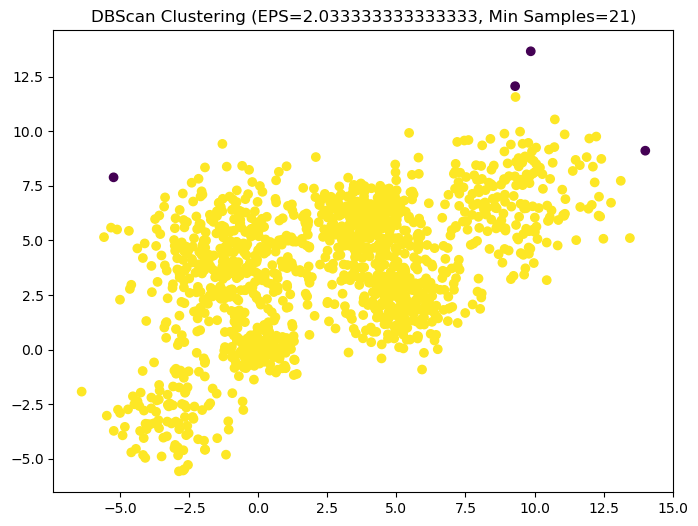

EPS: 2.033333333333333, Min Samples: 21, Silhouette Score: 0.44948549198650606


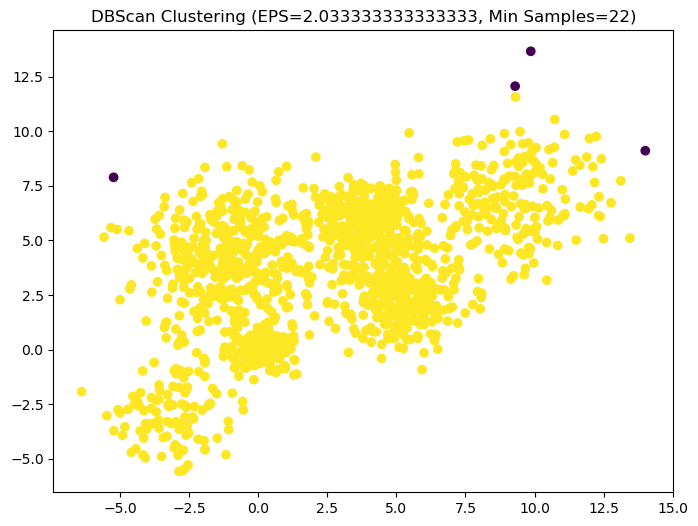

EPS: 2.033333333333333, Min Samples: 22, Silhouette Score: 0.44948549198650606


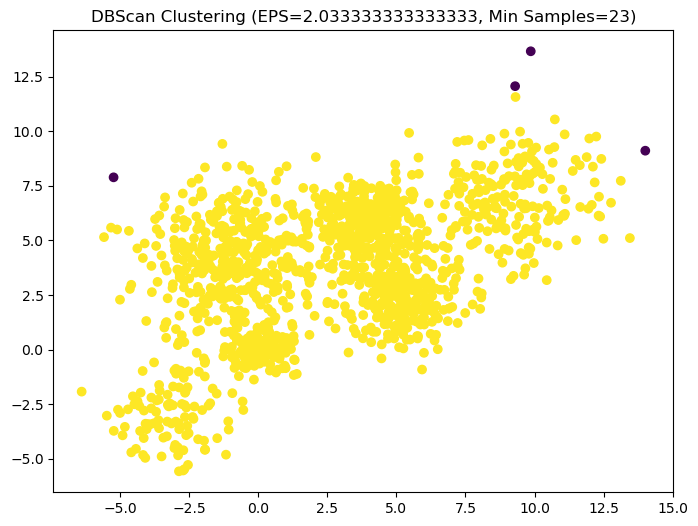

EPS: 2.033333333333333, Min Samples: 23, Silhouette Score: 0.44948549198650606


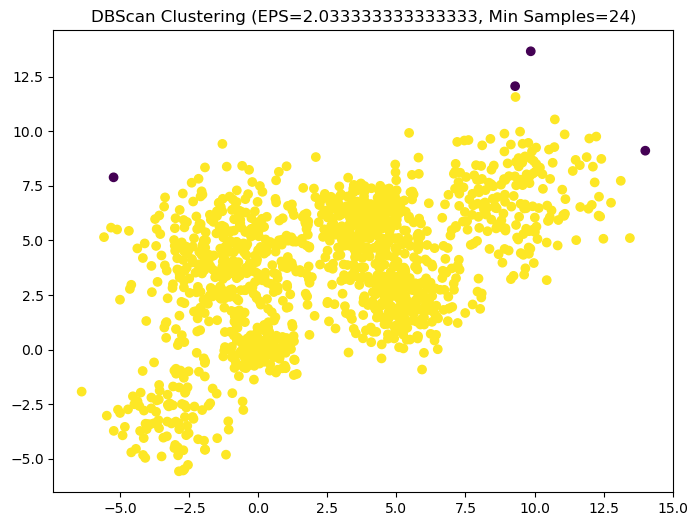

EPS: 2.033333333333333, Min Samples: 24, Silhouette Score: 0.44948549198650606


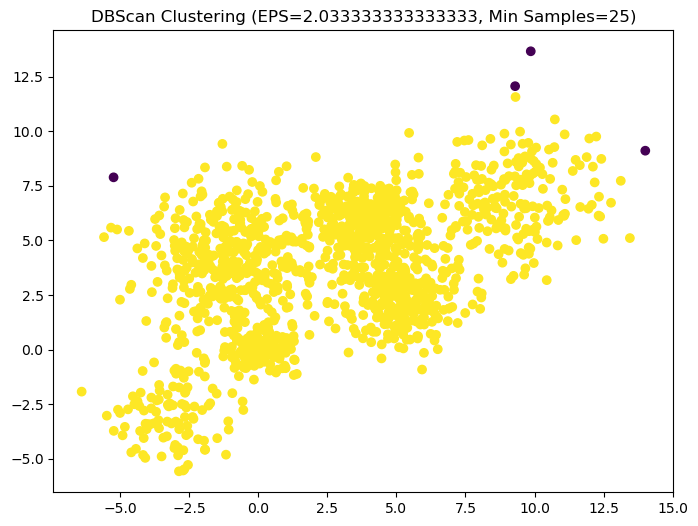

EPS: 2.033333333333333, Min Samples: 25, Silhouette Score: 0.44948549198650606


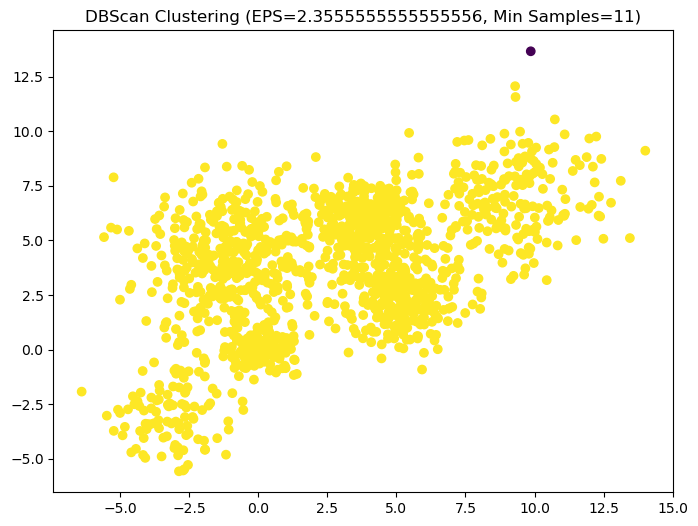

EPS: 2.3555555555555556, Min Samples: 11, Silhouette Score: 0.4685207355522043


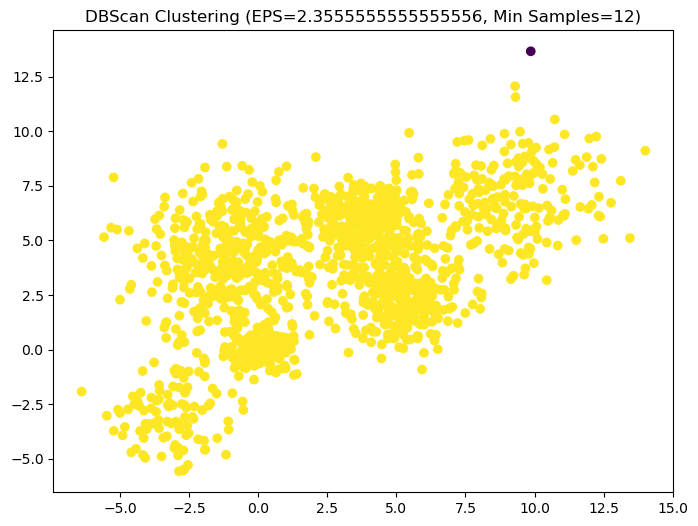

EPS: 2.3555555555555556, Min Samples: 12, Silhouette Score: 0.4685207355522043


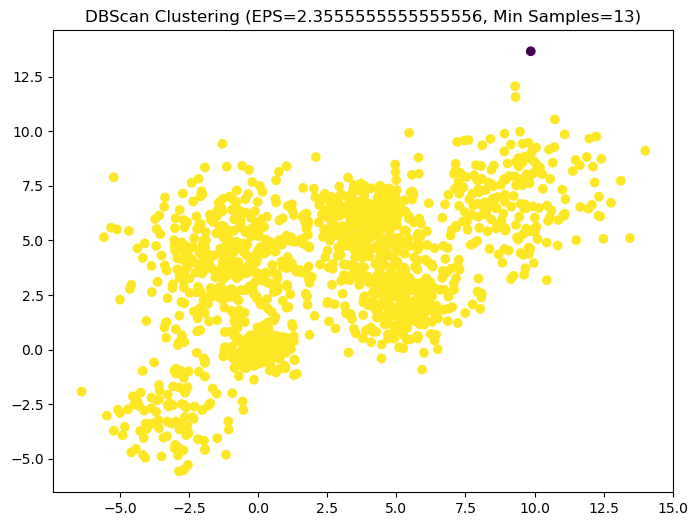

EPS: 2.3555555555555556, Min Samples: 13, Silhouette Score: 0.4685207355522043


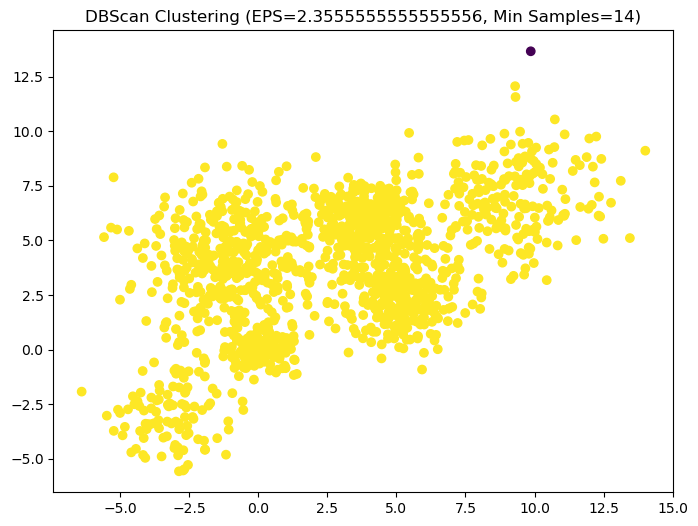

EPS: 2.3555555555555556, Min Samples: 14, Silhouette Score: 0.4685207355522043


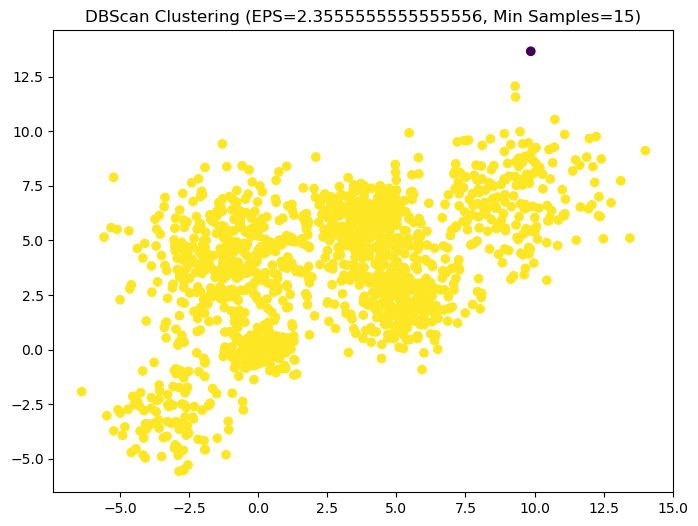

EPS: 2.3555555555555556, Min Samples: 15, Silhouette Score: 0.4685207355522043


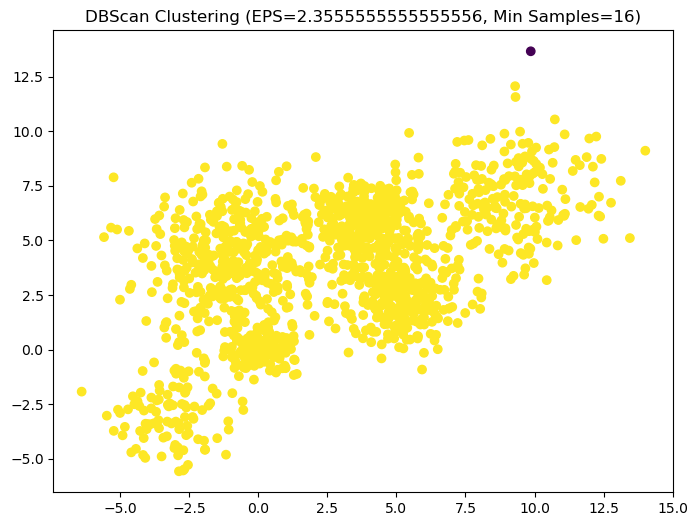

EPS: 2.3555555555555556, Min Samples: 16, Silhouette Score: 0.4685207355522043


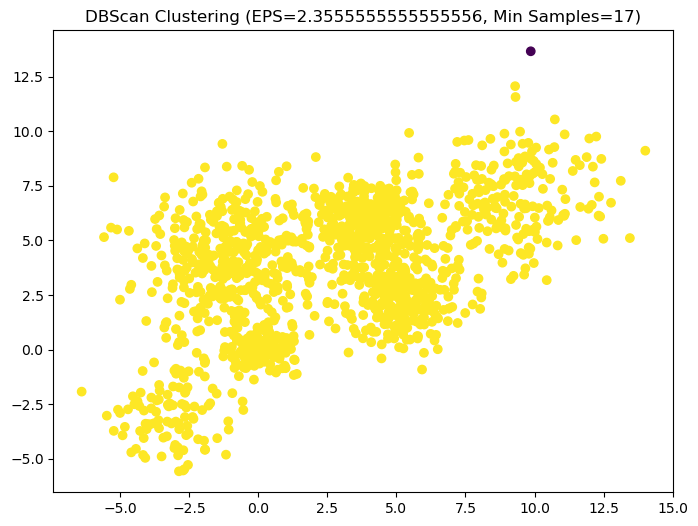

EPS: 2.3555555555555556, Min Samples: 17, Silhouette Score: 0.4685207355522043


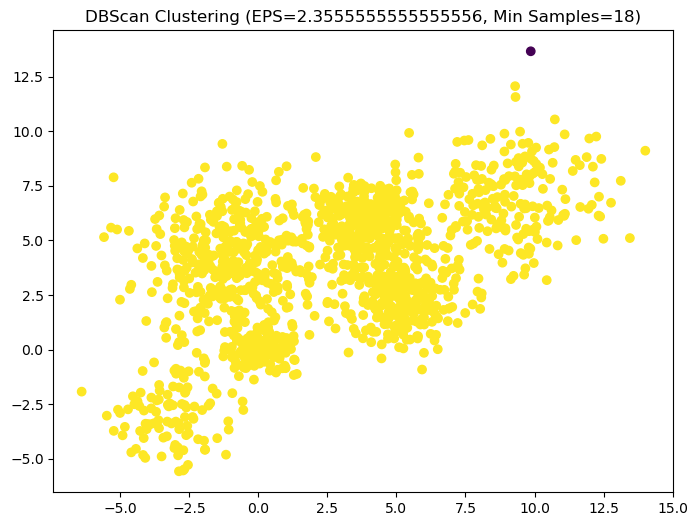

EPS: 2.3555555555555556, Min Samples: 18, Silhouette Score: 0.4685207355522043


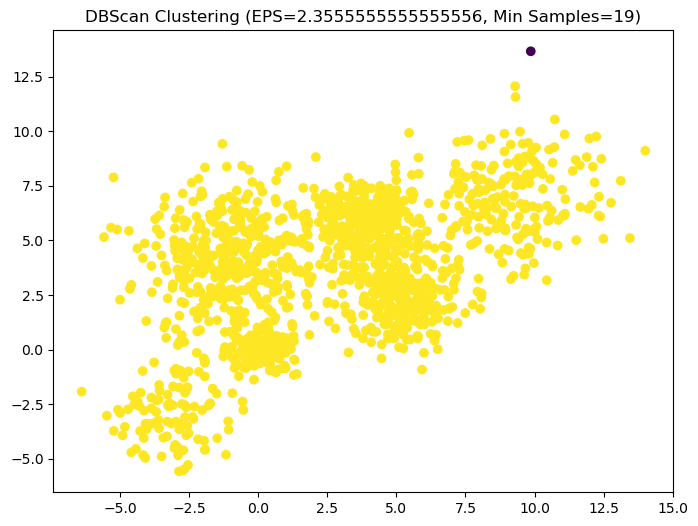

EPS: 2.3555555555555556, Min Samples: 19, Silhouette Score: 0.4685207355522043


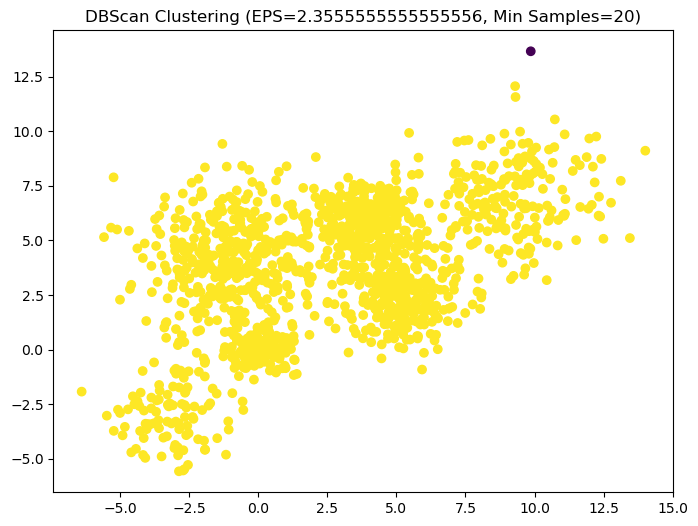

EPS: 2.3555555555555556, Min Samples: 20, Silhouette Score: 0.4685207355522043


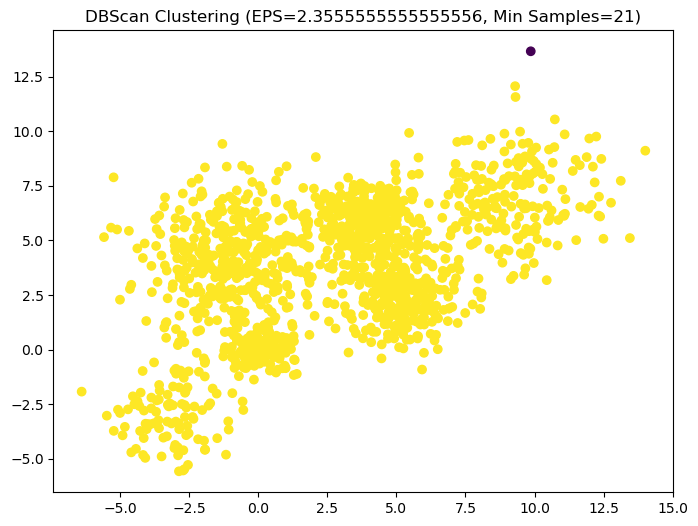

EPS: 2.3555555555555556, Min Samples: 21, Silhouette Score: 0.4685207355522043


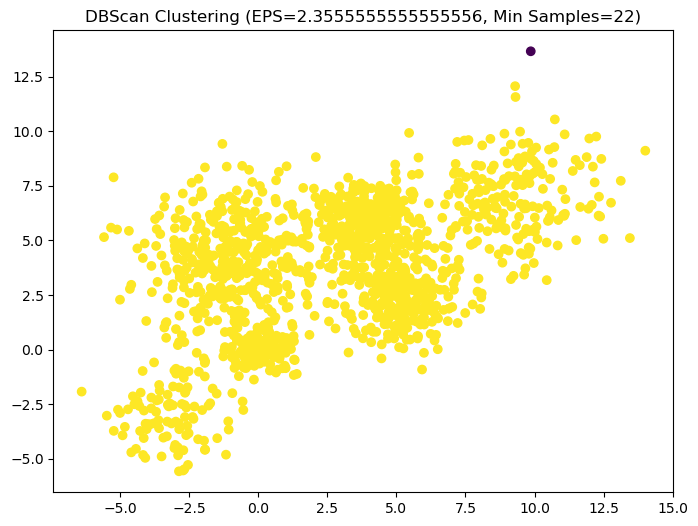

EPS: 2.3555555555555556, Min Samples: 22, Silhouette Score: 0.4685207355522043


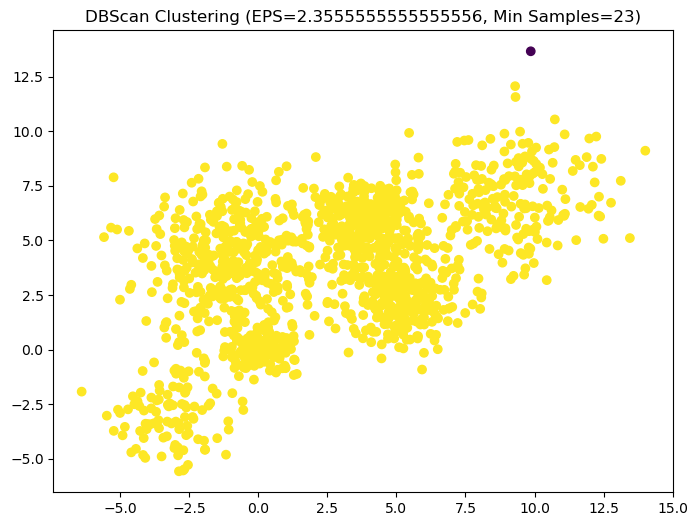

EPS: 2.3555555555555556, Min Samples: 23, Silhouette Score: 0.4685207355522043


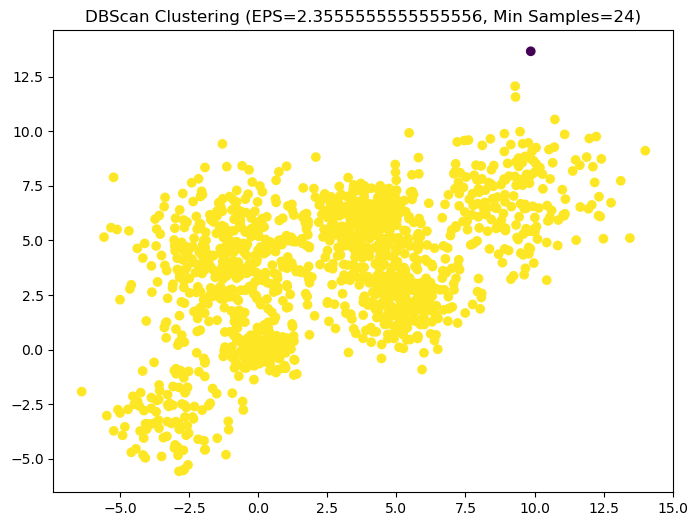

EPS: 2.3555555555555556, Min Samples: 24, Silhouette Score: 0.4685207355522043


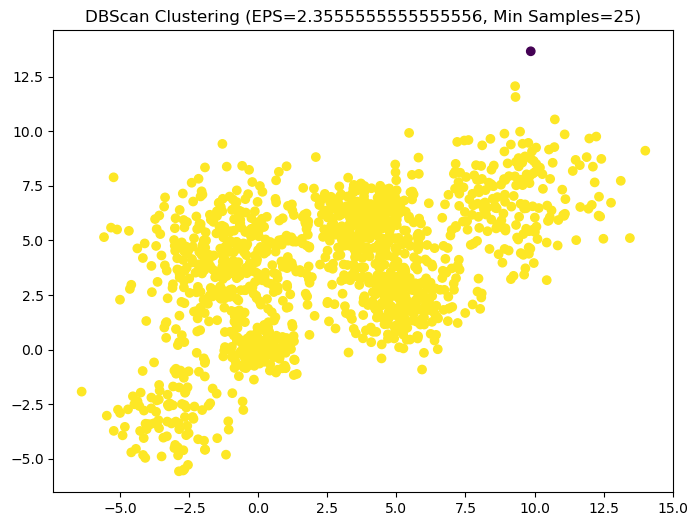

EPS: 2.3555555555555556, Min Samples: 25, Silhouette Score: 0.4685207355522043


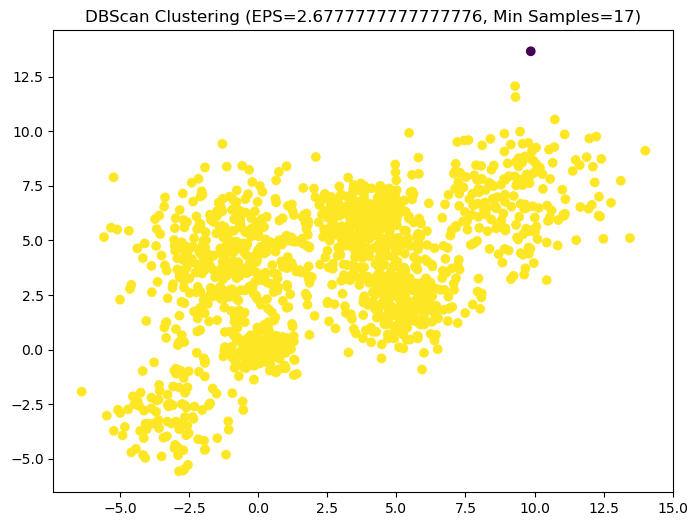

EPS: 2.6777777777777776, Min Samples: 17, Silhouette Score: 0.4685207355522043


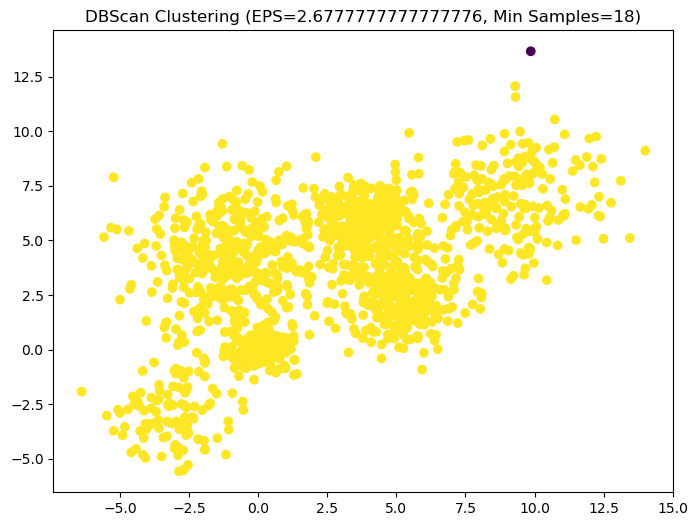

EPS: 2.6777777777777776, Min Samples: 18, Silhouette Score: 0.4685207355522043


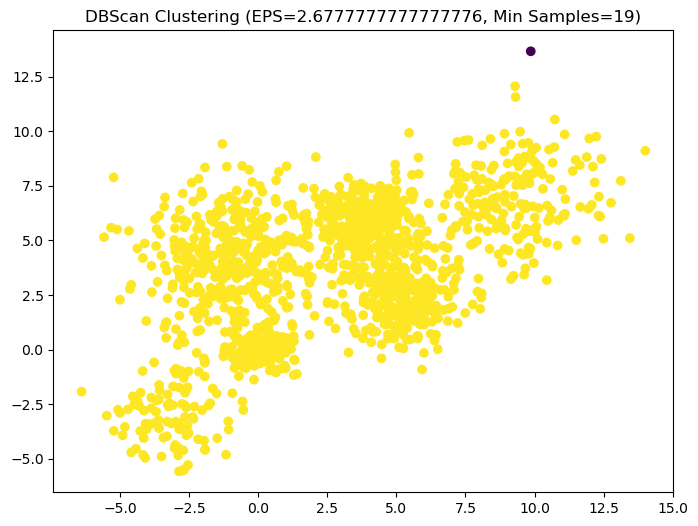

EPS: 2.6777777777777776, Min Samples: 19, Silhouette Score: 0.4685207355522043


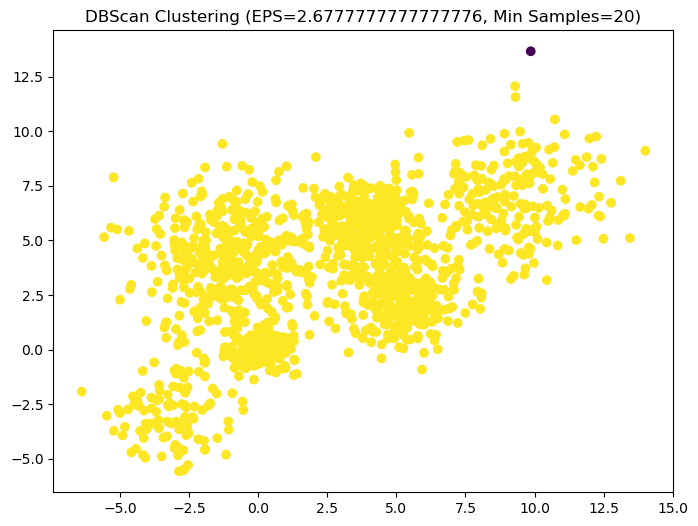

EPS: 2.6777777777777776, Min Samples: 20, Silhouette Score: 0.4685207355522043


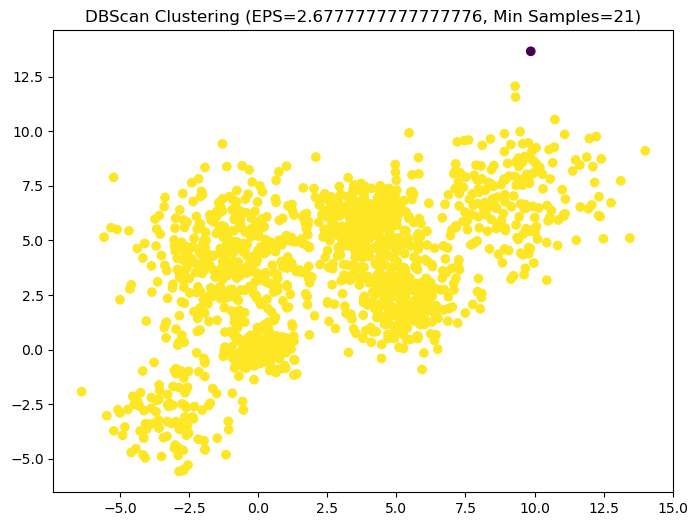

EPS: 2.6777777777777776, Min Samples: 21, Silhouette Score: 0.4685207355522043


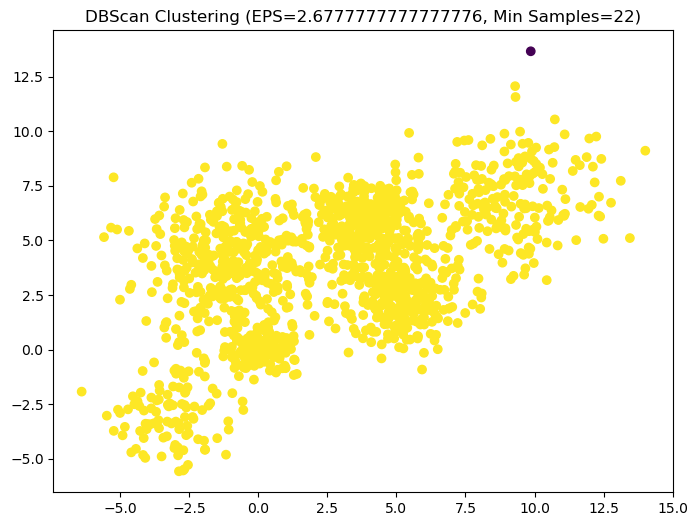

EPS: 2.6777777777777776, Min Samples: 22, Silhouette Score: 0.4685207355522043


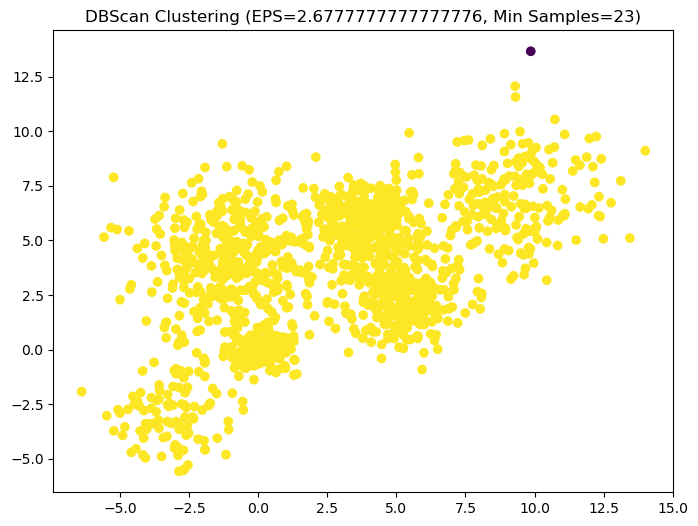

EPS: 2.6777777777777776, Min Samples: 23, Silhouette Score: 0.4685207355522043


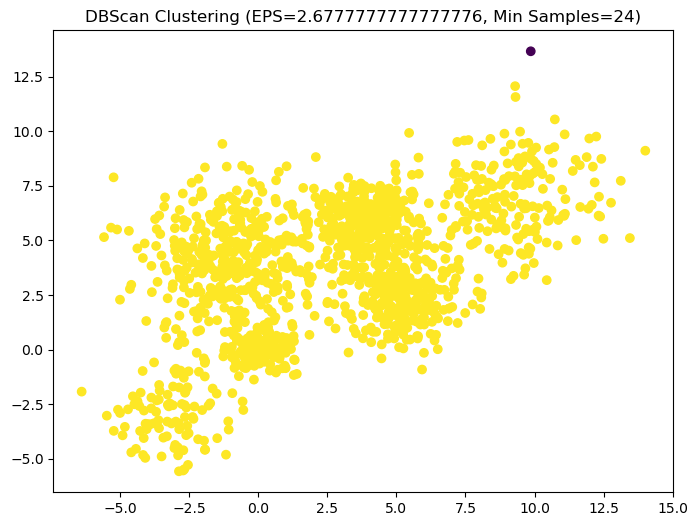

EPS: 2.6777777777777776, Min Samples: 24, Silhouette Score: 0.4685207355522043


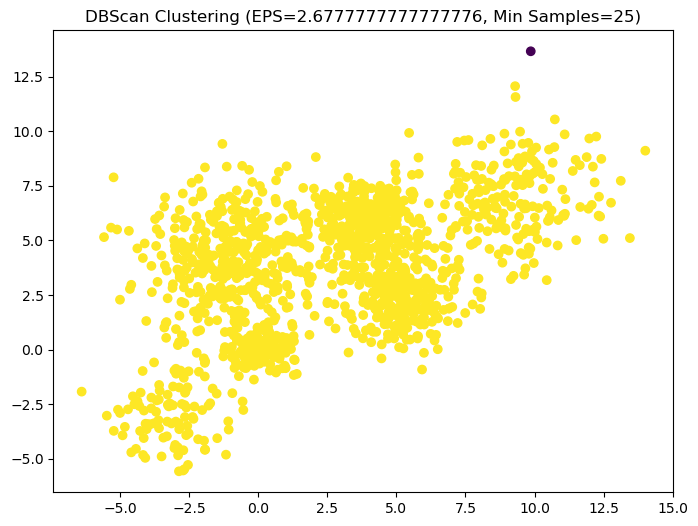

EPS: 2.6777777777777776, Min Samples: 25, Silhouette Score: 0.4685207355522043


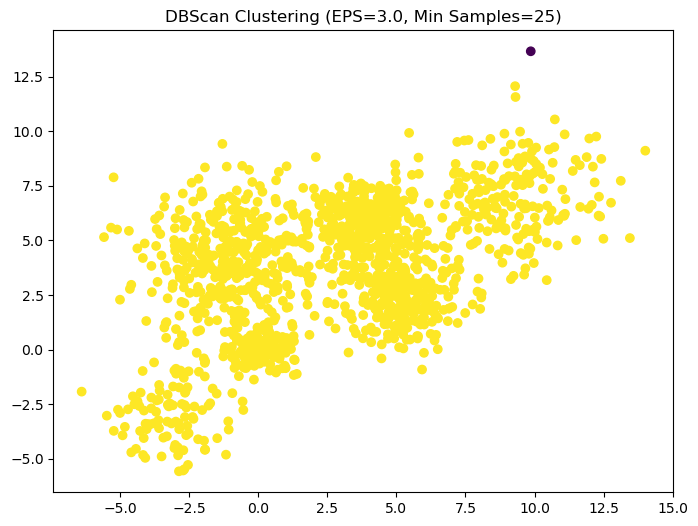

EPS: 3.0, Min Samples: 25, Silhouette Score: 0.4685207355522043
Best parameters: EPS=2.3555555555555556, Min Samples=11, Silhouette Score=0.4685207355522043
Best Parameters: {'eps': 2.3555555555555556, 'min_samples': 11}
Best Silhouette Score: 0.4685207355522043


In [54]:
# Function to perform DBScan clustering
def perform_dbscan_clustering(data, eps_values, min_samples_values):
    best_silhouette_score = -1
    best_params = None

    for eps in eps_values:
        for min_samples in min_samples_values:
            dbscan = DBSCAN(eps=eps, min_samples=min_samples)
            labels = dbscan.fit_predict(data)
            
            # Check if there are at least two unique labels
            unique_labels = np.unique(labels)
            if len(unique_labels) < 2:
                continue
            
            silhouette_score_value = silhouette_score(data, labels)

            # Visualize resulting clusters
            plt.figure(figsize=(8, 6))
            plt.scatter(data[:, 0], data[:, 1], c=labels, cmap='viridis')
            plt.title(f'DBScan Clustering (EPS={eps}, Min Samples={min_samples})')
            plt.show()

            print(f"EPS: {eps}, Min Samples: {min_samples}, Silhouette Score: {silhouette_score_value}")

            # Store best silhouette score and parameters
            if silhouette_score_value > best_silhouette_score:
                best_silhouette_score = silhouette_score_value
                best_params = {'eps': eps, 'min_samples': min_samples}

    print(f'Best parameters: EPS={best_params["eps"]}, Min Samples={best_params["min_samples"]}, Silhouette Score={best_silhouette_score}')
    return best_params, best_silhouette_score

 
eps_values = np.linspace(0.1, 3, 10)
min_samples_values = range(5, 26)

# Perform DBScan clustering
best_params, best_silhouette_score = perform_dbscan_clustering(Multi_blob_Data, eps_values, min_samples_values)

print("Best Parameters:", best_params)
print("Best Silhouette Score:", best_silhouette_score)



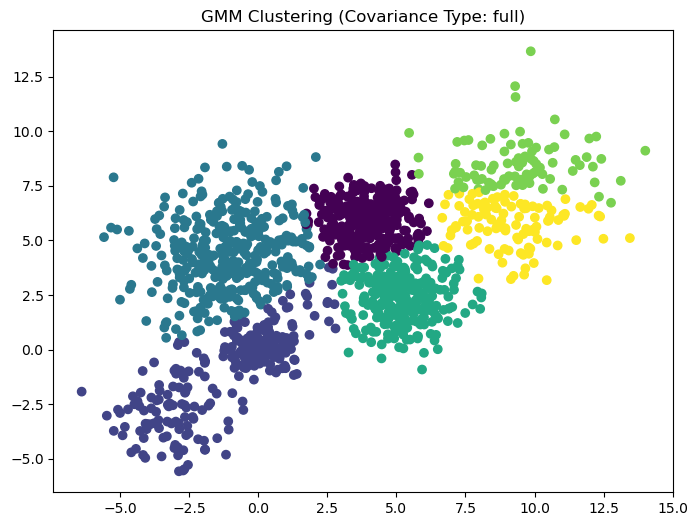

Covariance Type: full, BIC: 14294.362569297024


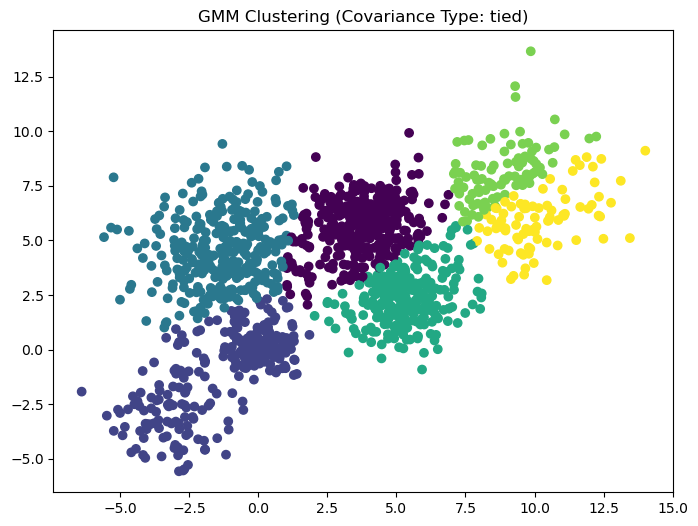

Covariance Type: tied, BIC: 14490.676259152964


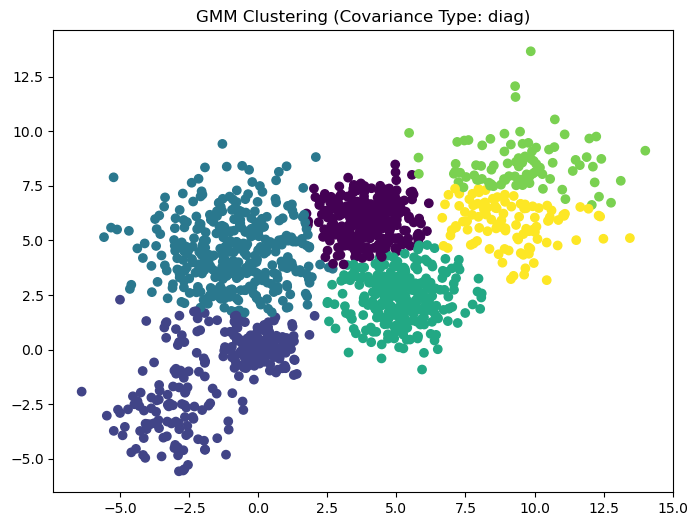

Covariance Type: diag, BIC: 14413.323158546089


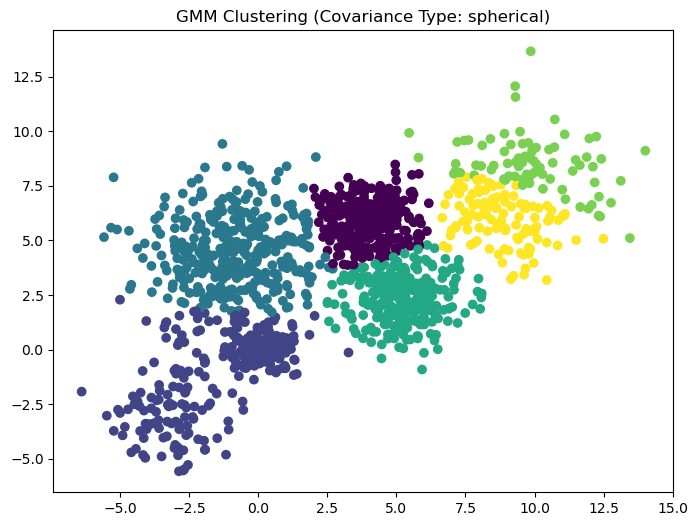

Covariance Type: spherical, BIC: 14376.454355099806
Best parameters: Covariance Type=full, BIC=14294.362569297024
Best Parameters: {'covariance_type': 'full'}
Best BIC: 14294.362569297024


In [55]:
from sklearn.mixture import GaussianMixture

# Function to perform GMM clustering
def perform_gmm_clustering(data, covariance_types):
    best_bic = np.inf
    best_params = None

    for covariance_type in covariance_types:
        gmm = GaussianMixture(n_components=6, covariance_type=covariance_type, random_state=42)
        gmm.fit(data)
        bic = gmm.bic(data)

        # Visualize resulting clusters
        plt.figure(figsize=(8, 6))
        plt.scatter(data[:, 0], data[:, 1], c=gmm.predict(data), cmap='viridis')
        plt.title(f'GMM Clustering (Covariance Type: {covariance_type})')
        plt.show()

        print(f"Covariance Type: {covariance_type}, BIC: {bic}")

        # Store best BIC and parameters
        if bic < best_bic:
            best_bic = bic
            best_params = {'covariance_type': covariance_type}

    print(f'Best parameters: Covariance Type={best_params["covariance_type"]}, BIC={best_bic}')
    return best_params, best_bic

# Define covariance types 
covariance_types = ['full', 'tied', 'diag', 'spherical']

# Perform GMM clustering
best_params, best_bic = perform_gmm_clustering(Multi_blob_Data, covariance_types)

print("Best Parameters:", best_params)
print("Best BIC:", best_bic)
